In [1]:
import warnings
warnings.filterwarnings('ignore')

# Library Import

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

from stabl.stabl import Stabl, plot_stabl_path, plot_fdr_graph, export_stabl_to_csv, save_stabl_results
from stabl.preprocessing import LowInfoFilter
from stabl.visualization import boxplot_features, scatterplot_features, plot_roc, boxplot_binary_predictions
from stabl.adaptive import ALasso, ALogitLasso
from stabl import data

from sklearn.pipeline import Pipeline
from sklearn.feature_selection import VarianceThreshold
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.base import clone
from sklearn.linear_model import Lasso, LogisticRegression, ElasticNet, LinearRegression

%config InlineBackend.figure_formats=['retina'] 
plt.rcParams['svg.fonttype'] = 'none'

/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/stabl/stabl.py:18: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


### Read MannWhitney P-value results

In [3]:
mannwhitneyresults = pd.read_csv(r'AnnDataFiles/4-output_nsclc_ytma_mannwhitneyresults.csv', engine='c')
mannwhitneyresults

,Unnamed: 0,metric,Mann_Whitney U,p_value,-log10,adj_p,log2FC
0,108690,GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_Al...,551.0,0.000437,-0.297666,1.0,-3.239983
1,99601,GCross_k2CNsxImmunefuncxTumourfunc_NoNeighs_Al...,551.5,0.000646,-0.313529,1.0,-2.034170
2,100132,GCross_k2CNsxImmunemetaxTumourmeta_NoNeighs_Al...,234.0,0.000707,-0.317413,1.0,5.015486
3,2594,GCross_k2CNsxImmunefuncxImmunefunc_NoNeighs_Al...,544.0,0.000950,-0.330898,1.0,-2.236603
4,258366,GCross_k3CNsxImmunemetaxTumourmeta_NoNeighs_Al...,520.0,0.000984,-0.332539,1.0,-8.065450
...,...,...,...,...,...,...,...
2132949,447,GCross_k2CNsxCellsxCells_NoNeighs_AllCells_1_m...,368.0,1.000000,inf,1.0,0.087713
2132950,304,GCross_k2CNsxCellsxCells_NoNeighs_AllCells_1_o...,368.0,1.000000,inf,1.0,0.026045
2132951,2132916,nratiob:cd4tcells:Minimal_Metabolic_Activity_f...,368.5,1.000000,inf,1.0,0.149332
2132952,277,GCross_k2CNsxCellsxCells_NoNeighs_AllCells_1_e...,368.0,1.000000,inf,1.0,0.038717


In [4]:
print("Length of non-NaN pvalue array is: ", len(mannwhitneyresults[~np.isnan(mannwhitneyresults.p_value)]))
print("Length of pvalue < 0.1 array is: ", len(mannwhitneyresults[~np.isnan(mannwhitneyresults.p_value) & (mannwhitneyresults.p_value < 0.1)]['metric']))

Length of non-NaN pvalue array is:  2132954
Length of pvalue < 0.1 array is:  34685


### Read Computed Metrics

In [5]:
data = np.genfromtxt(r'AnnDataFiles/4-output_nsclc_ytma_modelingfeatures.csv', delimiter=',', skip_header=1)

In [6]:
data.shape

(55, 2132968)

In [7]:
import csv
# Read the header line to get column names
with open(r'AnnDataFiles/4-output_nsclc_ytma_modelingfeatures.csv', 'r') as f:
    reader = csv.reader(f)
    header = next(reader)  # first row

# Determine if the CSV has an index column
# (For instance, if the first header cell is blank or 'Unnamed: 0', it's likely an index)
if header[0] == '' or header[0].lower().startswith('unnamed'):
    # Remove the first element which is for the index
    columns = header[1:]
else:
    columns = header

# Read the index values (assuming they are in the first column)
index = []
with open(r'AnnDataFiles/4-output_nsclc_ytma_modelingfeatures.csv', 'r') as f:
    reader = csv.reader(f)
    next(reader)  # skip header
    for row in reader:
        index.append(row[0])

In [8]:
data = data[:, 1:]
X_raw = pd.DataFrame(data, columns=columns, index=index)

In [9]:
X_raw = X_raw[(~np.isnan(X_raw['CB6']))]
X_raw.index = X_raw['patientid'].astype(int).values

In [12]:
X_raw[['GCross_k2CNsxCellsxCells_NoNeighs_AllCells_0_cd4tregcells_cd4tregcells', 'patientid', 'CB6', 'BOR']]

,GCross_k2CNsxCellsxCells_NoNeighs_AllCells_0_cd4tregcells_cd4tregcells,patientid,CB6,BOR
22193,142.439030,22193.0,0.0,NaN
22333,98.181816,22333.0,0.0,NaN
24490,134.705890,24490.0,1.0,NaN
28757,0.000000,28757.0,1.0,NaN
29937,150.000000,29937.0,0.0,NaN
31267,0.000000,31267.0,0.0,NaN
31565,140.000000,31565.0,1.0,NaN
31584,117.500000,31584.0,0.0,NaN
31590,73.333336,31590.0,0.0,NaN
32054,119.545456,32054.0,0.0,NaN


In [14]:
# List of Patient IDs that are taken Pre-IO
prepatids = [3892, 22193, 22333, 24481, 24490, 27405, 28757, 29937, 31267, 31565, 31579, 31584, 31590, 32054, 32340, 32343, 32345, 32350, 32356, 32362, 32364, 32370, 32372, 32749, 32761, 34668, 34670, 34672, 34673, 34678, 34680, 34681, 34686, 34687, 34688, 34689, 34692, 34693, 34694, 34695, 34697, 34698, 34699, 34700, 34703, 34704, 34706, 34711, 34713, 34714, 34715, 34718, 34721, 34722, 34726, 34733, 34737, 34738, 34742, 34743, 34746, 34747, 34749, 34750, 34752, 34753, 34758, 34759, 34765, 34767]
lungPrimaryids = [3892, 22193, 22333, 24490, 28757, 29937, 31257, 31267, 31565, 31584, 31590, 32054, 32340, 32343, 32350, 32372, 32749, 32761, 34668, 34670, 34672, 34673, 34678, 34680, 34686, 34687, 34688, 34689, 34692, 34693, 34694, 34695, 34697, 34698, 34699, 34700, 34703, 34704, 34706,34711, 34713, 34715, 34718, 34721, 34722, 34726, 34733, 34737, 34738, 34743, 34746, 34749, 34758, 34759, 34765, 34767]

In [15]:
X_raw.shape

(55, 2132967)

In [79]:
X = X_raw.copy()
X.columns = X.columns.astype(str)
X = X.loc[X.patientid.isin(prepatids) & X.patientid.isin(lungPrimaryids),:]

y_PFS = X[['pfs.T', 'pfs.E']].copy()#.reset_index(drop=True)
y_OS  = X[['os.T', 'os.E']].copy()#  .reset_index(drop=True)

y_CB6  = X['CB6'].copy()#.reset_index(drop=True).copy()
y_OR   = X['OR'].copy() #.reset_index(drop=True).copy()


In [80]:
X[[ 'BOR', 'PORvsFPD', 'pfs.T', 'pfs.E', 'os.T', 'os.E', 'pfs.6months', 'pfs.12months', 'OS.18months', 'OS.24months', 'patientid', 'CB6', 'OR']]

,BOR,PORvsFPD,pfs.T,pfs.E,os.T,os.E,pfs.6months,pfs.12months,OS.18months,OS.24months,patientid,CB6,OR
22193,NaN,0.0,2.333333,1.0,11.600000,1.0,1.0,0.0,1.0,0.0,22193.0,0.0,0.0
22333,NaN,0.0,1.766667,1.0,21.333334,1.0,1.0,0.0,0.0,0.0,22333.0,0.0,0.0
24490,NaN,1.0,13.033334,1.0,37.900000,1.0,0.0,1.0,0.0,1.0,24490.0,1.0,1.0
28757,NaN,1.0,7.600000,1.0,27.766666,0.0,0.0,0.0,0.0,1.0,28757.0,1.0,0.0
29937,NaN,0.0,2.733333,1.0,3.866667,1.0,1.0,0.0,1.0,0.0,29937.0,0.0,0.0
31267,NaN,0.0,1.300000,1.0,1.900000,1.0,1.0,0.0,1.0,0.0,31267.0,0.0,0.0
31565,NaN,1.0,7.333334,1.0,28.466667,0.0,0.0,0.0,0.0,1.0,31565.0,1.0,0.0
31584,NaN,0.0,1.600000,1.0,15.666667,1.0,1.0,0.0,1.0,0.0,31584.0,0.0,0.0
31590,NaN,0.0,0.666667,1.0,1.400000,1.0,1.0,0.0,1.0,0.0,31590.0,0.0,0.0
32054,NaN,0.0,1.400000,1.0,1.700000,1.0,1.0,0.0,1.0,0.0,32054.0,0.0,0.0


In [ ]:
# Remove unnecessary features, imput 0's/1's
X = X.drop([ 'BOR', 'PORvsFPD', 'pfs.T', 'pfs.E', 'os.T', 'os.E', 'pfs.6months', 'pfs.12months', 'OS.18months', 'OS.24months', 'patientid', 'CB6', 'OR'], axis=1)
X = X.drop(X.columns[X.columns.str.contains('0_0')], axis=1)
X = X.drop(X.columns[X.columns.str.contains('1_1')], axis=1)
X = X.drop(X.columns[X.columns.str.contains('2_2')], axis=1)
X = X.drop(X.columns[X.columns.str.contains('_patientid')], axis=1)
X = X.drop(X.columns[X.columns.str.contains('artifact')], axis=1)
X = X.drop(X.columns[X.columns.str.contains('other')], axis=1)

X.loc[:, X.columns.str.contains('JSD')] = X.loc[:, X.columns.str.contains('JSD')].fillna(1.0)
X.loc[:, ~X.columns.str.contains('smi')] = X.loc[:, ~X.columns.str.contains('smi')].fillna(0.0)

In [ ]:
drop_columns = []
#drop_threshold = 0.75 #define the percentage criterion for drop

#JSD of similar cell types in the same CN are irrelevant
jsd_cols = X.columns[X.columns.str.contains('JSD')]
for col in jsd_cols:
    for cn in range(5):
        if len(col.split('_'+str(cn)+'_')) > 1:
            colsplit = col.split('_'+str(cn)+'_')[1]
            if colsplit[:len(colsplit)//2] == colsplit[len(colsplit)//2+1:]:
                drop_columns.append(col)
X = X.drop(columns=drop_columns,axis=1)

# Select at least 25 unique values, sparsity filter
X = X.loc[:, X.nunique() > 25]

In [20]:
#X.to_csv(r'AnnDataFiles/5-output_nsclc_ytma_modelingfeatures_filtered0p8.csv')

### Standard Scaling

In [22]:
X = X.loc[:,~X.columns.duplicated()]

scaler = StandardScaler()
scaler.fit(X)
cols = X.columns
index = X.index
X = pd.DataFrame(scaler.transform(X), columns=cols, index=index)

X_train, X_test, y_train, y_test = train_test_split(X, y_CB6)
X_all, y_all = X.copy(), y_CB6.copy()

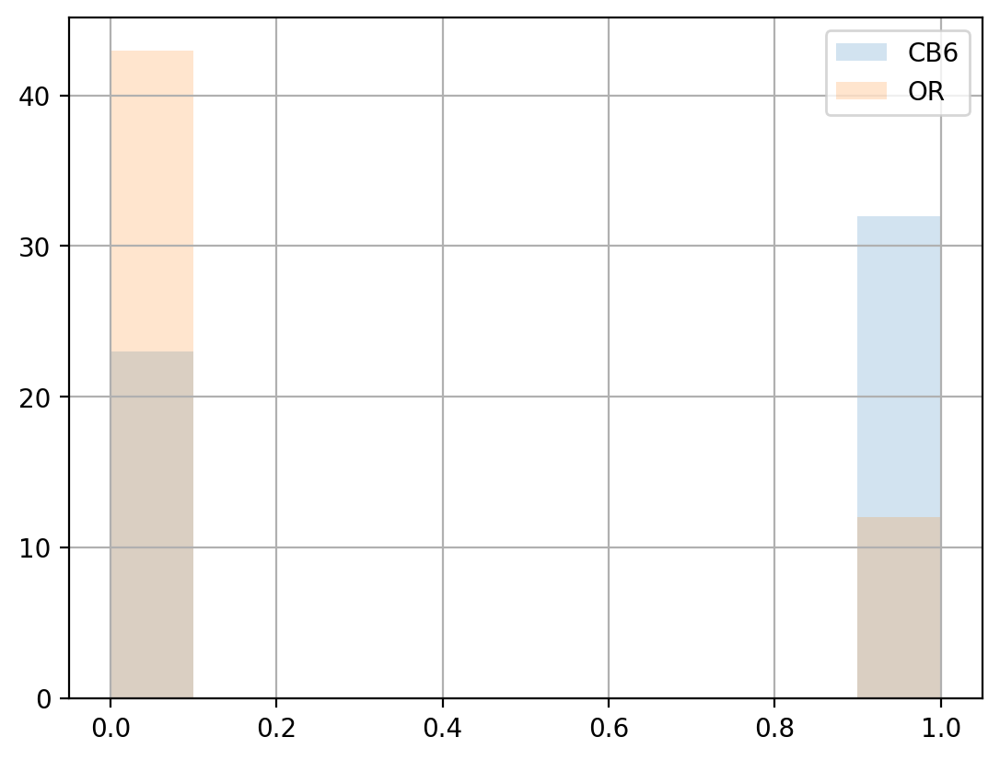

In [23]:
y_all.hist(alpha=0.2, label='CB6')
y_OR.hist(alpha=0.2, label='OR')
plt.legend()
plt.show()

## Set up STABL - Run On All Features

In [40]:
random_state = 42
lasso = Lasso(max_iter=int(1e5), random_state=random_state)

lasso_stabl_class = Stabl(
    base_estimator=clone(lasso),
    lambda_grid="auto",
    n_lambda=10,
    artificial_type="knockoff",
    artificial_proportion=1,
    fdr_threshold_range=np.arange(0.01, 1.0, 0.01),
    n_bootstraps=100,
    random_state=random_state,
    verbose=1,
    n_jobs=22,
)

lasso_preprocessing = Pipeline(
    steps=[
        ("variance_threshold", VarianceThreshold(threshold=0.0)),  # Removing 0 variance features
        ("low_info_filter", LowInfoFilter(max_nan_fraction=0.35)),
        ("imputer", SimpleImputer(strategy="median")),  # Imputing missing values with median
        ("std", StandardScaler())  # Z-scoring features
    ]
)

logistic_final = LinearRegression()

overall_pipe = Pipeline(
    steps=[
        ("preprocessing", lasso_preprocessing),  # We use the preprocessing pipeline previously defined
        ("feature_selection", lasso_stabl_class),  # We use Stabl for feature selection
        ("final_model", logistic_final)  # We use Logistic Regression as final model
    ]
)

In [41]:
overall_pipe.fit(X_all, y_all)

/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


Stabl progress:   0%|          | 0/10 [00:00<?, ?it/s]

/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/stabl/stabl.py:1297: UserWarning: No features were selected: either the data is too noisy or the selection test too strict.
  warn("No features were selected: either the data is"


ValueError: Found array with 0 feature(s) (shape=(55, 0)) while a minimum of 1 is required by LinearRegression.

-> No features selected

### Plot the Results

In [ ]:
# Plot the path of the STABL selection over the regularization
plot_stabl_path(overall_pipe[1])

In [ ]:
# Plot the False Discovery Rate
plot_fdr_graph(overall_pipe[1])

In [ ]:
# Which features did STABL select
selectedFeatures = overall_pipe[:-1].get_feature_names_out()
currentselectedfeatures = list(overall_pipe[:-1].get_feature_names_out())
currentselectedfeatures

In [ ]:
def plot_combined_violins_multi_axis_with_ratio(X, y, columns, scaler=None, figsize=(15, 10), column_labels=None, type_='bar', raw_scaler=None,
                                   palette=['#FF6B6B', '#4ECDC4']):
    import matplotlib.pyplot as plt
    import seaborn as sns
    import pandas as pd
    import numpy as np

    if raw_scaler:
        X = pd.DataFrame(raw_scaler.inverse_transform(X), columns=X.columns)
    
    y = pd.Series(y, name='Target')

    if scaler:
        for i in range(len(lasso_preprocessing)-1):
            X = pd.DataFrame(scaler[i].fit_transform(X), columns=scaler[i].get_feature_names_out(X.columns))
    
    X = X.loc[:, X.columns.isin(columns)].reset_index(drop=True)
    
    jsd_features = [col for col in columns if ('JSD' in col) | ('nb' in col)]
    other_features = [col for col in columns if ('JSD' not in col) & ('nb' not in col)]
    
    fig = plt.figure(figsize=figsize)
    gs = fig.add_gridspec(2, 2, height_ratios=[2, 0.5])
    
    ax1 = fig.add_subplot(gs[0])
    ax2 = ax1.twinx()

    axes = [ax1, ax2]
    feature_groups = [jsd_features, other_features]
    group_names = ['JSD Features', 'Other Features (nb & G-Cross)']
    
    ax_ratio = fig.add_subplot(gs[2], sharex=ax1)

    #plt.setp(ax_ratio.get_xticklabels(), visible=True)
    
    legend_handles = []
    legend_labels = []
    all_column_labels = []
    
    for i, (ax, features, group_name) in enumerate(zip(axes, feature_groups, group_names)):
        if not features:
            continue

        plot_data = pd.DataFrame()
        for feature in sorted(set(features)):
            temp_df = pd.DataFrame({
                'Value': X[feature].reset_index(drop=True),
                'Target': y.values.copy(),
                'Feature': feature
            })
            #print("feature: ", feature, "\t", temp_df)
            plot_data = pd.concat([plot_data, temp_df], ignore_index=True)

        plot_data = plot_data.sort_values(by="Feature")
        print(plot_data)

        if type_ == 'bar':
            vplot = sns.boxplot(data=plot_data,
                              x='Feature', y='Value',
                              hue='Target',
                              width=0.2,
                              showfliers=False,
                              order=sorted(set(plot_data["Feature"])),
                              ax=ax,
                              dodge=True)
        else:
            vplot = sns.violinplot(data=plot_data,
                             x='Feature', y='Value',
                             hue='Target',
                             split=True,
                             order=sorted(set(plot_data["Feature"])),
                             inner='quart',
                             palette=palette,
                             ax=ax,
                             bw=0.25,
                             density_norm='count',
                            )

        column_labels = sorted(set(fixFeatureLabels(features)))
        
        ax.set_ylabel(group_name, fontsize=12)
        ax.tick_params(axis='x', labelsize=0)
        if ax != ax1:
            ax.yaxis.set_label_position('right')
        
        if ax == ax1:
            handles, labels = vplot.get_legend_handles_labels()
            legend_handles.extend(handles[:2])
            legend_labels.extend(['Non-Responders', 'Responders'])
            
        if vplot.legend_:
            vplot.legend_.remove()

        ratio_data = []
        ratio_std_data = []
        for feature in sorted(features):
            feature_values = X[feature]
            target_groups = [feature_values[plot_data['Target'] == 0], feature_values[plot_data['Target'] == 1]]
            
            feature_ratio = target_groups[1].mean() / (target_groups[0].mean() + 1e-10)
            feature_ratio = min(feature_ratio, 4)  # Cap at 4
            ratio_data.append(feature_ratio)
            
            # Calculate standard deviation of the ratio
            ratio_std = [min(target_groups[0].min(), target_groups[1].min()), max(target_groups[0].max(), target_groups[1].max())]
            ratio_std = [min(np.percentile(target_groups[0], 10.0), np.percentile(target_groups[1], 10.0)), max(np.percentile(target_groups[0], 90.0), np.percentile(target_groups[1], 90.0))]
            ratio_std_data.append(ratio_std)

        if i == 0:
            ax_ratio.bar(range(len(ratio_data)), ratio_data, color='skyblue', alpha=0.7)
            print("np.array(ratio_data) - np.array(ratio_std_data)[:,0]: ", np.array(ratio_data) - np.array(ratio_std_data)[:,0])
            print("np.array(ratio_std_data)[:,1] - np.array(ratio_data): ", np.array(ratio_std_data)[:,1] - np.array(ratio_data))
            ax_ratio.errorbar(range(len(ratio_data)), ratio_data, yerr=[np.abs(np.array(ratio_data) - np.array(ratio_std_data)[:,0]), np.abs(np.array(ratio_std_data)[:,1] - np.array(ratio_data))], fmt='o')
        
            ax_ratio.axhline(y=1, color='red', linestyle='--', alpha=0.5)
            ax_ratio.set_ylabel('Feature Ratio\n(Responders/Non-Responders)', fontsize=10)
            ax_ratio.set_ylim(0, 5.5)
            #ax_ratio.set_yscale('log')
            all_column_labels.extend(column_labels)
            num0 = len(ratio_data)
        elif i == 1:
            ax_ratio.bar(range(num0, len(ratio_data)+num0), ratio_data, color='skyblue', alpha=0.7)
            print("np.array(ratio_data) - np.array(ratio_std_data)[:,0]: ", np.array(ratio_data) - np.array(ratio_std_data)[:,0])
            print("np.array(ratio_std_data)[:,1] - np.array(ratio_data): ", np.array(ratio_std_data)[:,1] - np.array(ratio_data))
            ax_ratio.errorbar(range(num0, len(ratio_data)+num0), ratio_data, yerr=[np.abs(np.array(ratio_data) - np.array(ratio_std_data)[:,0]), np.abs(np.array(ratio_std_data)[:,1] - np.array(ratio_data))], fmt='o')
        
            ax_ratio.axhline(y=1, color='red', linestyle='--', alpha=0.5)
            ax_ratio.set_ylabel('Feature Ratio\n(Responders/Non-Responders)', fontsize=10)
            ax_ratio.set_ylim(0, 5.5)
            #ax_ratio.set_yscale('log')
            all_column_labels.extend(column_labels)

    ax_ratio.set_xticklabels(all_column_labels, rotation=90, ha='right')
    
    ax1.set_title('Feature Distributions by Target Class',
                 pad=20, fontsize=14, fontweight='bold')
    ax1.set_xlabel('Features', fontsize=1)
    
    fig.legend(legend_handles, legend_labels,
              title='Target Class',
              bbox_to_anchor=(1.15, 0.5),
              loc='center left')

   
    ax1.grid(True, alpha=0.3)
    
    plt.tight_layout()
    
    return fig

In [ ]:
def fixFeatureLabels(selectedFeatures_):
    fixedsel = []
    for col in selectedFeatures_:
        while '__' in col:
            col = col.replace('__', '_')
    
        if True:
            col = col.replace('0_', 'Tumour CN')
            col = col.replace('_CNxImmunefuncxImmunefunc_', ' Immunefunc ')
            col = col.replace('_CNxImmunemetaxImmunemeta_', ' Immunemeta ')        
            col = col.replace('_CNsxImmunefuncxImmunefunc_', ' Immunefunc ')
            col = col.replace('_CNsxImmunemetaxImmunemeta_', ' Immunemeta ')
            col = col.replace('_CNsxCNsxImmunefuncxImmunefunc_', ' Immunefunc ')
            col = col.replace('_CNsxCNsxImmunemetaxImmunemeta_', ' Immunemeta ')
            col = col.replace('_NoNeighs_', ' ')
            col = col.replace('NoNeighs', ' ')
            col = col.replace('_1_', ' Tumour/Stroma Interface CN ')
            col = col.replace('_2_', ' Stroma CN ')
            col = col.replace('_AllCells_', ' ')
            col = col.replace('_cd4tcells_', ' CD4 T-Cells ')
            col = col.replace('atpa5_atpa5high_', ' ATPA5High ')
            col = col.replace('atpa5 ', ' ATPA5 ')
            col = col.replace('citratesynthase_citratesynthasehigh', ' CitrateSynthaseHigh ')
            col = col.replace('citratesynthase', ' CitrateSynthase ')
            col = col.replace('_macrophagecells_', ' Macrophage Cells ')
            col = col.replace('_CNsxImmunemetaxImmunemeta_', ' Immunemeta ')
            col = col.replace('_cd4tregcells_', ' CD4 T-Reg Cells ')
            col = col.replace('glut1_glut1high', 'GLUT1High')
            col = col.replace('glut1', 'GLUT1')
            col = col.replace('idh2_idh2high', 'IDH2High')
            col = col.replace('idh2', 'IDH2')
            col = col.replace('nos', 'NOS')
            col = col.replace('_', ' ')
            col = col.replace('cells', ' Cells')
        fixedsel.append(col)        
    return fixedsel

fig = plot_combined_violins_multi_axis_with_ratio(
    X=X_raw.loc[:,~X_raw.columns.duplicated()],
    y=y_all,
    columns=sorted(currentselectedfeatures),
    scaler=None,#lasso_preprocessing,
    raw_scaler=None,#scaler,
    figsize=(48, 8),
    type_='bar'
)
plt.show()

### Survival Analysis

In [43]:
from scipy.stats import logrank
from sksurv.nonparametric import kaplan_meier_estimator
from sksurv.preprocessing import OneHotEncoder
from sksurv.compare import compare_survival

In [44]:
def plot_survival_curves(df, features, time_column='time', event_column='event', figsize=(10, 6), n_cols=2):
    """
    Generate Kaplan-Meier survival curves for specified features.
    
    Parameters:
    -----------
    df : pandas.DataFrame
        Dataframe containing survival data and features
    features : list
        List of feature columns to create survival curves for
    time_column : str, optional
        Name of the time-to-event column (default: 'time')
    event_column : str, optional
        Name of the event indicator column (default: 'event')
    figsize : tuple, optional
        Figure size for the plot (default: (10, 6))
    n_cols : int, optional
        Number of columns in the subplot grid (default: 2)
    
    Returns:
    --------
    matplotlib.figure.Figure
        Figure containing survival curves for specified features
    """
    # Prepare survival array
    survival_array = np.zeros(len(df), dtype=[('event', bool), ('time', float)])

    survival_array['event'] = df[event_column].values
    survival_array['time'] = df[time_column].values
    
    # Calculate number of rows and columns for subplots
    n_features = len(features)
    n_rows = int(np.ceil(n_features / n_cols))
    
    # Create figure and subplots
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(figsize[0]*n_cols, figsize[1]*n_rows), squeeze=False)
    
    # Flatten axes for easier indexing
    axes = axes.flatten()
    
    # Plot survival curves for each feature
    for i, feature in enumerate(features):

        # For continuous features, use median split
        median = df[feature].mean()
        feature_encoded = (df[feature] > median).astype(int)
        unique_values = ['Below Mean', 'Above Mean']
        
        # Plot Kaplan-Meier curves for each group
        ax = axes[i]
        group_times = []
        group_events = []
        group_types = []
        colors=['black', 'blue']
        
        for j, group_name in enumerate(unique_values):
            group_mask = feature_encoded == j

            time, survival_prob, conf_int = kaplan_meier_estimator(
                survival_array[group_mask]['event'], 
                survival_array[group_mask]['time'], 
                conf_type='log-log'
            )
                
            ax.step(time, survival_prob, where='post', 
                    label=f'{group_name}', color=colors[j])

            group_times .extend(survival_array[group_mask]['time'])
            group_events.extend(survival_array[group_mask]['event'])
            group_types .extend([j for _ in range(len(survival_array[group_mask]['event']))])

        # Perform log-rank test if there are two groups
        if len(group_times) > 1:
                dtype = [('event', bool), ('time', float)]
                structured_array = np.array(list(zip(group_events, group_times)), dtype=dtype)

                p_value = compare_survival(structured_array, group_types)[1]
            
                ax.set_title(f'{feature}\nLog-rank p = {p_value:.4f}')
        else:
            ax.set_title(f'{feature}')
        
        ax.set_xlabel('Time')
        ax.set_ylabel('Survival Probability')
        ax.legend()
        ax.grid(True)
    
    # Remove extra subplots if any
    for j in range(i+1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.tight_layout()
    return fig

In [ ]:
fig = plot_survival_curves(pd.concat([X_all, y_PFS], axis=1), allSelectedFeatures, time_column='pfs.T', event_column='pfs.E', n_cols=3)
#plt.savefig("selected_features_survival_curve.svg")
plt.show()

In [ ]:
fig = plot_survival_curves(pd.concat([X_all, y_OS], axis=1), selectedFeatures, time_column='os.T', event_column='os.E', n_cols=3)
#plt.savefig("selected_features_survival_curve.svg")
plt.show()

## Linear Cox Models

In [45]:
from sksurv.linear_model import CoxPHSurvivalAnalysis

In [46]:
lasso_preprocessing.fit(X_all)
pre_X_all = pd.DataFrame(lasso_preprocessing.transform(X_all), columns=lasso_preprocessing.get_feature_names_out(X.columns))

/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


In [ ]:
survival_array = np.zeros(len(y_PFS), dtype=[('event', bool), ('time', float)])
survival_array['event'] = y_PFS['pfs.E'].values
survival_array['time'] = y_PFS['pfs.T'].values

estimator = CoxPHSurvivalAnalysis().fit(pre_X_all.loc[:,selectedFeatures].iloc[:50,:], survival_array[:50])

In [ ]:
estimator.score(lasso_preprocessing.fit_transform(pre_X_all.loc[:,selectedFeatures].iloc[50:,:]), survival_array[50:])

surv_funcs = estimator.predict_survival_function(pre_X_all.loc[:,selectedFeatures].iloc[50:,:])
surv_times = estimator.predict(pre_X_all.loc[:,selectedFeatures].iloc[:50,:])

In [ ]:
for fn in surv_funcs:
    plt.step(fn.x, fn(fn.x), where="post")

plt.ylim(0, 1)
plt.title("Predicted survival curves")
plt.show()

In [ ]:
from sksurv.metrics import (
    concordance_index_censored,
    concordance_index_ipcw,
    cumulative_dynamic_auc,
    integrated_brier_score,
)
from scipy.interpolate import interp1d

X_interp = np.arange(min(survival_array['time']), max(survival_array['time']), 1.0)
Y_interps = []

cph_aucs, cph_mean_aucs, cph_times = [], [], []
for _ in range(10):
    (
        data_train,
        data_test,
        labels_train,
        labels_test,
        indices_train,
        indices_test,
    ) = train_test_split(X_all, survival_array, list(range(len(survival_array))), test_size=0.2)
    
    est_cph_tree = CoxPHSurvivalAnalysis()
    est_cph_tree.fit(pre_X_all.loc[indices_train, selectedFeatures], survival_array[indices_train])
    predicted_scores = est_cph_tree.predict(pre_X_all.loc[indices_test, selectedFeatures])
    
    va_times = np.arange(min(survival_array['time'][indices_test]), max(survival_array['time'][indices_test]), 1)
    cph_auc, cph_mean_auc = cumulative_dynamic_auc( survival_array[indices_train], survival_array[indices_test], predicted_scores, va_times)

    Y_interps.append(interp1d(va_times, cph_auc, bounds_error=False)(X_interp))
    
    cph_aucs.append(cph_auc)
    cph_mean_aucs.append(cph_mean_auc)
    cph_times.append(va_times)

In [ ]:
for i in range(len(cph_aucs)):
    plt.plot(cph_times[i], cph_aucs[i], '-')

plt.axhline(np.array(cph_mean_aucs).mean(), linestyle="--")
plt.xlabel("Time [Months]")
plt.ylabel("Time-dependent AUC on PFS")
plt.grid(True)

In [ ]:
_for_lifelines = pd.concat([pre_X_all.loc[:,selectedFeatures], y_PFS], axis=1)
from lifelines import CoxPHFitter
cph = CoxPHFitter()
cph.fit(_for_lifelines, duration_col='pfs.T', event_col='pfs.E')
cph.plot()

In [48]:
from sksurv.ensemble import ComponentwiseGradientBoostingSurvivalAnalysis

In [49]:
survival_array_OS = np.zeros(len(y_OS), dtype=[('event', bool), ('time', float)])
survival_array_OS['event'] = y_OS['os.E'].values
survival_array_OS['time']  = y_OS['os.T'].values

In [ ]:
est_cph_tree = CoxPHSurvivalAnalysis()
est_cph_tree.fit(pre_X_all.iloc[:50,:].loc[:,selectedFeatures], survival_array[:50])
cindex = est_cph_tree.score(pre_X_all.iloc[50:,:].loc[:,selectedFeatures], survival_array[50:])
print(round(cindex, 3))

In [ ]:
est_cph_tree_OS = CoxPHSurvivalAnalysis()
est_cph_tree_OS.fit(pre_X_all.iloc[:50,:].loc[:,selectedFeatures], survival_array_OS[:50])
cindex = est_cph_tree_OS.score(pre_X_all.iloc[50:,:].loc[:,selectedFeatures], survival_array_OS[50:])
print(round(cindex, 3))

In [ ]:
scores_cph_tree = {}

est_cph_tree = ComponentwiseGradientBoostingSurvivalAnalysis(n_estimators=100, learning_rate=0.1, random_state=0)
for i in range(1, 51):
    n_estimators = i * 5
    est_cph_tree.set_params(n_estimators=n_estimators)
    est_cph_tree.fit(pre_X_all.iloc[:50,:].loc[:,selectedFeatures], survival_array[:50])
    scores_cph_tree[n_estimators] = est_cph_tree.score(pre_X_all.iloc[50:,:].loc[:,selectedFeatures], survival_array[50:])

In [ ]:
scores_cph_tree_OS = {}

est_cph_tree_OS = ComponentwiseGradientBoostingSurvivalAnalysis(n_estimators=100, learning_rate=0.1, random_state=0)
for i in range(1, 51):
    n_estimators = i * 5
    est_cph_tree_OS.set_params(n_estimators=n_estimators)
    est_cph_tree_OS.fit(pre_X_all.iloc[:50,:].loc[:,selectedFeatures], survival_array_OS[:50])
    scores_cph_tree_OS[n_estimators] = est_cph_tree_OS.score(pre_X_all.iloc[50:,:].loc[:,selectedFeatures], survival_array_OS[50:])

In [ ]:
x, y = zip(*scores_cph_tree_OS.items())
plt.plot(x, y, label='OS')
x, y = zip(*scores_cph_tree.items())
plt.plot(x, y, label='PFS')
plt.xlabel("n_estimator")
plt.ylabel("concordance index")
plt.grid(True)
plt.legend()
#plt.savefig('OS_CI_STABL.svg')

In [ ]:
from sksurv.metrics import (
    concordance_index_censored,
    concordance_index_ipcw,
    cumulative_dynamic_auc,
    integrated_brier_score,
)
from scipy.interpolate import interp1d

X_interp = np.arange(0.0, max(survival_array['time']), 1.0)
Y_interps = []

cph_aucs, cph_mean_aucs, cph_times = [], [], []
for _ in range(10):
    (
        data_train,
        data_test,
        labels_train,
        labels_test,
        indices_train,
        indices_test,
    ) = train_test_split(pre_X_all, survival_array, list(range(len(survival_array))), test_size=0.2)
    
    est_cph_tree = ComponentwiseGradientBoostingSurvivalAnalysis(n_estimators=115, learning_rate=0.1, random_state=0)
    est_cph_tree.fit(pre_X_all.loc[indices_train, selectedFeatures], survival_array[indices_train])
    predicted_scores = est_cph_tree.predict(pre_X_all.loc[indices_test, selectedFeatures])
    
    va_times = np.arange(min(survival_array['time'][indices_test]), max(survival_array['time'][indices_test]), 1)
    cph_auc, cph_mean_auc = cumulative_dynamic_auc( survival_array[indices_train], survival_array[indices_test], predicted_scores, va_times)

    Y_interps.append(interp1d(va_times, cph_auc, bounds_error=False)(X_interp))
    
    cph_aucs.append(cph_auc)
    cph_mean_aucs.append(cph_mean_auc)
    cph_times.append(va_times)

In [ ]:
for i in range(len(cph_aucs)):
    plt.plot(cph_times[i], cph_aucs[i], '-')

plt.axhline(np.array(cph_mean_aucs).mean(), linestyle="--")
plt.xlabel("Time [Months]")
plt.ylabel("Time-dependent AUC on PFS")
plt.grid(True)
#plt.savefig('PFS_AUC_STABL.svg')

In [ ]:
est_cph_tree_OS = ComponentwiseGradientBoostingSurvivalAnalysis(n_estimators=200, learning_rate=0.1, random_state=0)
est_cph_tree_OS.fit(pre_X_all.iloc[:50,:].loc[:,selectedFeatures], survival_array_OS[:50])
predicted_scores = est_cph_tree_OS.predict(pre_X_all.iloc[50:,:].loc[:,selectedFeatures])

va_times = np.arange(5, 25, 1)
cph_auc, cph_mean_auc = cumulative_dynamic_auc( survival_array_OS[:50], survival_array_OS[50:], predicted_scores, va_times)

In [ ]:
cph_aucs_OS, cph_mean_aucs_OS, cph_times_OS = [], [], []
for _ in range(10):
    (
        data_train,
        data_test,
        labels_train,
        labels_test,
        indices_train,
        indices_test,
    ) = train_test_split(X_all, survival_array, list(range(len(survival_array))), test_size=0.2)
    
    est_cph_tree_OS = ComponentwiseGradientBoostingSurvivalAnalysis(n_estimators=115, learning_rate=0.1, random_state=0)
    est_cph_tree_OS.fit(pre_X_all.loc[indices_train, selectedFeatures], survival_array_OS[indices_train])
    predicted_scores_OS = est_cph_tree.predict(pre_X_all.loc[indices_test, selectedFeatures])
    
    va_times_OS = np.arange(min(survival_array_OS['time'][indices_test]), max(survival_array_OS['time'][indices_test]), 1)
    cph_auc_OS, cph_mean_auc_OS = cumulative_dynamic_auc( survival_array_OS[indices_train], survival_array_OS[indices_test], predicted_scores_OS, va_times_OS)
    cph_aucs_OS.append(cph_auc_OS)
    cph_mean_aucs_OS.append(cph_mean_auc_OS)
    cph_times_OS.append(va_times_OS)

In [ ]:
for i in range(len(cph_aucs_OS)):
    plt.plot(cph_times_OS[i], cph_aucs_OS[i], '-')

plt.axhline(np.array(cph_mean_aucs_OS).mean(), linestyle="--")
plt.xlabel("Time [Months]")
plt.ylabel("Time-dependent AUC on OS")
plt.grid(True)
plt.legend()
#plt.savefig('OS_AUC_STABL.svg')

# Rerun STABL on Each Family of Features

In [50]:
X_all.loc[:,X_all.columns.str.contains('JSDScore')].shape

(55, 261)

In [35]:
random_state = 42
JSD_lasso = Lasso(max_iter=int(1e5), random_state=random_state)
#JSD_lasso = LogisticRegression(penalty='l1', max_iter=int(1e5), solver="saga", class_weight="balanced", random_state=random_state)

JSD_lasso_stabl_class = Stabl(
    base_estimator=clone(JSD_lasso),
    lambda_grid="auto",
    n_lambda=30,
    artificial_type="knockoff",
    artificial_proportion=1,
    fdr_threshold_range=np.arange(0.01, 1.0, 0.005),
    n_bootstraps=500,
    random_state=random_state,
    verbose=1,
)

lasso_preprocessing = Pipeline(
    steps=[
        ("variance_threshold", VarianceThreshold(threshold=0.0)),  # Removing 0 variance features
        #("low_info_filter", LowInfoFilter(max_nan_fraction=0.35)),
        #("imputer", SimpleImputer(strategy="median")),  # Imputing missing values with median
        ("std", StandardScaler())  # Z-scoring features
    ]
)

JSD_logistic_final = LogisticRegression(penalty=None, max_iter=int(1e6), solver="saga", class_weight="balanced", random_state=random_state)

JSD_overall_pipe = Pipeline(
    steps=[
        ("preprocessing", lasso_preprocessing),  # We use the preprocessing pipeline previously defined
        ("feature_selection", JSD_lasso_stabl_class),  # We use Stabl for feature selection
        ("final_model", JSD_logistic_final)  # We use Logistic Regression as final model
    ]
)

#try:
JSD_overall_pipe.fit(X_all.loc[:,X_all.columns.str.contains('JSD')], y_all)
#except Exception as e:
#    print(e)
#    pass

/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


Stabl progress:   0%|          | 0/30 [00:00<?, ?it/s]

KeyboardInterrupt: 

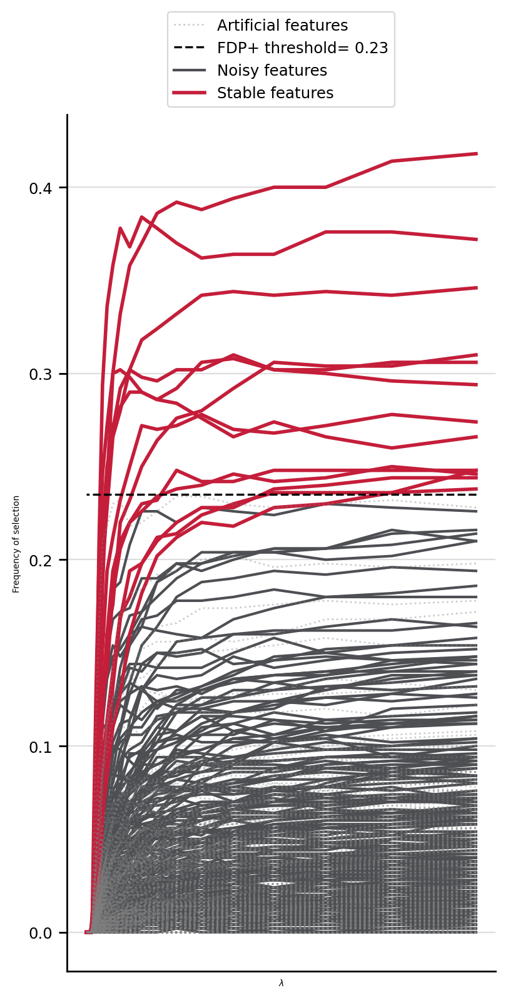

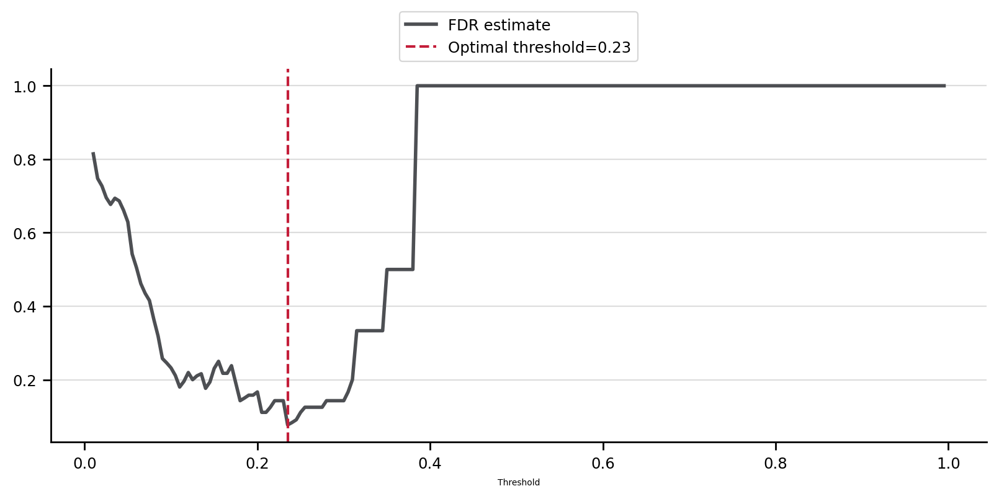

In [1176]:
# Plot the path of the STABL selection over the regularization
try:
    plot_stabl_path(JSD_overall_pipe[1])
    plt.savefig("stabl_path_JSD_features.svg")
    plot_fdr_graph(JSD_overall_pipe[1])
    plt.savefig("stabl_fdr_JSD_features.svg")
    jsdselectedFeatures = JSD_overall_pipe[:-1].get_feature_names_out()
    jsdcurrentselectedfeatures = list(JSD_overall_pipe[:-1].get_feature_names_out())
    print(jsdcurrentselectedfeatures)
except:
    pass

### NB proportions in Metabolic NBs

In [36]:
X_all.loc[:,X_all.columns.str.contains('nbMeta')].shape

(55, 332)

In [935]:
random_state = 42
nbMeta_lasso = Lasso(max_iter=int(1e5), random_state=random_state)
#nbMeta_lasso = LogisticRegression(penalty='l1', max_iter=int(1e5), solver="saga", class_weight="balanced", random_state=random_state)

nbMeta_lasso_stabl_class = Stabl(
    base_estimator=clone(nbMeta_lasso),
    lambda_grid="auto",
    n_lambda=30,
    artificial_type="knockoff",
    artificial_proportion=1,
    fdr_threshold_range=np.arange(0.01, 1.0, 0.005),
    n_bootstraps=500,
    random_state=random_state,
    verbose=1,
)

nbMeta_logistic_final = LogisticRegression(penalty=None, max_iter=int(1e6), solver="saga", class_weight="balanced", random_state=random_state)

nbMeta_overall_pipe = Pipeline(
    steps=[
        ("preprocessing", lasso_preprocessing),  # We use the preprocessing pipeline previously defined
        ("feature_selection", nbMeta_lasso_stabl_class),  # We use Stabl for feature selection
        ("final_model", nbMeta_logistic_final)  # We use Logistic Regression as final model
    ]
)

#try:
nbMeta_overall_pipe.fit(X_all.loc[:,X_all.columns.str.contains('nbMeta')], y_all)
#except Exception as e:
#    print(e)
#    pass

Stabl progress: 100%|███████████████████████████████████████████████████████████████████| 30/30 [01:37<00:00,  3.26s/it]


Pipeline(steps=[('preprocessing',
                 Pipeline(steps=[('variance_threshold', VarianceThreshold()),
                                 ('std', StandardScaler())])),
                ('feature_selection',
                 Stabl(artificial_proportion=1, artificial_type='knockoff',
                       base_estimator=Lasso(max_iter=100000, random_state=42),
                       fdr_threshold_range=array([0.01 , 0.015, 0.02 , 0.025, 0.03 , 0.035, 0.04 , 0.045, 0.05 ,
       0.055, 0.06 , 0.065, 0.07 ,...
       0.82 , 0.825, 0.83 , 0.835, 0.84 , 0.845, 0.85 , 0.855, 0.86 ,
       0.865, 0.87 , 0.875, 0.88 , 0.885, 0.89 , 0.895, 0.9  , 0.905,
       0.91 , 0.915, 0.92 , 0.925, 0.93 , 0.935, 0.94 , 0.945, 0.95 ,
       0.955, 0.96 , 0.965, 0.97 , 0.975, 0.98 , 0.985, 0.99 , 0.995]),
                       lambda_grid='auto', n_bootstraps=500, n_lambda=30,
                       random_state=42, verbose=1)),
                ('final_model',
                 LogisticRegression(class_weight='balanced', max_iter=1000000,
                                    penalty=None, random_state=42,
                                    solver='saga'))])

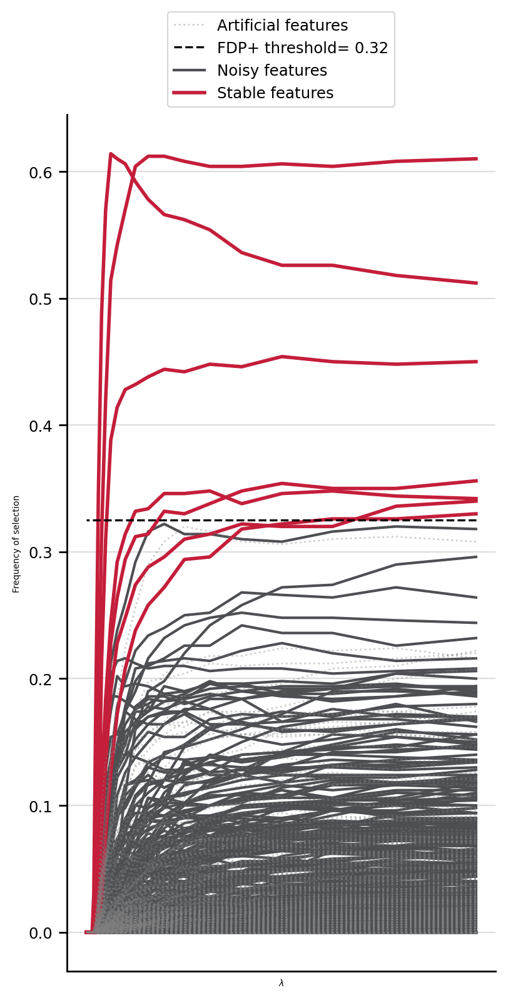

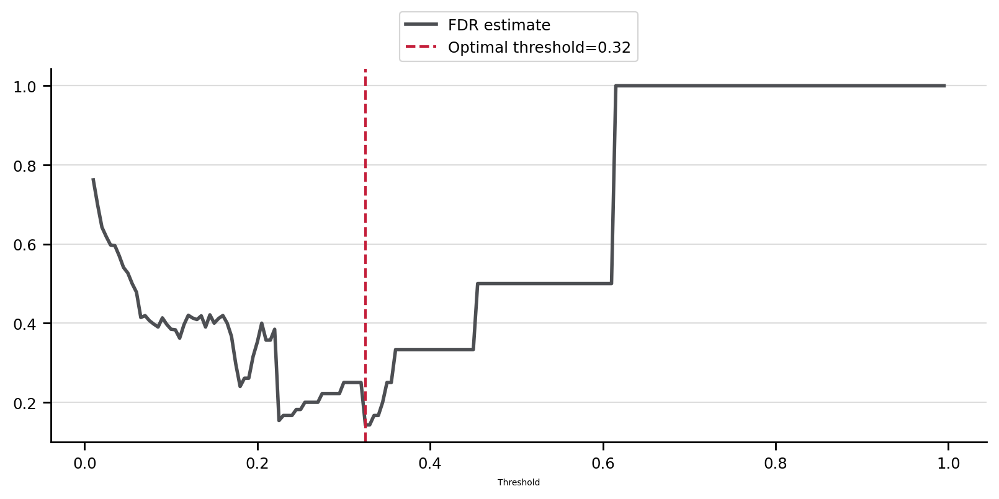

In [1175]:
# Plot the path of the STABL selection over the regularization
try:
    plot_stabl_path(nbMeta_overall_pipe[1])
    plt.savefig("stabl_path_nbMeta_features.svg")
    plot_fdr_graph(nbMeta_overall_pipe[1])
    plt.savefig("stabl_fdr_nbMeta_features.svg")
    nbMetaselectedFeatures = nbMeta_overall_pipe[:-1].get_feature_names_out()
    nbMetacurrentselectedfeatures = list(nbMeta_overall_pipe[:-1].get_feature_names_out())
    print(nbMetacurrentselectedfeatures)
except:
    pass

# NB

In [37]:
X_all.loc[:,X_all.columns.str.contains('nbnb')].shape

(55, 627)

In [939]:
nbCN_lasso = Lasso(max_iter=int(1e5), random_state=random_state)
#nbCN_lasso = LogisticRegression(penalty='l1', max_iter=int(1e5), solver="saga", class_weight="balanced", random_state=random_state)
# Already run LogReg, no features

nbCN_lasso_stabl_class = Stabl(
    base_estimator=clone(nbCN_lasso),
    lambda_grid="auto",
    n_lambda=30,
    artificial_type="random_permutation",
    artificial_proportion=1,
    fdr_threshold_range=np.arange(0.01, 1.0, 0.005),
    n_bootstraps=500,
    random_state=random_state,
    verbose=1,
)

nbCN_logistic_final = LogisticRegression(penalty=None, max_iter=int(1e6), solver="saga", class_weight="balanced", random_state=random_state)

nbCN_overall_pipe = Pipeline(
    steps=[
        ("preprocessing", lasso_preprocessing),  # We use the preprocessing pipeline previously defined
        ("feature_selection", nbCN_lasso_stabl_class),  # We use Stabl for feature selection
        ("final_model", nbCN_logistic_final)  # We use Logistic Regression as final model
    ]
)

#try:
nbCN_overall_pipe.fit(X_all.loc[:,X_all.columns.str.contains('nbnb')], y_all)
#except Exception as e:
#    print(e)
#    pass

Stabl progress: 100%|███████████████████████████████████████████████████████████████████| 30/30 [01:07<00:00,  2.24s/it]


ValueError: Found array with 0 feature(s) (shape=(55, 0)) while a minimum of 1 is required by LogisticRegression.

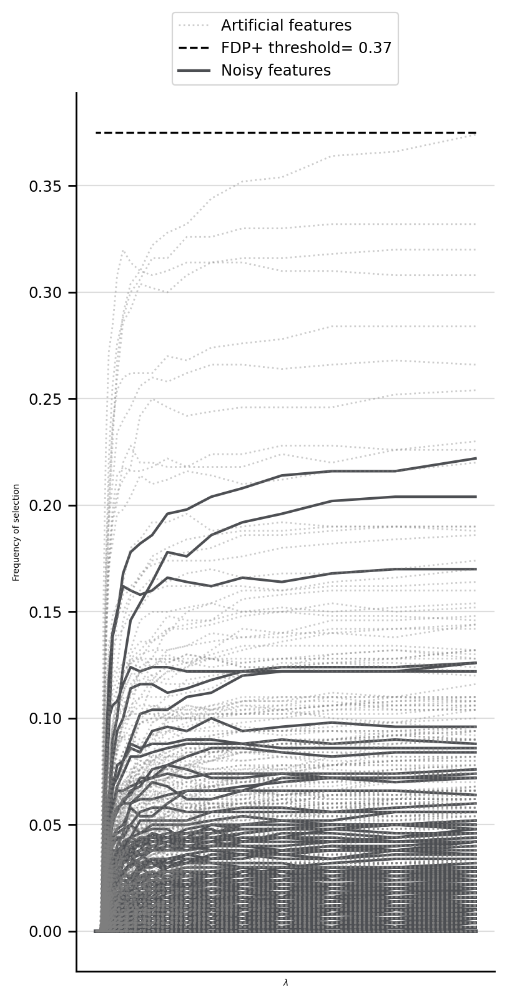

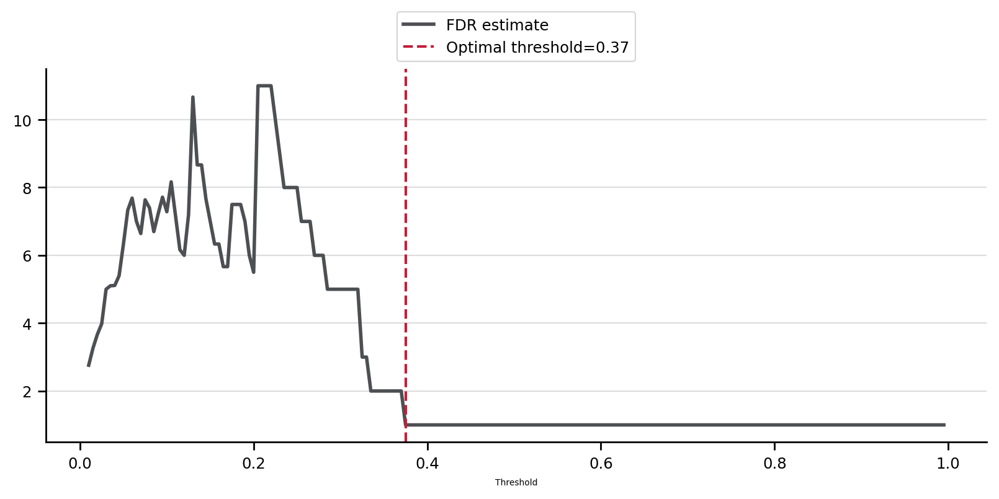

In [1186]:
# Plot the path of the STABL selection over the regularization
try:
    plot_stabl_path(nbCN_overall_pipe[1])
    plt.savefig("stabl_path_nbCN_features.svg")
    plot_fdr_graph(nbCN_overall_pipe[1])
    plt.savefig("stabl_fdr_nbCN_features.svg")
    nbCNselectedFeatures = nbCN_overall_pipe[:-1].get_feature_names_out()
    nbCNcurrentselectedfeatures = list(nbCN_overall_pipe[:-1].get_feature_names_out())
    print(nbCNcurrentselectedfeatures)
except:
    pass

# GCross CNs

In [941]:
X_all.loc[:,X_all.columns.str.contains('GCross_k2') & X_all.columns.str.contains('All')].shape

(55, 950)

In [942]:
GCross_k2_lasso = Lasso(max_iter=int(1e5), random_state=random_state)
#GCross_k2_lasso = LogisticRegression(penalty='l1', max_iter=int(1e5), solver="saga", class_weight="balanced", random_state=random_state)

GCross_k2_lasso_stabl_class = Stabl(
    base_estimator=clone(GCross_k2_lasso),
    lambda_grid="auto",
    n_lambda=30,
    artificial_type="knockoff",
    artificial_proportion=1,
    fdr_threshold_range=np.arange(0.001, 1.0, 0.005),
    n_bootstraps=500,
    random_state=random_state,
    verbose=1,
    n_jobs=10,
)

GCross_k2_logistic_final = LogisticRegression(penalty=None, max_iter=int(1e6), solver="saga", class_weight="balanced", random_state=random_state)

GCross_k2_overall_pipe = Pipeline(
    steps=[
        ("preprocessing", lasso_preprocessing),  # We use the preprocessing pipeline previously defined
        ("feature_selection", GCross_k2_lasso_stabl_class),  # We use Stabl for feature selection
        ("final_model", GCross_k2_logistic_final)  # We use Logistic Regression as final model
    ]
)

#try:
GCross_k2_overall_pipe.fit(X_all.loc[:,X_all.columns.str.contains('GCross_k2') & X_all.columns.str.contains('All')], y_all)
#except Exception as e:
#    print(e)
#    pass

Stabl progress: 100%|███████████████████████████████████████████████████████████████████| 30/30 [01:59<00:00,  3.99s/it]


Pipeline(steps=[('preprocessing',
                 Pipeline(steps=[('variance_threshold', VarianceThreshold()),
                                 ('std', StandardScaler())])),
                ('feature_selection',
                 Stabl(artificial_proportion=1, artificial_type='knockoff',
                       base_estimator=Lasso(max_iter=100000, random_state=42),
                       fdr_threshold_range=array([0.001, 0.006, 0.011, 0.016, 0.021, 0.026, 0.031, 0.036, 0.041,
       0.046, 0.051, 0.056...
       0.856, 0.861, 0.866, 0.871, 0.876, 0.881, 0.886, 0.891, 0.896,
       0.901, 0.906, 0.911, 0.916, 0.921, 0.926, 0.931, 0.936, 0.941,
       0.946, 0.951, 0.956, 0.961, 0.966, 0.971, 0.976, 0.981, 0.986,
       0.991, 0.996]),
                       lambda_grid='auto', n_bootstraps=500, n_jobs=10,
                       n_lambda=30, random_state=42, verbose=1)),
                ('final_model',
                 LogisticRegression(class_weight='balanced', max_iter=1000000,
                                    penalty=None, random_state=42,
                                    solver='saga'))])

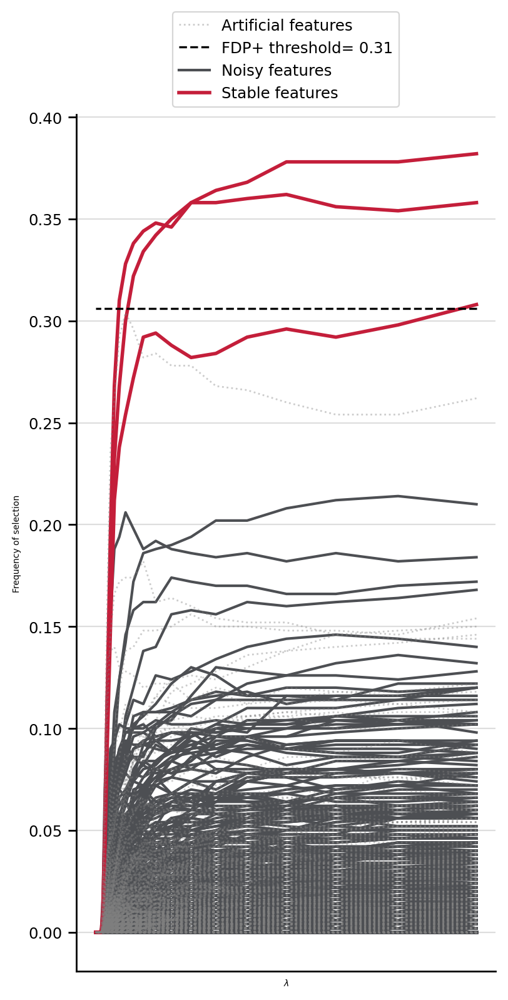

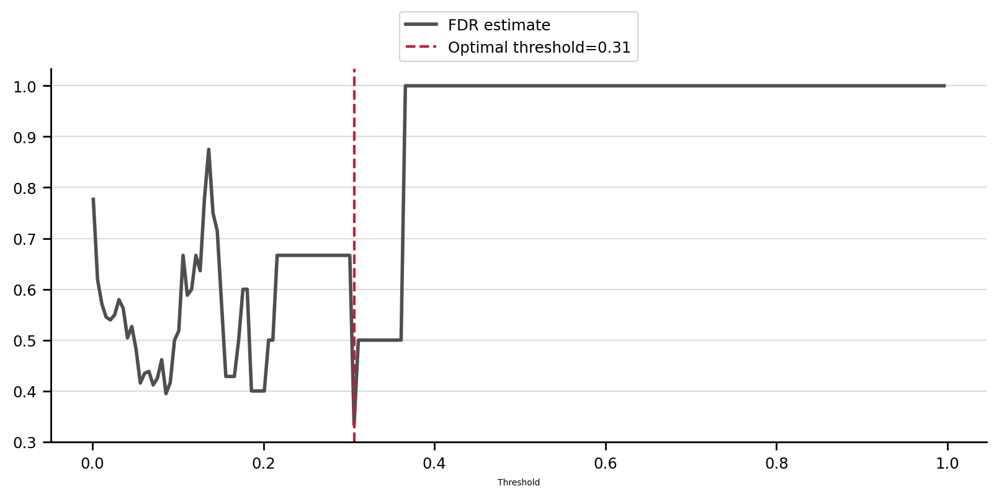

In [1174]:
try:
    plot_stabl_path(GCross_k2_overall_pipe[1])
    plt.savefig("stabl_path_k2_features.svg")
    plot_fdr_graph(GCross_k2_overall_pipe[1])
    plt.savefig("stabl_fdr_k2_features.svg")
    gcrossk2selectedFeatures = GCross_k2_overall_pipe[:-1].get_feature_names_out()
    gcrossk2currentselectedfeatures = list(GCross_k2_overall_pipe[:-1].get_feature_names_out())
    print(gcrossk2currentselectedfeatures)
except:
    pass

In [944]:
X_all.loc[:,X_all.columns.str.contains('GCross_k3') & X_all.columns.str.contains('All')].shape

(55, 755)

In [946]:
random_state = 42
GCross_k3_lasso = Lasso(max_iter=int(1e5), random_state=random_state)
#GCross_k3_lasso = LogisticRegression(penalty='l1', max_iter=int(1e5), solver="saga", class_weight="balanced", random_state=random_state)

GCross_k3_lasso_stabl_class = Stabl(
    base_estimator=clone(GCross_k3_lasso),
    lambda_grid="auto",
    n_lambda=30,
    artificial_type="knockoff",
    artificial_proportion=1,
    fdr_threshold_range=np.arange(0.01, 1.0, 0.005),
    n_bootstraps=500,
    random_state=random_state,
    verbose=1,
)

GCross_k3_logistic_final = LogisticRegression(penalty=None, max_iter=int(1e6), solver="saga", class_weight="balanced", random_state=random_state)

GCross_k3_overall_pipe = Pipeline(
    steps=[
        ("preprocessing", lasso_preprocessing),  # We use the preprocessing pipeline previously defined
        ("feature_selection", GCross_k3_lasso_stabl_class),  # We use Stabl for feature selection
        ("final_model", GCross_k3_logistic_final)  # We use Logistic Regression as final model
    ]
)

#try:
GCross_k3_overall_pipe.fit(X_all.loc[:,X_all.columns.str.contains('GCross_k3') & X_all.columns.str.contains('All')], y_all)
#except Exception as e:
#    print(e)
#    pass

Stabl progress: 100%|███████████████████████████████████████████████████████████████████| 30/30 [02:01<00:00,  4.04s/it]


Pipeline(steps=[('preprocessing',
                 Pipeline(steps=[('variance_threshold', VarianceThreshold()),
                                 ('std', StandardScaler())])),
                ('feature_selection',
                 Stabl(artificial_proportion=1, artificial_type='knockoff',
                       base_estimator=Lasso(max_iter=100000, random_state=42),
                       fdr_threshold_range=array([0.01 , 0.015, 0.02 , 0.025, 0.03 , 0.035, 0.04 , 0.045, 0.05 ,
       0.055, 0.06 , 0.065, 0.07 ,...
       0.82 , 0.825, 0.83 , 0.835, 0.84 , 0.845, 0.85 , 0.855, 0.86 ,
       0.865, 0.87 , 0.875, 0.88 , 0.885, 0.89 , 0.895, 0.9  , 0.905,
       0.91 , 0.915, 0.92 , 0.925, 0.93 , 0.935, 0.94 , 0.945, 0.95 ,
       0.955, 0.96 , 0.965, 0.97 , 0.975, 0.98 , 0.985, 0.99 , 0.995]),
                       lambda_grid='auto', n_bootstraps=500, n_lambda=30,
                       random_state=42, verbose=1)),
                ('final_model',
                 LogisticRegression(class_weight='balanced', max_iter=1000000,
                                    penalty=None, random_state=42,
                                    solver='saga'))])

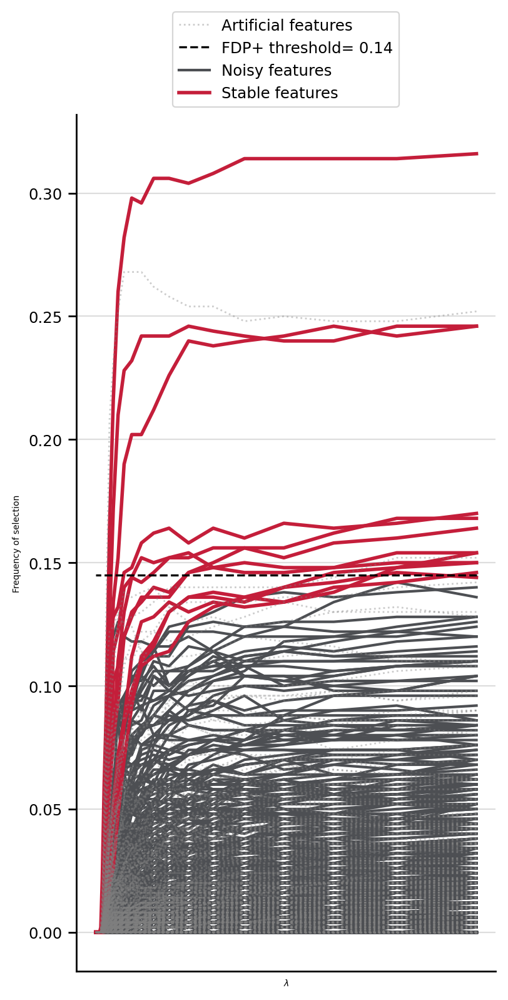

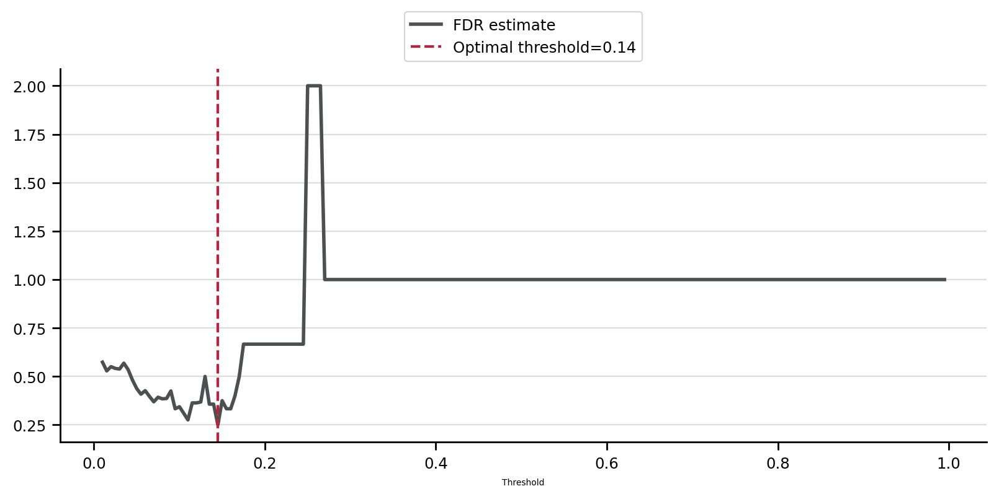

In [1173]:
try:
    plot_stabl_path(GCross_k3_overall_pipe[1])
    plt.savefig("stabl_path_k3_features.svg")
    plot_fdr_graph(GCross_k3_overall_pipe[1])
    plt.savefig("stabl_fdr_k4_features.svg")
    gcrossk3selectedFeatures = GCross_k3_overall_pipe[:-1].get_feature_names_out()
    gcrossk3currentselectedfeatures = list(GCross_k3_overall_pipe[:-1].get_feature_names_out())
    print(gcrossk3currentselectedfeatures)
except:
    pass

# GCross Edges

In [948]:
X_all.loc[:,X_all.columns.str.contains('Edge')].shape

(55, 159)

In [949]:
random_state = 42
GCross_edge_lasso = Lasso(max_iter=int(1e5), random_state=random_state)
#GCross_k3_lasso = LogisticRegression(penalty='l1', max_iter=int(1e5), solver="saga", class_weight="balanced", random_state=random_state)

GCross_edge_lasso_stabl_class = Stabl(
    base_estimator=clone(GCross_edge_lasso),
    lambda_grid="auto",
    n_lambda=30,
    artificial_type="knockoff",
    artificial_proportion=1,
    fdr_threshold_range=np.arange(0.01, 1.0, 0.005),
    n_bootstraps=500,
    random_state=random_state,
    verbose=1,
)

GCross_edge_logistic_final = LogisticRegression(penalty=None, max_iter=int(1e6), solver="saga", class_weight="balanced", random_state=random_state)

GCross_edge_overall_pipe = Pipeline(
    steps=[
        ("preprocessing", lasso_preprocessing),  # We use the preprocessing pipeline previously defined
        ("feature_selection", GCross_edge_lasso_stabl_class),  # We use Stabl for feature selection
        ("final_model", GCross_edge_logistic_final)  # We use Logistic Regression as final model
    ]
)

#try:
GCross_edge_lasso_stabl_class.fit(X_all.loc[:,X_all.columns.str.contains('Edge')], y_all)
#except Exception as e:
#    print(e)
#    pass

Stabl progress: 100%|███████████████████████████████████████████████████████████████████| 30/30 [01:20<00:00,  2.69s/it]


Stabl(artificial_proportion=1, artificial_type='knockoff',
      base_estimator=Lasso(max_iter=100000, random_state=42),
      fdr_threshold_range=array([0.01 , 0.015, 0.02 , 0.025, 0.03 , 0.035, 0.04 , 0.045, 0.05 ,
       0.055, 0.06 , 0.065, 0.07 , 0.075, 0.08 , 0.085, 0.09 , 0.095,
       0.1  , 0.105, 0.11 , 0.115, 0.12 , 0.125, 0.13 , 0.135, 0.14 ,
       0.145, 0.15 , 0.155, 0.16 , 0.165, 0.17 , 0.175, 0.18 , 0.185,
       0.19 , 0.195, 0.2  ,...
       0.73 , 0.735, 0.74 , 0.745, 0.75 , 0.755, 0.76 , 0.765, 0.77 ,
       0.775, 0.78 , 0.785, 0.79 , 0.795, 0.8  , 0.805, 0.81 , 0.815,
       0.82 , 0.825, 0.83 , 0.835, 0.84 , 0.845, 0.85 , 0.855, 0.86 ,
       0.865, 0.87 , 0.875, 0.88 , 0.885, 0.89 , 0.895, 0.9  , 0.905,
       0.91 , 0.915, 0.92 , 0.925, 0.93 , 0.935, 0.94 , 0.945, 0.95 ,
       0.955, 0.96 , 0.965, 0.97 , 0.975, 0.98 , 0.985, 0.99 , 0.995]),
      lambda_grid='auto', n_bootstraps=500, n_lambda=30, random_state=42,
      verbose=1)

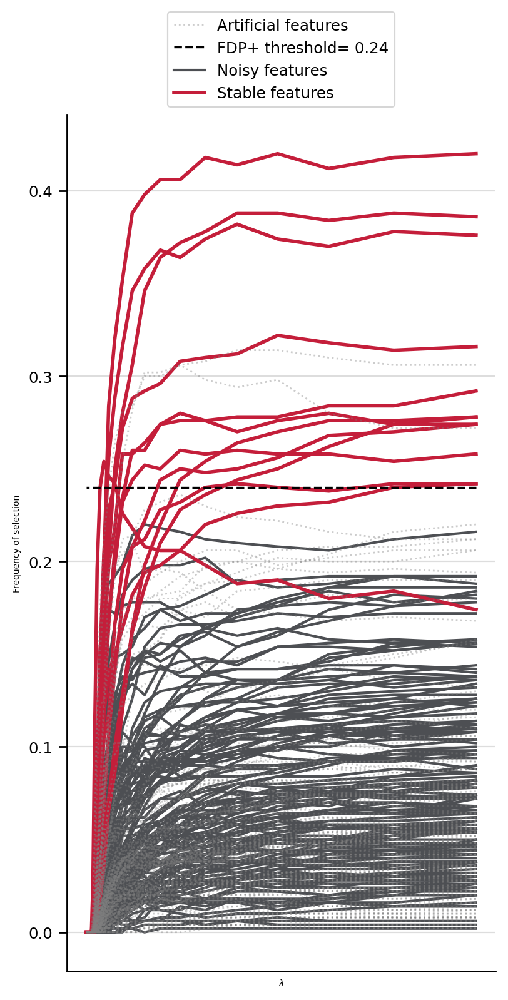

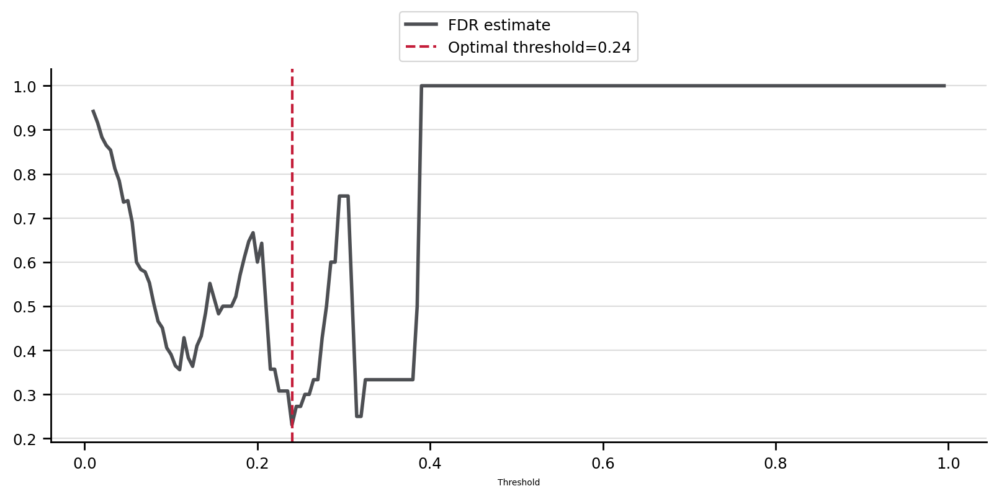

In [1172]:
try:
    plot_stabl_path(GCross_edge_overall_pipe[1])
    plt.savefig("stabl_path_GCrossEdge_features.svg")
    plot_fdr_graph(GCross_edge_overall_pipe[1])
    plt.savefig("stabl_fdr_GCrossEdge_features.svg")
    gcrossedgeselectedFeatures = GCross_edge_overall_pipe[:-1].get_feature_names_out()
    gcrossedgecurrentselectedfeatures = list(GCross_edge_overall_pipe[:-1].get_feature_names_out())
    print(gcrossedgecurrentselectedfeatures)
except:
    pass

In [951]:
print(gcrossedgecurrentselectedfeatures)

['GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_0_1_fibroblastcells_granulocytecells', 'GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_0_1_fibroblastcells_macrophagecells', 'GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_1_0_granulocytecells_granulocytecells', 'GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_1_0_macrophagecells_fibroblastcells', 'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_1_2_cd8tcells_cd4tregcells', 'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_1_2_fibroblastcells_cd8tcells', 'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_1_2_tumorcells_tumorcells', 'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_2_1_granulocytecells_cd8tcells', 'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_2_1_immunenoscells_cd8tcells', 'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_2_1_tumorcells_endothilialcells', 'GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_EdgeCells_2_1_tumorcells_tumorcells', 'GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_0_2_granulocytecells_tumorcells', 'GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_

# GCross MBN

In [952]:
X_all.loc[:,X_all.columns.str.contains('GCross_M')].shape

(55, 835)

In [954]:
random_state = 42
GCross_M_lasso = Lasso(max_iter=int(1e5), random_state=random_state)
#GCross_M_lasso = LogisticRegression(penalty='l1', max_iter=int(1e5), solver="saga", class_weight="balanced", random_state=random_state)

GCross_M_lasso_stabl_class = Stabl(
    base_estimator=clone(GCross_M_lasso),
    lambda_grid="auto",
    n_lambda=30,
    artificial_type="knockoff",
    artificial_proportion=1,
    fdr_threshold_range=np.arange(0.01, 1.0, 0.005),
    n_bootstraps=500,
    random_state=random_state,
    verbose=1,
)

GCross_M_logistic_final = LogisticRegression(penalty=None, max_iter=int(1e6), solver="saga", class_weight="balanced", random_state=random_state)

GCross_M_overall_pipe = Pipeline(
    steps=[
        ("preprocessing", lasso_preprocessing),  # We use the preprocessing pipeline previously defined
        ("feature_selection", GCross_M_lasso_stabl_class),  # We use Stabl for feature selection
        ("final_model", GCross_M_logistic_final)  # We use Logistic Regression as final model
    ]
)

#try:
GCross_M_overall_pipe.fit(X_all.loc[:,X_all.columns.str.contains('GCross_M')], y_all)
#except Exception as e:
#    print(e)
#    pass

Stabl progress: 100%|███████████████████████████████████████████████████████████████████| 30/30 [02:14<00:00,  4.47s/it]


Pipeline(steps=[('preprocessing',
                 Pipeline(steps=[('variance_threshold', VarianceThreshold()),
                                 ('std', StandardScaler())])),
                ('feature_selection',
                 Stabl(artificial_proportion=1, artificial_type='knockoff',
                       base_estimator=Lasso(max_iter=100000, random_state=42),
                       fdr_threshold_range=array([0.01 , 0.015, 0.02 , 0.025, 0.03 , 0.035, 0.04 , 0.045, 0.05 ,
       0.055, 0.06 , 0.065, 0.07 ,...
       0.82 , 0.825, 0.83 , 0.835, 0.84 , 0.845, 0.85 , 0.855, 0.86 ,
       0.865, 0.87 , 0.875, 0.88 , 0.885, 0.89 , 0.895, 0.9  , 0.905,
       0.91 , 0.915, 0.92 , 0.925, 0.93 , 0.935, 0.94 , 0.945, 0.95 ,
       0.955, 0.96 , 0.965, 0.97 , 0.975, 0.98 , 0.985, 0.99 , 0.995]),
                       lambda_grid='auto', n_bootstraps=500, n_lambda=30,
                       random_state=42, verbose=1)),
                ('final_model',
                 LogisticRegression(class_weight='balanced', max_iter=1000000,
                                    penalty=None, random_state=42,
                                    solver='saga'))])

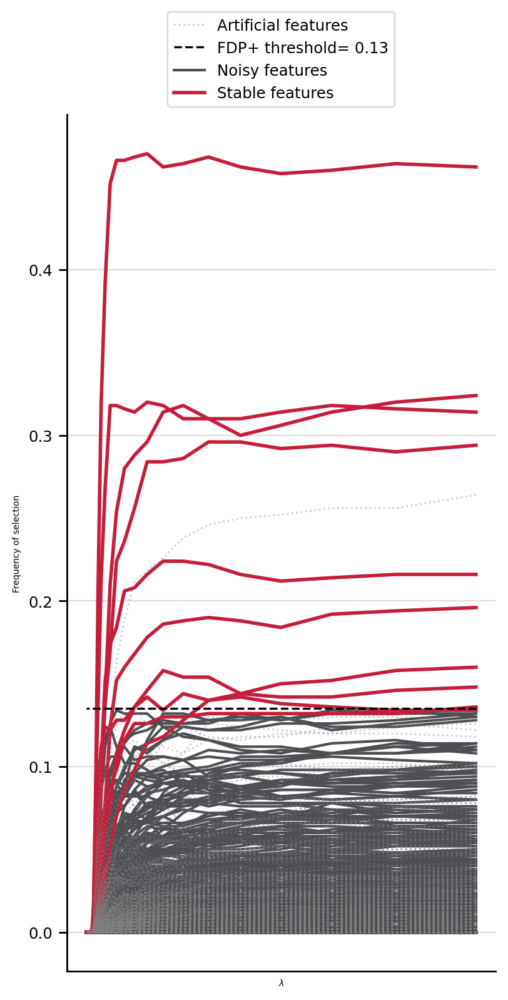

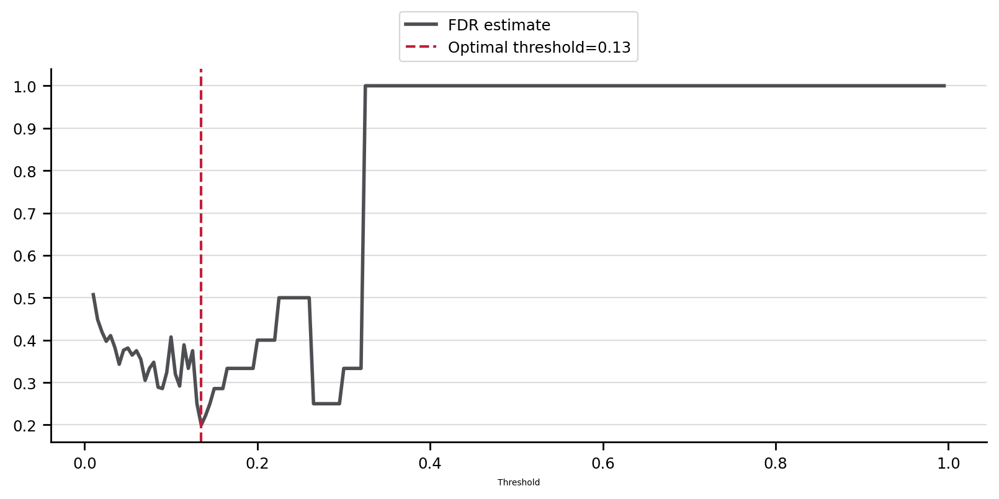

In [1171]:
try:
    plot_stabl_path(GCross_M_overall_pipe[1])
    plt.savefig("stabl_path_GCrossMBN_features.svg")
    plot_fdr_graph(GCross_M_overall_pipe[1])
    plt.savefig("stabl_fdr_GCrossMBN_features.svg")
    GCross_M_selectedFeatures = GCross_M_overall_pipe[:-1].get_feature_names_out()
    GCross_M_currentselectedfeatures = list(GCross_M_overall_pipe[:-1].get_feature_names_out())
    print(GCross_M_currentselectedfeatures)
except:
    pass

# Metabolic G-Cross

In [956]:
X_all.loc[:,X_all.columns.str.contains('MetaG')].shape

(55, 378)

In [957]:
random_state = 42
MetaG_lasso = Lasso(max_iter=int(1e5), random_state=random_state)
#MetaG_lasso = LogisticRegression(penalty='l1', max_iter=int(1e5), solver="saga", class_weight="balanced", random_state=random_state)

MetaG_lasso_stabl_class = Stabl(
    base_estimator=clone(MetaG_lasso),
    lambda_grid="auto",
    n_lambda=30,
    artificial_type="knockoff",
    artificial_proportion=1,
    fdr_threshold_range=np.arange(0.01, 1.0, 0.005),
    n_bootstraps=500,
    random_state=random_state,
    verbose=1,
)

MetaG_logistic_final = LogisticRegression(penalty=None, max_iter=int(1e6), solver="saga", class_weight="balanced", random_state=random_state)

MetaG_overall_pipe = Pipeline(
    steps=[
        ("preprocessing", lasso_preprocessing),  # We use the preprocessing pipeline previously defined
        ("feature_selection", MetaG_lasso_stabl_class),  # We use Stabl for feature selection
        ("final_model", MetaG_logistic_final)  # We use Logistic Regression as final model
    ]
)

#try:
MetaG_overall_pipe.fit(X_all.loc[:,X_all.columns.str.contains('MetaG')], y_all)
#except Exception as e:
#    print(e)
#    pass

Stabl progress: 100%|███████████████████████████████████████████████████████████████████| 30/30 [00:32<00:00,  1.08s/it]


Pipeline(steps=[('preprocessing',
                 Pipeline(steps=[('variance_threshold', VarianceThreshold()),
                                 ('std', StandardScaler())])),
                ('feature_selection',
                 Stabl(artificial_proportion=1, artificial_type='knockoff',
                       base_estimator=Lasso(max_iter=100000, random_state=42),
                       fdr_threshold_range=array([0.01 , 0.015, 0.02 , 0.025, 0.03 , 0.035, 0.04 , 0.045, 0.05 ,
       0.055, 0.06 , 0.065, 0.07 ,...
       0.82 , 0.825, 0.83 , 0.835, 0.84 , 0.845, 0.85 , 0.855, 0.86 ,
       0.865, 0.87 , 0.875, 0.88 , 0.885, 0.89 , 0.895, 0.9  , 0.905,
       0.91 , 0.915, 0.92 , 0.925, 0.93 , 0.935, 0.94 , 0.945, 0.95 ,
       0.955, 0.96 , 0.965, 0.97 , 0.975, 0.98 , 0.985, 0.99 , 0.995]),
                       lambda_grid='auto', n_bootstraps=500, n_lambda=30,
                       random_state=42, verbose=1)),
                ('final_model',
                 LogisticRegression(class_weight='balanced', max_iter=1000000,
                                    penalty=None, random_state=42,
                                    solver='saga'))])

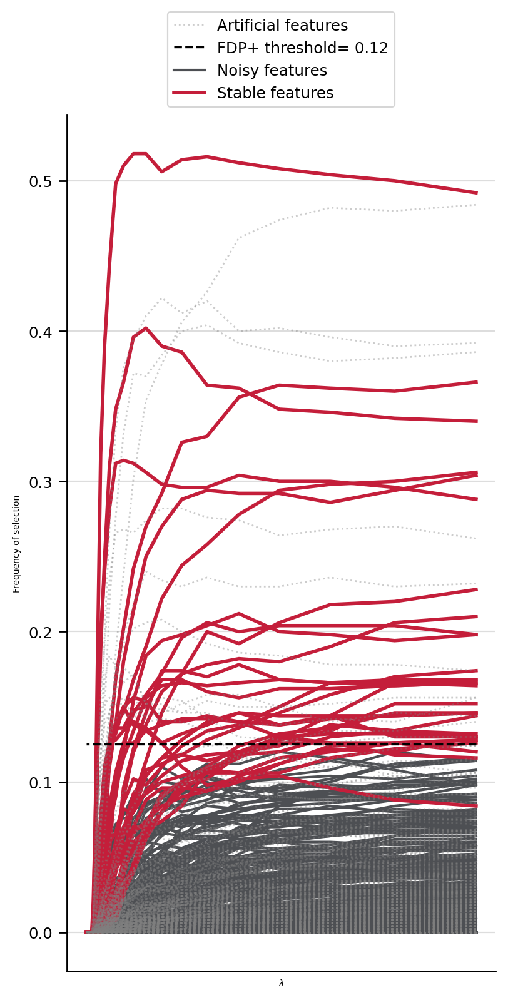

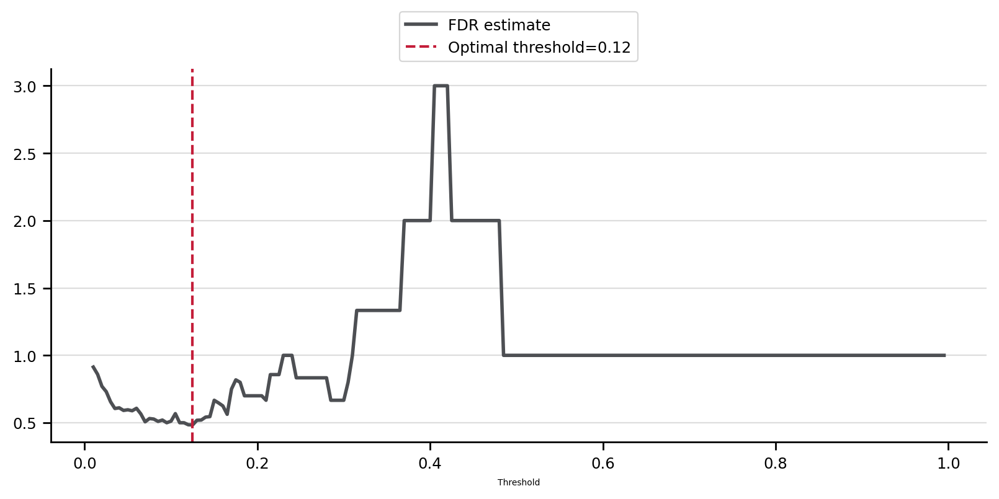

In [1170]:
try:
    plot_stabl_path(MetaG_overall_pipe[1])
    plt.savefig("stabl_path_metaG_features.svg")
    plot_fdr_graph(MetaG_overall_pipe[1])
    plt.savefig("stabl_fdr_metaG_features.svg")
    metagcrossselectedFeatures = MetaG_overall_pipe[:-1].get_feature_names_out()
    metagcrosscurrentselectedfeatures = list(MetaG_overall_pipe[:-1].get_feature_names_out())
    print(metagcrosscurrentselectedfeatures)
except:
    pass

# SMI Features

In [959]:
X_all.loc[:,X_all.columns.str.contains('smi')].shape

(55, 0)

In [1190]:
random_state = 42
#smi_lasso = Lasso(max_iter=int(1e5), random_state=random_state)
smi_lasso = LogisticRegression(penalty='l1', max_iter=int(1e5), solver="saga", class_weight="balanced", random_state=random_state)

smi_lasso_stabl_class = Stabl(
    base_estimator=clone(smi_lasso),
    lambda_grid="auto",
    n_lambda=30,
    artificial_type="random_permutation",
    artificial_proportion=1,
    fdr_threshold_range=np.arange(0.01, 1.0, 0.005),
    n_bootstraps=500,
    random_state=random_state,
    verbose=1,
)

smi_logistic_final = LogisticRegression(penalty=None, max_iter=int(1e6), solver="saga", class_weight="balanced", random_state=random_state)

smi_overall_pipe = Pipeline(
    steps=[
        ("preprocessing", lasso_preprocessing),  # We use the preprocessing pipeline previously defined
        ("feature_selection", smi_lasso_stabl_class),  # We use Stabl for feature selection
        ("final_model", smi_logistic_final)  # We use Logistic Regression as final model
    ]
)

#try:
smi_overall_pipe.fit(X_all.loc[:,X_all.columns.str.contains('smi')], y_all)
#except Exception as e:
#    print(e)
#    pass

ValueError: at least one array or dtype is required

In [1189]:
try:
    plot_stabl_path(smi_overall_pipe[1])
    plt.savefig("stabl_path_smi_features.svg")
    plot_fdr_graph(smi_overall_pipe[1])
    plt.savefig("stabl_fdr_smi_features.svg")
    smiselectedFeatures = smi_overall_pipe[:-1].get_feature_names_out()
    smicurrentselectedfeatures = list(smi_overall_pipe[:-1].get_feature_names_out())
    print(smicurrentselectedfeatures)
except:
    pass

# NB Ratios

In [962]:
X_all.columns[X_all.columns.str.contains('nratiob:cd8tcells:Stroma_cd8tcells:Tumour')]

Index(['nratiob:cd8tcells:Stroma_cd8tcells:Tumour_x',
       'nratiob:cd8tcells:Stroma_cd8tcells:Tumour_Stroma_interface_x',
       'nratiob:cd8tcells:Stroma_cd8tcells:Tumour_y',
       'nratiob:cd8tcells:Stroma_cd8tcells:Tumour_Stroma_interface_y'],
      dtype='object')

In [963]:
X_all.loc[:,X_all.columns.str.contains('nratiob') & ~X_all.columns.str.contains('_y')].shape

(55, 2833)

In [964]:
random_state = 42
nratiob_lasso = Lasso(max_iter=int(1e5), random_state=random_state)
#nratiob_lasso = LogisticRegression(penalty='l1', max_iter=int(1e5), solver="saga", class_weight="balanced", random_state=random_state)

nratiob_lasso_stabl_class = Stabl(
    base_estimator=clone(nratiob_lasso),
    lambda_grid="auto",
    n_lambda=30,
    artificial_type="knockoff",
    artificial_proportion=1,
    fdr_threshold_range=np.arange(0.01, 1.0, 0.005),
    n_bootstraps=200,
    random_state=random_state,
    verbose=1,
)

nratiob_logistic_final = LogisticRegression(penalty=None, max_iter=int(1e6), solver="saga", class_weight="balanced", random_state=random_state)

nratiob_overall_pipe = Pipeline(
    steps=[
        ("preprocessing", lasso_preprocessing),  # We use the preprocessing pipeline previously defined
        ("feature_selection", nratiob_lasso_stabl_class),  # We use Stabl for feature selection
        ("final_model", nratiob_logistic_final)  # We use Logistic Regression as final model
    ]
)

#try:
nratiob_overall_pipe.fit(X_all.loc[:,X_all.columns.str.contains('nratiob') & ~X_all.columns.str.contains('_y')], y_all)
#except Exception as e:
#    print(e)
#    pass

Stabl progress: 100%|███████████████████████████████████████████████████████████████████| 30/30 [01:39<00:00,  3.33s/it]


ValueError: Found array with 0 feature(s) (shape=(55, 0)) while a minimum of 1 is required by LogisticRegression.

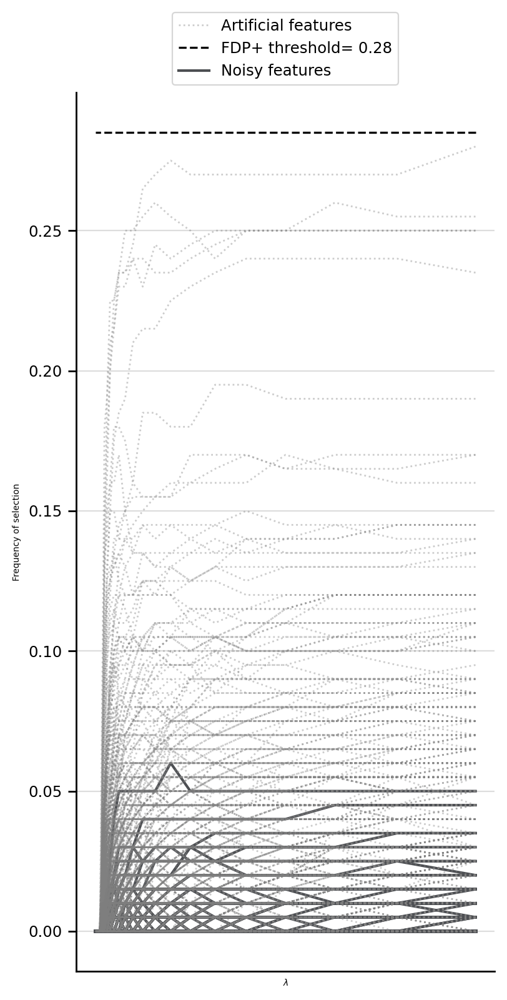

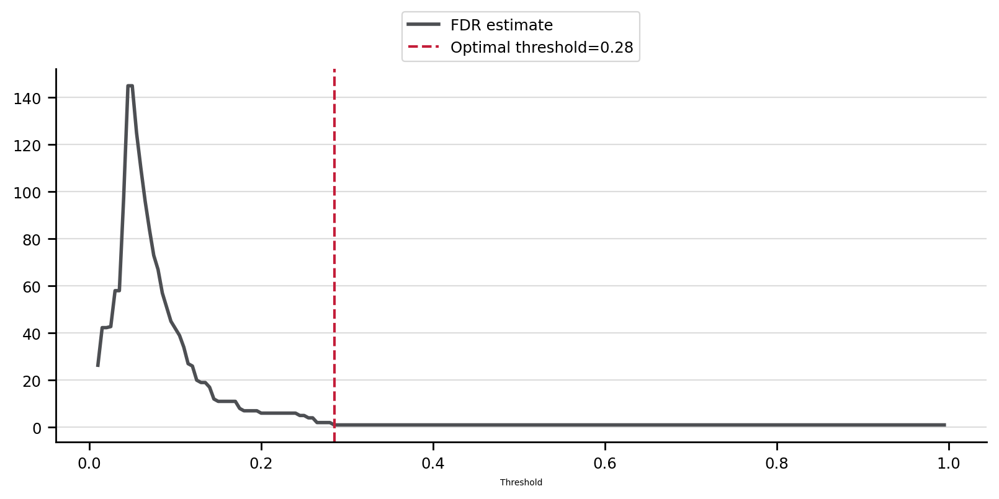

In [1188]:
try:
    plot_stabl_path(nratiob_overall_pipe[1])
    plt.savefig("stabl_path_nratiob_features.svg")
    plot_fdr_graph(nratiob_overall_pipe[1])
    plt.savefig("stabl_fdr_nratiob_features.svg")
    nratiobselectedFeatures = nratiob_overall_pipe[:-1].get_feature_names_out()
    nratiobcurrentselectedfeatures = list(nratiob_overall_pipe[:-1].get_feature_names_out())
    print(nratiobcurrentselectedfeatures)
except:
    pass

# Combine

In [966]:
allSelectedFeatures = []
allSelectedFeatures.extend(jsdcurrentselectedfeatures)
allSelectedFeatures.extend(nbMetacurrentselectedfeatures)
allSelectedFeatures.extend(nbCNcurrentselectedfeatures)
allSelectedFeatures.extend(gcrossk2currentselectedfeatures)
allSelectedFeatures.extend(gcrossedgecurrentselectedfeatures)
allSelectedFeatures.extend(gcrossk3currentselectedfeatures)
allSelectedFeatures.extend(GCross_M_currentselectedfeatures)
allSelectedFeatures.extend(metagcrosscurrentselectedfeatures)
allSelectedFeatures = list(set(allSelectedFeatures))
#allSelectedFeatures.extend(smicurrentselectedfeatures)
#allSelectedFeatures.extend(nratiobcurrentselectedfeatures)

In [967]:
jsdcurrentselectedfeatures

['JSDScores_k2CNxCellsxCells_NoNeighs_AllCells_1_endothilialcells_macrophagecells',
 'JSDScores_k2CNxCellsxCells_NoNeighs_AllCells_1_immunenoscells_macrophagecells',
 'JSDScores_k2CNxImmunefuncxImmunefunc_NoNeighs_AllCells_1_tumorcells_cd4tcells_IDO1',
 'JSDScores_k2CNxImmunefuncxImmunefunc_NoNeighs_AllCells_1_tumorcells_cd4tregcells_PD1',
 'JSDScores_k2CNxImmunemetaxImmunemeta_NoNeighs_AllCells_1_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_SDHA_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high',
 'JSDScores_k2CNxImmunemetaxImmunemeta_NoNeighs_AllCells_1_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_GLUT1_GLUT1high_IDH2_IDH2high',
 'JSDScores_k2CNxImmunefuncxTumourfunc_NoNeighs_AllCells_1_plasmacells_endothilialcells',
 'JSDScores_k2CNxImmunefuncxTumourfunc_NoNeighs_AllCells_1_plasmacells_fibroblastcells',
 'JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_AllCells_2_tumorcells_tumorcells_IDO1_IDO1',
 'JSDScores_MPCNx

In [968]:
nbMetacurrentselectedfeatures

['nbMetaPathNeighbourhood:Immune_func_endothilialcells_IDO1_IDO1:Minimal_Metabolic_Activity',
 'nbMetaPathNeighbourhood:Immune_func_macrophagecells_Granzymeb:Low_Metabolic_Activity',
 'nbMetaPathNeighbourhood:tumour_meta_tumorcells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_NAKATPASE_SDHA:Low_Metabolic_Activity',
 'nbMetaPathNeighbourhood:tumour_meta_tumorcells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_HEXOKINASE1_HEXOKINASE1high_IDH2_IDH2high_NAKATPASE_SDHA_SDHAhigh:Low_Metabolic_Activity',
 'nbMetaPathNeighbourhood:tumour_func_tumorcells_VIMENTIN_HLAA:Low_Metabolic_Activity',
 'nbMetaPathNeighbourhood:cell_types_immune_metapath_tumorcells_Glycolysis:Minimal_Metabolic_Activity',
 'nbMetaPathNeighbourhood:cell_types_immune_metapath_tumorcells_ATPSynthesis_TCACyle_Glycolysis_Regulatory:Minimal_Metabolic_Activity']

In [969]:
nbCNcurrentselectedfeatures

[]

In [970]:
gcrossk2currentselectedfeatures

['GCross_k2CNsxCellsxCells_NoNeighs_AllCells_0_myofibroblastcells_cd8tcells',
 'GCross_k2CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_1_cd8tcells_PD1_macrophagecells_PD1',
 'GCross_k2CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_1_immunenoscells_Granzymeb_fibroblastcells']

In [971]:
gcrossedgecurrentselectedfeatures

['GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_0_1_fibroblastcells_granulocytecells',
 'GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_0_1_fibroblastcells_macrophagecells',
 'GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_1_0_granulocytecells_granulocytecells',
 'GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_1_0_macrophagecells_fibroblastcells',
 'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_1_2_cd8tcells_cd4tregcells',
 'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_1_2_fibroblastcells_cd8tcells',
 'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_1_2_tumorcells_tumorcells',
 'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_2_1_granulocytecells_cd8tcells',
 'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_2_1_immunenoscells_cd8tcells',
 'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_2_1_tumorcells_endothilialcells',
 'GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_EdgeCells_2_1_tumorcells_tumorcells',
 'GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_0_2_granulocytecells_tumorcells',
 'GCross_MPCNsxCellsxCells_NoNeigh

In [972]:
gcrossk3currentselectedfeatures

['GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_cd4tregcells_plasmacells',
 'GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_cd4tregcells_cd4tcells',
 'GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_cd4tregcells_myeloidnoscells',
 'GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_macrophagecells_myofibroblastcells',
 'GCross_k3CNsxCellsxCells_NoNeighs_AllCells_2_plasmacells_endothilialcells',
 'GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_1_cd4tregcells_ICOS_fibroblastcells',
 'GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_2_cd4tcells_PD1_macrophagecells',
 'GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_2_cd4tcells_Granzymeb_fibroblastcells',
 'GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_2_macrophagecells_IDO1_macrophagecells_IDO1',
 'GCross_k3CNsxImmunemetaxImmunemeta_NoNeighs_AllCells_1_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_SDHA',
 'GCross_k3CNsxImmunemeta

In [973]:
GCross_M_currentselectedfeatures

['GCross_MPCNsxCellsxCells_NoNeighs_AllCells_2_myofibroblastcells_fibroblastcells',
 'GCross_MPCNsxImmunefuncxImmunefunc_NoNeighs_AllCells_0_cd4tcells_PD1_macrophagecells_IDO1',
 'GCross_MPCNsxImmunefuncxImmunefunc_NoNeighs_AllCells_0_cd4tcells_IDO1_macrophagecells_PD1',
 'GCross_MPCNsxImmunefuncxImmunefunc_NoNeighs_AllCells_0_cd8tcells_PD1_macrophagecells_PD1',
 'GCross_MPCNsxImmunefuncxImmunefunc_NoNeighs_AllCells_0_macrophagecells_IDO1_macrophagecells_IDO1',
 'GCross_MPCNsxImmunemetaxImmunemeta_NoNeighs_AllCells_0_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_GLUT1_GLUT1high_IDH2_IDH2high_SDHA',
 'GCross_MPCNsxImmunefuncxTumourfunc_NoNeighs_AllCells_0_fibroblastcells_tumorcells_KI67',
 'GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_0_2_endothilialcells_endothilialcells',
 'GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_0_2_granulocytecells_tumorcells',
 'GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_2_0_tumorcells_endothilialcells']

In [974]:
metagcrosscurrentselectedfeatures

['MetaG:Tumour_Stroma_interface_tumorcells_tumorcells_Glycolysis__None',
 'MetaG:Tumour_Stroma_interface_tumorcells_granulocytecells_Glycolysis__None',
 'MetaG:Tumour_Stroma_interface_tumorcells_fibroblastcells_AminoAcidUptake__None',
 'MetaG:Tumour_Stroma_interface_tumorcells_myofibroblastcells_Regulatory__None',
 'MetaG:Tumour_Stroma_interface_tumorcells_cd4tcells_AminoAcidUptake__None',
 'MetaG:Tumour_Stroma_interface_tumorcells_endothilialcells_AminoAcidUptake__None',
 'MetaG:Tumour_Stroma_interface_granulocytecells_tumorcells_None_Glycolysis_',
 'MetaG:Tumour_Stroma_interface_granulocytecells_tumorcells_None_Regulatory_',
 'MetaG:Tumour_Stroma_interface_macrophagecells_macrophagecells_ATPSynthesis__Glycolysis_',
 'MetaG:Tumour_Stroma_interface_macrophagecells_fibroblastcells_Glycolysis__None',
 'MetaG:Tumour_Stroma_interface_cd8tcells_tumorcells_None_Glycolysis_',
 'MetaG:Tumour_Stroma_interface_cd8tcells_tumorcells_None_Regulatory_',
 'MetaG:Tumour_Stroma_interface_immunenoscells

In [975]:
len(set(allSelectedFeatures))

87

In [51]:
# List them so that rerunning stabl is not needed
allSelectedFeatures = ['GCross_k3CNsxImmunemetaxImmunemeta_NoNeighs_AllCells_2_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_SDHA',
       'MetaG:Stroma_macrophagecells_myofibroblastcells_TCACyle__None',
       'GCross_k3CNsxCellsxCells_NoNeighs_AllCells_2_plasmacells_endothilialcells',
       'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_1_2_fibroblastcells_cd8tcells',
       'GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_macrophagecells_myofibroblastcells',
       'GCross_k3CNsxImmunemetaxImmunemeta_NoNeighs_AllCells_1_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_SDHA',
       'JSDScores_k2CNxCellsxCells_NoNeighs_AllCells_1_immunenoscells_macrophagecells',
       'GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_1_cd4tregcells_ICOS_fibroblastcells',
       'MetaG:Tumour_Stroma_interface_cd4tcells_tumorcells_None_Glycolysis_',
       'MetaG:Tumour_Stroma_interface_tumorcells_tumorcells_Glycolysis__None',
       'GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_0_2_granulocytecells_tumorcells',
       'GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_0_1_fibroblastcells_granulocytecells',
       'GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_1_0_granulocytecells_granulocytecells',
       'GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_2_0_tumorcells_endothilialcells',
       'GCross_MPCNsxImmunemetaxImmunemeta_NoNeighs_AllCells_0_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_GLUT1_GLUT1high_IDH2_IDH2high_SDHA',
       'MetaG:Tumour_Stroma_interface_endothilialcells_tumorcells_None_AminoAcidUptake_',
       'MetaG:Tumour_tumorcells_tumorcells_AminoAcidUptake__Regulatory_',
       'MetaG:Tumour_Stroma_interface_tumorcells_endothilialcells_AminoAcidUptake__None',
       'MetaG:Stroma_bcells_macrophagecells_None_ATPSynthesis_',
       'GCross_MPCNsxImmunefuncxImmunefunc_NoNeighs_AllCells_0_cd8tcells_PD1_macrophagecells_PD1',
       'GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_0_2_endothilialcells_endothilialcells',
       'GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_cd4tregcells_plasmacells',
       'MetaG:Tumour_Stroma_interface_tumorcells_fibroblastcells_AminoAcidUptake__None',
       'MetaG:Tumour_tumorcells_cd4tcells_Glycolysis__None',
       'JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_AllCells_2_tumorcells_tumorcells_IDO1_IDO1',
       'MetaG:Tumour_Stroma_interface_immunenoscells_tumorcells_None_Regulatory_',
       'GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_0_1_fibroblastcells_macrophagecells',
       'GCross_MPCNsxImmunefuncxImmunefunc_NoNeighs_AllCells_0_cd4tcells_IDO1_macrophagecells_PD1',
       'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_1_2_cd8tcells_cd4tregcells',
       'GCross_MPCNsxImmunefuncxImmunefunc_NoNeighs_AllCells_0_cd4tcells_PD1_macrophagecells_IDO1',
       'MetaG:Tumour_Stroma_interface_macrophagecells_fibroblastcells_Glycolysis__None',
       'JSDScores_k2CNxImmunefuncxImmunefunc_NoNeighs_AllCells_1_tumorcells_cd4tcells_IDO1',
       'nbMetaPathNeighbourhood:tumour_func_tumorcells_VIMENTIN_HLAA:Low_Metabolic_Activity',
       'GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_cd4tregcells_cd4tcells',
       'JSDScores_k2CNxCellsxCells_NoNeighs_AllCells_1_endothilialcells_macrophagecells',
       'MetaG:Tumour_Stroma_interface_granulocytecells_tumorcells_None_Glycolysis_',
       'JSDScores_MPCNxImmunefuncxImmunefunc_NoNeighs_AllCells_0_tumorcells_cd4tcells_PD1',
       'MetaG:Tumour_tumorcells_macrophagecells_Glycolysis__None',
       'MetaG:Tumour_Stroma_interface_endothilialcells_tumorcells_None_Glycolysis_',
       'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_2_1_tumorcells_endothilialcells',
       'GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_2_cd4tcells_Granzymeb_fibroblastcells',
       'JSDScores_k2CNxImmunemetaxImmunemeta_NoNeighs_AllCells_1_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_GLUT1_GLUT1high_IDH2_IDH2high',
       'GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_2_macrophagecells_IDO1_macrophagecells_IDO1',
       'MetaG:Stroma_macrophagecells_fibroblastcells_TCACyle__None',
       'JSDScores_k2CNxImmunefuncxTumourfunc_NoNeighs_AllCells_1_plasmacells_fibroblastcells',
       'MetaG:Tumour_Stroma_interface_immunenoscells_tumorcells_None_AminoAcidUptake_',
       'GCross_k3CNsxImmunefuncxTumourfunc_NoNeighs_AllCells_2_fibroblastcells_tumorcells_KI67_HLAA_HLAA',
       'nbMetaPathNeighbourhood:cell_types_immune_metapath_tumorcells_ATPSynthesis_TCACyle_Glycolysis_Regulatory:Minimal_Metabolic_Activity',
       'MetaG:Tumour_Stroma_interface_cd8tcells_tumorcells_None_Regulatory_',
       'GCross_MPCNsxCellsxCells_NoNeighs_AllCells_2_myofibroblastcells_fibroblastcells',
       'JSDScores_k2CNxImmunefuncxImmunefunc_NoNeighs_AllCells_1_tumorcells_cd4tregcells_PD1',
       'JSDScores_MPCNxImmunefuncxTumourfunc_NoNeighs_AllCells_0_cd8tcells_PD1_tumorcells_HLAA',
       'GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_1_0_macrophagecells_fibroblastcells',
       'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_2_1_immunenoscells_cd8tcells',
       'GCross_k2CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_1_cd8tcells_PD1_macrophagecells_PD1',
       'MetaG:Stroma_tumorcells_cd4tregcells_Glycolysis__None',
       'GCross_k2CNsxCellsxCells_NoNeighs_AllCells_0_myofibroblastcells_cd8tcells',
       'nbMetaPathNeighbourhood:cell_types_immune_metapath_tumorcells_Glycolysis:Minimal_Metabolic_Activity',
       'nbMetaPathNeighbourhood:Immune_func_endothilialcells_IDO1_IDO1:Minimal_Metabolic_Activity',
       'GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_2_cd4tcells_PD1_macrophagecells',
       'MetaG:Tumour_Stroma_interface_tumorcells_cd4tcells_AminoAcidUptake__None',
       'MetaG:Tumour_Stroma_interface_tumorcells_myofibroblastcells_Regulatory__None',
       'JSDScores_k2CNxImmunemetaxImmunemeta_NoNeighs_AllCells_1_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_SDHA_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high',
       'GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_EdgeCells_2_1_tumorcells_tumorcells',
       'MetaG:Tumour_tumorcells_macrophagecells_AminoAcidUptake__None',
       'JSDScores_MPCNxCellsxCells_NoNeighs_AllCells_0_cd4tcells_myeloidnoscells',
       'MetaG:Tumour_Stroma_interface_cd4tcells_tumorcells_None_ATPSynthesis_',
       'MetaG:Tumour_cd8tcells_tumorcells_None_Regulatory_',
       'MetaG:Tumour_Stroma_interface_macrophagecells_macrophagecells_ATPSynthesis__Glycolysis_',
       'MetaG:Tumour_Stroma_interface_tumorcells_granulocytecells_Glycolysis__None',
       'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_1_2_tumorcells_tumorcells',
       'MetaG:Tumour_Stroma_interface_granulocytecells_tumorcells_None_Regulatory_',
       'GCross_k2CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_1_immunenoscells_Granzymeb_fibroblastcells',
       'nbMetaPathNeighbourhood:Immune_func_macrophagecells_Granzymeb:Low_Metabolic_Activity',
       'MetaG:Stroma_granulocytecells_macrophagecells_None_Glycolysis_',
       'nbMetaPathNeighbourhood:tumour_meta_tumorcells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_NAKATPASE_SDHA:Low_Metabolic_Activity',
       'MetaG:Stroma_cd4tregcells_tumorcells_None_Glycolysis_',
       'GCross_MPCNsxImmunefuncxTumourfunc_NoNeighs_AllCells_0_fibroblastcells_tumorcells_KI67',
       'nbMetaPathNeighbourhood:tumour_meta_tumorcells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_HEXOKINASE1_HEXOKINASE1high_IDH2_IDH2high_NAKATPASE_SDHA_SDHAhigh:Low_Metabolic_Activity',
       'MetaG:Stroma_cd4tregcells_macrophagecells_None_TCACyle_',
       'GCross_MPCNsxImmunefuncxImmunefunc_NoNeighs_AllCells_0_macrophagecells_IDO1_macrophagecells_IDO1',
       'MetaG:Tumour_Stroma_interface_immunenoscells_tumorcells_None_Glycolysis_',
       'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_2_1_granulocytecells_cd8tcells',
       'JSDScores_MPCNxCellsxCells_NoNeighs_AllCells_0_cd8tcells_endothilialcells',
       'GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_cd4tregcells_myeloidnoscells',
       'JSDScores_k2CNxImmunefuncxTumourfunc_NoNeighs_AllCells_1_plasmacells_endothilialcells',
       'MetaG:Tumour_Stroma_interface_cd8tcells_tumorcells_None_Glycolysis_',]

In [52]:
len(allSelectedFeatures)

87

# Post-Selection Analysis

In [53]:
fig = plot_combined_violins_multi_axis_with_ratio(
    X=X_raw.loc[:,~X_raw.columns.duplicated()],
    y=y_all,
    columns=sorted(allSelectedFeatures),
    scaler=None,#lasso_preprocessing,
    raw_scaler=None,#scaler,
    figsize=(48, 8),
    type_='bar'
)
#plt.savefig("allfeatures_selectedfeatures_violinplot.svg")
plt.show()

         Value  Target                                            Feature
0     0.854031     0.0  JSDScores_MPCNxCellsxCells_NoNeighs_AllCells_0...
30    0.737054     1.0  JSDScores_MPCNxCellsxCells_NoNeighs_AllCells_0...
31    0.528839     0.0  JSDScores_MPCNxCellsxCells_NoNeighs_AllCells_0...
32    0.532800     0.0  JSDScores_MPCNxCellsxCells_NoNeighs_AllCells_0...
33    0.000000     1.0  JSDScores_MPCNxCellsxCells_NoNeighs_AllCells_0...
...        ...     ...                                                ...
1067  0.000000     0.0  nbMetaPathNeighbourhood:tumour_meta_tumorcells...
1068  0.010762     1.0  nbMetaPathNeighbourhood:tumour_meta_tumorcells...
1069  0.017417     0.0  nbMetaPathNeighbourhood:tumour_meta_tumorcells...
1071  0.010753     1.0  nbMetaPathNeighbourhood:tumour_meta_tumorcells...
1099  0.000000     1.0  nbMetaPathNeighbourhood:tumour_meta_tumorcells...

[1100 rows x 3 columns]
np.array(ratio_data) - np.array(ratio_std_data)[:,0]:  [1.48402014 0.86166724 0.6270552

/tmp/ipykernel_407462/2336840181.py:133: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax_ratio.set_xticklabels(all_column_labels, rotation=90, ha='right')
/tmp/ipykernel_407462/2336840181.py:147: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


In [54]:
from sksurv.linear_model import CoxPHSurvivalAnalysis

In [55]:
lasso_preprocessing.fit(X_all)
pre_X_all = pd.DataFrame(lasso_preprocessing.transform(X_all), columns=lasso_preprocessing.get_feature_names_out(X_all.columns), index=X_all.index)
pre_X_all = pre_X_all.loc[:,~pre_X_all.columns.duplicated()]

/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


In [56]:
pre_X_all.loc[:,allSelectedFeatures]

,GCross_k3CNsxImmunemetaxImmunemeta_NoNeighs_AllCells_2_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_SDHA,MetaG:Stroma_macrophagecells_myofibroblastcells_TCACyle__None,GCross_k3CNsxCellsxCells_NoNeighs_AllCells_2_plasmacells_endothilialcells,GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_1_2_fibroblastcells_cd8tcells,GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_macrophagecells_myofibroblastcells,GCross_k3CNsxImmunemetaxImmunemeta_NoNeighs_AllCells_1_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_SDHA,JSDScores_k2CNxCellsxCells_NoNeighs_AllCells_1_immunenoscells_macrophagecells,GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_1_cd4tregcells_ICOS_fibroblastcells,MetaG:Tumour_Stroma_interface_cd4tcells_tumorcells_None_Glycolysis_,MetaG:Tumour_Stroma_interface_tumorcells_tumorcells_Glycolysis__None,...,GCross_MPCNsxImmunefuncxTumourfunc_NoNeighs_AllCells_0_fibroblastcells_tumorcells_KI67,nbMetaPathNeighbourhood:tumour_meta_tumorcells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_HEXOKINASE1_HEXOKINASE1high_IDH2_IDH2high_NAKATPASE_SDHA_SDHAhigh:Low_Metabolic_Activity,MetaG:Stroma_cd4tregcells_macrophagecells_None_TCACyle_,GCross_MPCNsxImmunefuncxImmunefunc_NoNeighs_AllCells_0_macrophagecells_IDO1_macrophagecells_IDO1,MetaG:Tumour_Stroma_interface_immunenoscells_tumorcells_None_Glycolysis_,GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_2_1_granulocytecells_cd8tcells,JSDScores_MPCNxCellsxCells_NoNeighs_AllCells_0_cd8tcells_endothilialcells,GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_cd4tregcells_myeloidnoscells,JSDScores_k2CNxImmunefuncxTumourfunc_NoNeighs_AllCells_1_plasmacells_endothilialcells,MetaG:Tumour_Stroma_interface_cd8tcells_tumorcells_None_Glycolysis_
22193,-0.845167,-1.068355,-1.326253,2.201103,1.379815,-0.338436,1.204475,-0.699915,0.210061,0.155364,...,-0.740674,0.200073,-1.044507,-0.922271,0.169234,-0.790668,1.334224,-0.973085,-0.718707,0.737548
22333,0.622735,0.951110,1.158218,-0.813937,-0.181893,-0.760741,0.180539,-0.699915,0.602561,0.336827,...,0.685918,-0.459527,0.693000,1.688198,0.439821,-0.039976,0.477807,-0.637178,-0.718707,0.499798
24490,-0.845167,1.185645,-0.376101,0.658524,-1.070450,-0.760741,0.302774,-0.699915,-0.063987,0.259868,...,-0.740674,1.165917,0.947170,0.870357,0.583193,-0.790668,-0.041939,-0.166908,-0.718707,-1.849857
28757,-0.845167,-1.068355,-1.326253,-0.813937,-1.070450,-0.760741,0.740868,-0.699915,0.095076,0.263327,...,-0.740674,-0.359719,-1.044507,-0.922271,-2.217573,-0.790668,-2.604800,-0.973085,-0.718707,-1.849857
29937,-0.845167,1.305735,0.318241,-0.488231,1.107563,-0.760741,-0.067646,0.556709,0.935233,0.297045,...,-0.740674,0.253461,-0.112441,1.397492,0.911683,-0.359715,-0.005337,-0.793935,-0.718707,0.926526
31267,-0.845167,0.774567,0.595165,1.060105,0.119678,-0.760741,0.666749,1.353093,0.806401,0.234724,...,-0.740674,-0.459527,0.806638,0.740079,0.853267,-0.790668,0.361232,-0.097958,1.623357,0.811591
31565,-0.448045,-0.100046,-0.391217,-0.104000,-1.070450,-0.428088,0.244471,-0.699915,0.395874,0.325347,...,-0.740674,-0.459527,1.051310,-0.922271,0.622295,-0.482145,0.020492,2.107665,1.624155,0.608619
31584,-0.845167,1.215260,-0.130452,1.920634,1.904871,-0.760741,0.295617,-0.699915,0.359541,0.253863,...,-0.740674,2.206473,0.948321,0.305661,0.736092,-0.790668,-0.047239,0.437725,-0.718707,0.766248
31590,0.816394,-0.129189,-0.423609,-0.813937,-1.070450,2.187025,-1.762314,-0.699915,0.938040,0.300177,...,-0.740674,0.464944,-1.044507,1.579071,0.936623,1.924335,0.560505,-0.665970,-0.718707,0.800758
32054,-0.845167,-1.068355,-1.326253,-0.813937,1.788192,-0.760741,-1.762314,-0.699915,-0.430570,0.302176,...,-0.740674,0.041221,1.565149,-0.112313,0.213092,-0.790668,0.982717,-0.501471,-0.718707,-0.625917


In [57]:
y_PFS

,pfs.T,pfs.E
22193,2.333333,1.0
22333,1.766667,1.0
24490,13.033334,1.0
28757,7.600000,1.0
29937,2.733333,1.0
31267,1.300000,1.0
31565,7.333334,1.0
31584,1.600000,1.0
31590,0.666667,1.0
32054,1.400000,1.0


In [58]:
survival_array = np.zeros(len(y_PFS), dtype=[('event', bool), ('time', float)])
survival_array['event'] = y_PFS['pfs.E'].values
survival_array['time'] = y_PFS['pfs.T'].values

In [59]:
estimator = CoxPHSurvivalAnalysis(alpha=0.1).fit(pre_X_all.loc[:,allSelectedFeatures].iloc[:37,:], survival_array[:37])

In [60]:
_for_lifelines = pd.concat([pre_X_all.loc[:,allSelectedFeatures], y_PFS], axis=1)
from lifelines import CoxPHFitter
cph = CoxPHFitter(alpha=0.1)
cph.fit(_for_lifelines, duration_col='pfs.T', event_col='pfs.E')
cph.plot()

_for_lifelines

/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/lifelines/utils/__init__.py:990: ConvergenceWarning: Your dataset has more variables than samples. Even with a penalizer (which you must use), convergence is not guaranteed.

  warnings.warn(warning_text, ConvergenceWarning)


ConvergenceError: Convergence halted due to matrix inversion problems. Suspicion is high collinearity. Please see the following tips in the lifelines documentation: https://lifelines.readthedocs.io/en/latest/Examples.html#problems-with-convergence-in-the-cox-proportional-hazard-modelMatrix is singular.

In [61]:
len(set(list(_for_lifelines.columns)))

89

In [62]:
len(list(_for_lifelines.columns))

89

In [63]:
_for_lifelines.columns

Index(['GCross_k3CNsxImmunemetaxImmunemeta_NoNeighs_AllCells_2_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_SDHA',
       'MetaG:Stroma_macrophagecells_myofibroblastcells_TCACyle__None',
       'GCross_k3CNsxCellsxCells_NoNeighs_AllCells_2_plasmacells_endothilialcells',
       'GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_1_2_fibroblastcells_cd8tcells',
       'GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_macrophagecells_myofibroblastcells',
       'GCross_k3CNsxImmunemetaxImmunemeta_NoNeighs_AllCells_1_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_SDHA',
       'JSDScores_k2CNxCellsxCells_NoNeighs_AllCells_1_immunenoscells_macrophagecells',
       'GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_1_cd4tregcells_ICOS_fibroblastcells',
       'MetaG:Tumour_Stroma_interface_cd4tcells_t

<Axes: >

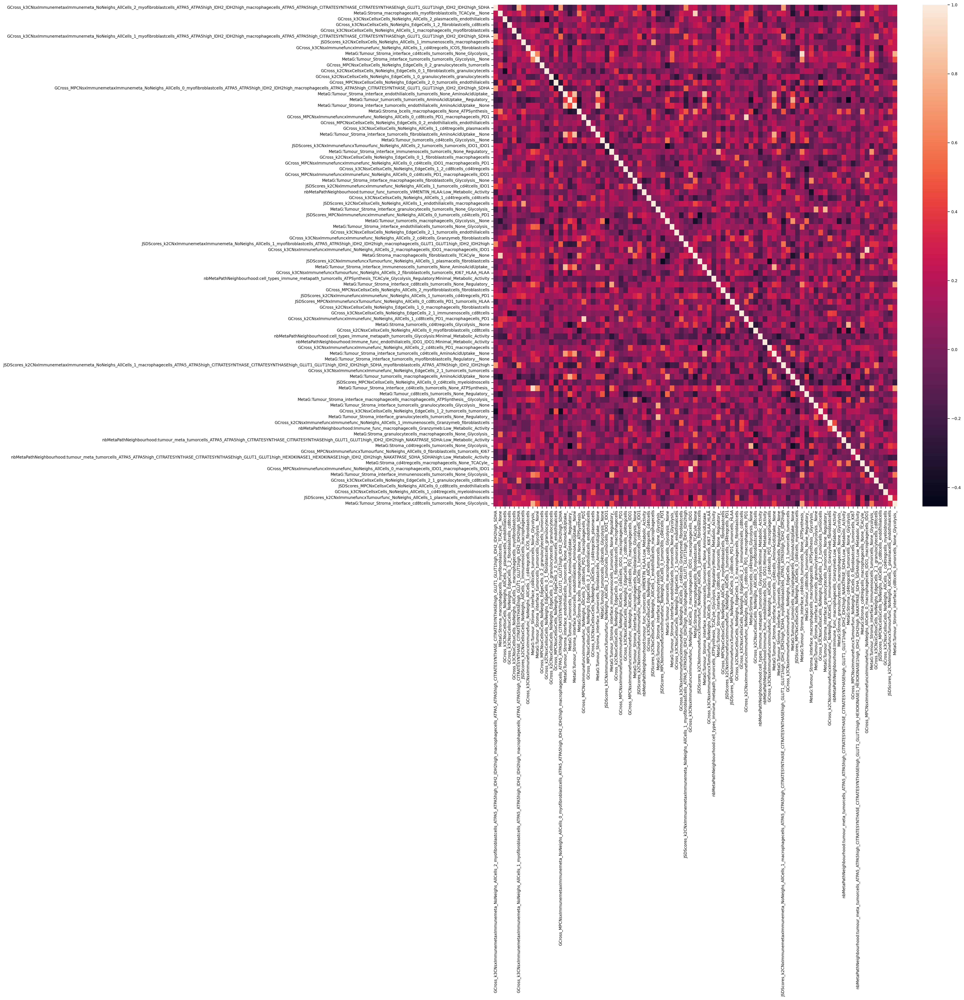

In [64]:
import seaborn as sns
sns.set_context("paper", rc={"font.size":5,"axes.titlesize":8,"axes.labelsize":5})   

plt.figure(figsize=(20,20))
sns.heatmap(_for_lifelines.loc[:,~_for_lifelines.columns.duplicated() & ~_for_lifelines.columns.str.contains('pfs')].corr())
#plt.savefig("correlation_plot_selected_features.svg")

In [65]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

def get_top_abs_correlations(df, n=5):
    au_corr = df.corr().abs().unstack()
    labels_to_drop = get_redundant_pairs(df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    return au_corr[0:n]

print("Top Absolute Correlations")
print([a[1] for a in get_top_abs_correlations(_for_lifelines, 10).index if 'pfs' not in a[0] and 'pfs' not in a[1]])

#_for_lifelines.loc[:,~_for_lifelines.columns.duplicated()].corr().unstack()

Top Absolute Correlations
['MetaG:Tumour_Stroma_interface_cd4tcells_tumorcells_None_ATPSynthesis_', 'GCross_MPCNsxImmunefuncxImmunefunc_NoNeighs_AllCells_0_macrophagecells_IDO1_macrophagecells_IDO1', 'GCross_k2CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_1_cd8tcells_PD1_macrophagecells_PD1', 'MetaG:Stroma_macrophagecells_fibroblastcells_TCACyle__None', 'MetaG:Tumour_Stroma_interface_tumorcells_fibroblastcells_AminoAcidUptake__None', 'MetaG:Tumour_Stroma_interface_tumorcells_endothilialcells_AminoAcidUptake__None', 'MetaG:Tumour_Stroma_interface_immunenoscells_tumorcells_None_AminoAcidUptake_', 'MetaG:Tumour_Stroma_interface_granulocytecells_tumorcells_None_Regulatory_', 'MetaG:Stroma_cd4tregcells_tumorcells_None_Glycolysis_', 'MetaG:Tumour_Stroma_interface_tumorcells_cd4tcells_AminoAcidUptake__None']


In [66]:
cph = CoxPHSurvivalAnalysis()

In [67]:
cph.fit(pre_X_all.loc[:,allSelectedFeatures], survival_array)

/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:449: LinAlgWarning: Ill-conditioned matrix (rcond=1.97104e-19): result may not be accurate.
  delta = solve(
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:449: LinAlgWarning: Ill-conditioned matrix (rcond=1.67513e-19): result may not be accurate.
  delta = solve(
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:449: LinAlgWarning: Ill-conditioned matrix (rcond=2.25849e-19): result may not be accurate.
  delta = solve(
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:449: LinAlgWarning: Ill-conditioned matrix (rcond=6.99954e-19): result may not be accurate.
  delta = solve(
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:449: LinAlgWarning: Ill-conditioned matrix (rcond=2.11444e-19): result may

CoxPHSurvivalAnalysis()

In [76]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import RepeatedKFold
from sksurv.linear_model import CoxPHSurvivalAnalysis
from sksurv.ensemble import GradientBoostingSurvivalAnalysis
from sksurv.metrics import cumulative_dynamic_auc
from scipy.interpolate import interp1d

def plot_survival_analysis_cv(df, y_os, y_pfs, n_splits=3):
    X = df.copy().loc[:, ~df.columns.duplicated()].reset_index(drop=True)

    overall_os_times  = np.arange(y_os['time'].min(),  y_os['time'].max(),  1)
    overall_pfs_times = np.arange(y_pfs['time'].min(), y_pfs['time'].max(), 1)
        
    '''import shap
    gb_model = GradientBoostingSurvivalAnalysis(learning_rate=0.5, n_estimators=100).fit(X, y_pfs)
    def predict_risk(X_):
        # This returns the partial hazard for each observation
        return gb_model.predict_partial_hazard(X_).values.flatten()
    explainer = shap.KernelExplainer(predict_risk, X)
    shap_values = explainer(X)
    
    ## visualize the first prediction's explanation
    shap.plots.waterfall(shap_values[0])
    plt.show()'''


    # Containers for OS results.
    cox_coefs_os = []
    auc_os_cox_list = []
    auc_os_gb_list = []
    auc_os_times = []

    avg_auc_cox_os_cv = []
    avg_auc_gb_os_cv = []
    
    kf_os = RepeatedKFold(n_splits=n_splits, n_repeats=10)
    for train_index, test_index in kf_os.split(X):
        X_train = X.iloc[train_index].reset_index(drop=True)
        X_test = X.iloc[test_index].reset_index(drop=True)
        y_train_os, y_test_os = y_os[train_index], y_os[test_index]

        # Define separate time grids based on each endpoint's range.
        time_os = np.arange(np.min(y_train_os["time"])+1, np.max(y_train_os["time"])-1, 1)
    
        # Train models for OS.
        if np.sum(y_train_os['event']) > 0:
            cox_model = CoxPHSurvivalAnalysis(tol=1e-8, alpha=0.1).fit(X_train, y_train_os)
            gb_model = GradientBoostingSurvivalAnalysis(learning_rate=0.5, n_estimators=100).fit(X_train, y_train_os)

            risk_score_cox = cox_model.predict(X_test)
            risk_score_gb = gb_model.predict(X_test)

            cox_coefs_os.append(cox_model.coef_)

            auc_times = np.arange(y_test_os['time'].min()+1, y_test_os['time'].max()-1, 1)

            try:
                auc_cox, avg_coef_os = cumulative_dynamic_auc(y_train_os, y_test_os, risk_score_cox, auc_times)
                auc_gb, avg_coef_os_gb  = cumulative_dynamic_auc(y_train_os, y_test_os, risk_score_gb, auc_times)
                auc_os_cox_list.append(auc_cox)
                auc_os_gb_list.append(auc_gb)
                auc_os_times.append(auc_times)
                
                interp = interp1d(auc_times, auc_gb, bounds_error=False)
                avg_auc_gb_os_cv.append(interp(overall_os_times))
                interp = interp1d(auc_times, auc_cox, bounds_error=False)
                avg_auc_cox_os_cv.append(interp(overall_os_times))
            
            except Exception as e:
                print("Error computing AUC for OS:", e)
                
    hr_os = np.nanmean(np.row_stack(cox_coefs_os), axis=0)
    se_os = np.nanstd(np.row_stack(cox_coefs_os), axis=0)
    ci_lower_os = hr_os - 1.96 * se_os
    ci_upper_os = hr_os + 1.96 * se_os
    
    
    X = df.copy().loc[:, ~df.columns.duplicated()].reset_index(drop=True)
        
    # Containers for OS results.
    cox_coefs_pfs = []
    auc_pfs_cox_list = []
    auc_pfs_gb_list = []

    avg_auc_cox_pfs_cv = []
    avg_auc_gb_pfs_cv = []
    
    kf_pfs = RepeatedKFold(n_splits=n_splits, n_repeats=10)
    for train_index, test_index in kf_pfs.split(X):
        X_train = X.iloc[train_index].reset_index(drop=True)
        X_test = X.iloc[test_index].reset_index(drop=True)
        y_train_pfs, y_test_pfs = y_pfs[train_index], y_pfs[test_index]

        # Define separate time grids based on each endpoint's range.
        time_pfs = np.arange(np.min(y_train_pfs["time"])+1, np.max(y_train_pfs["time"])-1, 1)
    
        # Train models for PFS.
        if np.sum(y_train_pfs['event']) > 0:
            cox_model = CoxPHSurvivalAnalysis(tol=1e-8, alpha=0.1).fit(X_train, y_train_pfs)
            gb_model = GradientBoostingSurvivalAnalysis(learning_rate=0.5, n_estimators=100).fit(X_train, y_train_pfs)

            risk_score_cox = cox_model.predict(X_test)
            risk_score_gb = gb_model.predict(X_test)

            cox_coefs_pfs.append(cox_model.coef_)

            auc_times = np.arange(y_test_pfs['time'].min()+1, y_test_pfs['time'].max()-1, 1)

            try:
                auc_cox, avg_coef_pfs = cumulative_dynamic_auc(y_train_pfs, y_test_pfs, risk_score_cox, auc_times)
                auc_gb, avg_coef_pfs_avg  = cumulative_dynamic_auc(y_train_pfs, y_test_pfs, risk_score_gb, auc_times)
                auc_pfs_cox_list.append(auc_cox)
                auc_pfs_gb_list.append(auc_gb)

                interp = interp1d(auc_times, auc_gb, bounds_error=False)
                avg_auc_gb_pfs_cv.append(interp(overall_pfs_times))
                interp = interp1d(auc_times, auc_cox, bounds_error=False)
                avg_auc_cox_pfs_cv.append(interp(overall_pfs_times))
                
            except Exception as e:
                print("Error computing AUC for PFS:", e)

    hr_pfs = np.nanmean(np.row_stack(cox_coefs_pfs), axis=0)
    se_pfs = np.nanstd(np.row_stack(cox_coefs_pfs), axis=0)
    ci_lower_pfs = hr_pfs - 1.96 * se_pfs
    ci_upper_pfs = hr_pfs + 1.96 * se_pfs
    
    '''fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(14, 15))
    y_pos = np.arange(len(X.columns))   
    features = list(X.columns)
    y_pos = np.arange(len(features))
    axes[0,0].errorbar(hr_os, y_pos, 
                       xerr=[hr_os - ci_lower_os, ci_upper_os - hr_os], 
                       fmt='o', color='black', ecolor='gray', capsize=5)
    axes[0,0].axvline(1.0, color="red", linestyle="--")
    axes[0,0].set_title("Cox Hazard Ratios for OS")
    axes[0,0].set_xlabel("Hazard Ratio")
    axes[0,0].set_yticks(y_pos)
    axes[0,0].set_yticklabels(features)
    axes[0,0].grid(True)'''
    # Compute sorted indices based on hr_os
    sorted_idx = np.argsort(hr_os)
    
    # Sort hazard ratios and confidence intervals
    hr_os_sorted = hr_os[sorted_idx]
    ci_lower_os_sorted = ci_lower_os[sorted_idx]
    ci_upper_os_sorted = ci_upper_os[sorted_idx]
    
    # Sort the feature names
    features = list(X.columns)
    features_sorted = [features[i] for i in sorted_idx]
    
    # Create new y positions
    y_pos = np.arange(len(features_sorted))
    df_measures_os = pd.DataFrame({'feature': features_sorted, 'HR': hr_os_sorted, 'HR_low': ci_lower_os_sorted, 'HR_high': ci_upper_os_sorted})

    # Plot the sorted hazard ratios
    fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(14, 15))
    axes[0,0].errorbar(hr_os_sorted, y_pos, 
                xerr=[hr_os_sorted - ci_lower_os_sorted, ci_upper_os_sorted - hr_os_sorted],
                fmt='o', color='black', ecolor='gray', capsize=5)
    axes[0,0].axvline(1.0, color="red", linestyle="--")
    axes[0,0].set_title("Cox Hazard Ratios for OS (Sorted)")
    axes[0,0].set_xlabel("Hazard Ratio")
    axes[0,0].set_yticks(y_pos)
    axes[0,0].set_yticklabels(features_sorted)
    axes[0,0].grid(True)
    axes[0,0].tick_params(axis='both', which='major', labelsize=4)


    # Compute sorted indices based on hr_os
    sorted_idx = np.argsort(hr_pfs)
    
    # Sort hazard ratios and confidence intervals
    hr_pfs_sorted = hr_pfs[sorted_idx]
    ci_lower_pfs_sorted = ci_lower_pfs[sorted_idx]
    ci_upper_pfs_sorted = ci_upper_pfs[sorted_idx]
    
    # Sort the feature names
    features = list(X.columns)
    features_sorted = [features[i] for i in sorted_idx]
    
    # Create new y positions
    y_pos = np.arange(len(features_sorted))
    df_measures_pfs = pd.DataFrame({'feature': features_sorted, 'HR': hr_pfs_sorted, 'HR_low': ci_lower_pfs_sorted, 'HR_high': ci_upper_pfs_sorted})

    
    axes[0,1].errorbar(hr_pfs_sorted, y_pos, 
                xerr=[hr_pfs_sorted - ci_lower_pfs_sorted, ci_upper_pfs_sorted - hr_pfs_sorted],
                fmt='o', color='black', ecolor='gray', capsize=5)
    axes[0,1].axvline(1.0, color="red", linestyle="--")
    axes[0,1].set_title("Cox Hazard Ratios for PFS")
    axes[0,1].set_xlabel("Hazard Ratio")
    axes[0,1].set_yticks(y_pos)
    axes[0,1].set_yticklabels(features_sorted)
    # Move y-axis tick labels to the right.
    axes[0,1].yaxis.tick_right()
    axes[0,1].yaxis.set_label_position("right")
    axes[0,1].grid(True)
    axes[0,1].tick_params(axis='both', which='major', labelsize=4)

    
    
    # Time-dependent AUC for OS.
    axes[1,0].plot(overall_os_times, np.nanmean(avg_auc_cox_os_cv, axis=0), color='k', label="Cox AUC", lw=2)
    axes[1,0].plot(overall_os_times, np.nanmean(avg_auc_gb_os_cv, axis=0), color='b', label="Boosted AUC", lw=2, linestyle="--")
    axes[1,0].axhline(np.nanmean(avg_auc_cox_os_cv), color="k", linestyle="--")
    axes[1,0].axhline(np.nanmean(avg_auc_gb_os_cv), color="b", linestyle="--")
    axes[1,0].set_title("Time-dependent AUC for OS")
    axes[1,0].set_xlabel("Time")
    axes[1,0].set_ylabel("AUC")
    axes[1,0].legend()
    axes[1,0].grid(True)
    
    # Time-dependent AUC for PFS.
    axes[1,1].plot(overall_pfs_times, np.nanmean(avg_auc_cox_pfs_cv, axis=0), color='k', label="Cox AUC", lw=2)
    axes[1,1].plot(overall_pfs_times, np.nanmean(avg_auc_gb_pfs_cv, axis=0), color='b', label="Boosted AUC", lw=2, linestyle="--")
    axes[1,1].axhline(np.nanmean(avg_auc_cox_pfs_cv), color="k", linestyle="--")
    axes[1,1].axhline(np.nanmean(avg_auc_gb_pfs_cv), color="b", linestyle="--")
    axes[1,1].set_title("Time-dependent AUC for PFS")
    axes[1,1].set_xlabel("Time")
    axes[1,1].set_ylabel("AUC")
    axes[1,1].legend()
    axes[1,1].grid(True)
    
    plt.tight_layout()
    #plt.savefig("stabl_selected_features_with_AUC_boostedCox.svg")
    plt.show()

    return df_measures_pfs, df_measures_os

In [77]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.model_selection import RepeatedKFold
from sksurv.linear_model import CoxPHSurvivalAnalysis
from sksurv.ensemble import GradientBoostingSurvivalAnalysis
from sksurv.metrics import cumulative_dynamic_auc
from scipy.interpolate import interp1d
from lifelines import KaplanMeierFitter
from lifelines.statistics import logrank_test

def plot_survival_analysis_cv(df, y_os, y_pfs, n_splits=3):
    X = df.copy().loc[:, ~df.columns.duplicated()].reset_index(drop=True)

    overall_os_times  = np.arange(y_os['time'].min(),  y_os['time'].max(),  1)
    overall_pfs_times = np.arange(y_pfs['time'].min(), y_pfs['time'].max(), 1)
        
    '''import shap
    gb_model = GradientBoostingSurvivalAnalysis(learning_rate=0.5, n_estimators=100).fit(X, y_pfs)
    def predict_risk(X_):
        # This returns the partial hazard for each observation
        return gb_model.predict_partial_hazard(X_).values.flatten()
    explainer = shap.KernelExplainer(predict_risk, X)
    shap_values = explainer(X)
    
    ## visualize the first prediction's explanation
    shap.plots.waterfall(shap_values[0])
    plt.show()'''

    # Containers for OS results.
    cox_coefs_os = []
    auc_os_cox_list = []
    auc_os_gb_list = []
    auc_os_times = []

    avg_auc_cox_os_cv = []
    avg_auc_gb_os_cv = []
    
    kf_os = RepeatedKFold(n_splits=n_splits, n_repeats=10)
    for train_index, test_index in kf_os.split(X):
        X_train = X.iloc[train_index].reset_index(drop=True)
        X_test = X.iloc[test_index].reset_index(drop=True)
        y_train_os, y_test_os = y_os[train_index], y_os[test_index]

        # Define a time grid based on training data.
        time_os = np.arange(np.min(y_train_os["time"])+1, np.max(y_train_os["time"])-1, 1)
    
        # Train models for OS.
        if np.sum(y_train_os['event']) > 0:
            cox_model = CoxPHSurvivalAnalysis(tol=1e-8, alpha=0.1).fit(X_train, y_train_os)
            gb_model = GradientBoostingSurvivalAnalysis(learning_rate=0.5, n_estimators=100).fit(X_train, y_train_os)

            risk_score_cox = cox_model.predict(X_test)
            risk_score_gb = gb_model.predict(X_test)

            cox_coefs_os.append(cox_model.coef_)

            auc_times = np.arange(y_test_os['time'].min()+1, y_test_os['time'].max()-1, 1)

            try:
                auc_cox, avg_coef_os = cumulative_dynamic_auc(y_train_os, y_test_os, risk_score_cox, auc_times)
                auc_gb, avg_coef_os_gb  = cumulative_dynamic_auc(y_train_os, y_test_os, risk_score_gb, auc_times)
                auc_os_cox_list.append(auc_cox)
                auc_os_gb_list.append(auc_gb)
                auc_os_times.append(auc_times)
                
                interp = interp1d(auc_times, auc_gb, bounds_error=False)
                avg_auc_gb_os_cv.append(interp(overall_os_times))
                interp = interp1d(auc_times, auc_cox, bounds_error=False)
                avg_auc_cox_os_cv.append(interp(overall_os_times))
            
            except Exception as e:
                print("Error computing AUC for OS:", e)
                
    hr_os = np.nanmean(np.row_stack(cox_coefs_os), axis=0)
    se_os = np.nanstd(np.row_stack(cox_coefs_os), axis=0)
    ci_lower_os = hr_os - 1.96 * se_os
    ci_upper_os = hr_os + 1.96 * se_os
    
    
    X = df.copy().loc[:, ~df.columns.duplicated()].reset_index(drop=True)
        
    # Containers for PFS results.
    cox_coefs_pfs = []
    auc_pfs_cox_list = []
    auc_pfs_gb_list = []

    avg_auc_cox_pfs_cv = []
    avg_auc_gb_pfs_cv = []
    
    kf_pfs = RepeatedKFold(n_splits=n_splits, n_repeats=20)
    for train_index, test_index in kf_pfs.split(X):
        X_train = X.iloc[train_index].reset_index(drop=True)
        X_test = X.iloc[test_index].reset_index(drop=True)
        y_train_pfs, y_test_pfs = y_pfs[train_index], y_pfs[test_index]

        # Define a time grid based on training data.
        time_pfs = np.arange(np.min(y_train_pfs["time"])+1, np.max(y_train_pfs["time"])-1, 1)
    
        # Train models for PFS.
        if np.sum(y_train_pfs['event']) > 0:
            cox_model = CoxPHSurvivalAnalysis(tol=1e-8, alpha=0.1).fit(X_train, y_train_pfs)
            gb_model = GradientBoostingSurvivalAnalysis(learning_rate=0.5, n_estimators=100).fit(X_train, y_train_pfs)

            risk_score_cox = cox_model.predict(X_test)
            risk_score_gb = gb_model.predict(X_test)

            cox_coefs_pfs.append(cox_model.coef_)

            auc_times = np.arange(y_test_pfs['time'].min()+1, y_test_pfs['time'].max()-1, 1)

            try:
                auc_cox, avg_coef_pfs = cumulative_dynamic_auc(y_train_pfs, y_test_pfs, risk_score_cox, auc_times)
                auc_gb, avg_coef_pfs_avg  = cumulative_dynamic_auc(y_train_pfs, y_test_pfs, risk_score_gb, auc_times)
                auc_pfs_cox_list.append(auc_cox)
                auc_pfs_gb_list.append(auc_gb)

                interp = interp1d(auc_times, auc_gb, bounds_error=False)
                avg_auc_gb_pfs_cv.append(interp(overall_pfs_times))
                interp = interp1d(auc_times, auc_cox, bounds_error=False)
                avg_auc_cox_pfs_cv.append(interp(overall_pfs_times))
                
            except Exception as e:
                print("Error computing AUC for PFS:", e)

    hr_pfs = np.nanmean(np.row_stack(cox_coefs_pfs), axis=0)
    se_pfs = np.nanstd(np.row_stack(cox_coefs_pfs), axis=0)
    ci_lower_pfs = hr_pfs - 1.96 * se_pfs
    ci_upper_pfs = hr_pfs + 1.96 * se_pfs
    
    # Compute sorted indices based on hr_os for OS.
    sorted_idx = np.argsort(hr_os)
    
    # Sort hazard ratios and confidence intervals.
    hr_os_sorted = hr_os[sorted_idx]
    ci_lower_os_sorted = ci_lower_os[sorted_idx]
    ci_upper_os_sorted = ci_upper_os[sorted_idx]
    
    # Sort the feature names.
    features = list(X.columns)
    features_sorted = [features[i] for i in sorted_idx]
    
    # Create new y positions.
    y_pos = np.arange(len(features_sorted))
    df_measures_os = pd.DataFrame({'feature': features_sorted, 'HR': hr_os_sorted, 
                                   'HR_low': ci_lower_os_sorted, 'HR_high': ci_upper_os_sorted})

    # Plot the sorted hazard ratios for OS.
    fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(14, 15), gridspec_kw={'height_ratios': [3, 1]})
    axes[0,0].errorbar(hr_os_sorted, y_pos, 
                xerr=[hr_os_sorted - ci_lower_os_sorted, ci_upper_os_sorted - hr_os_sorted],
                fmt='o', color='black', ecolor='gray', capsize=5)
    axes[0,0].axvline(0.0, color="red", linestyle="--")
    axes[0,0].set_title("Cox Hazard Ratios for OS (Sorted)")
    axes[0,0].set_xlabel("Hazard Ratio")
    axes[0,0].set_yticks(y_pos)
    axes[0,0].set_yticklabels(features_sorted)
    axes[0,0].tick_params(axis='both', which='major', labelsize=4)

    # Compute sorted indices based on hr_pfs for PFS.
    sorted_idx = np.argsort(hr_pfs)
    
    # Sort hazard ratios and confidence intervals.
    hr_pfs_sorted = hr_pfs[sorted_idx]
    ci_lower_pfs_sorted = ci_lower_pfs[sorted_idx]
    ci_upper_pfs_sorted = ci_upper_pfs[sorted_idx]
    
    features = list(X.columns)
    features_sorted = [features[i] for i in sorted_idx]
    
    y_pos = np.arange(len(features_sorted))
    df_measures_pfs = pd.DataFrame({'feature': features_sorted, 'HR': hr_pfs_sorted, 
                                    'HR_low': ci_lower_pfs_sorted, 'HR_high': ci_upper_pfs_sorted})
    
    axes[0,1].errorbar(hr_pfs_sorted, y_pos, 
                xerr=[hr_pfs_sorted - ci_lower_pfs_sorted, ci_upper_pfs_sorted - hr_pfs_sorted],
                fmt='o', color='black', ecolor='gray', capsize=5)
    axes[0,1].axvline(0.0, color="red", linestyle="--")
    axes[0,1].set_title("Cox Hazard Ratios for PFS")
    axes[0,1].set_xlabel("Hazard Ratio")
    axes[0,1].set_yticks(y_pos)
    axes[0,1].set_yticklabels(features_sorted)
    axes[0,1].yaxis.tick_right()
    axes[0,1].yaxis.set_label_position("right")
    axes[0,1].tick_params(axis='both', which='major', labelsize=4)

    # Time-dependent AUC for OS.
    axes[1,0].plot(overall_os_times, np.nanmean(avg_auc_cox_os_cv, axis=0), color='k', label="Cox AUC", lw=2)
    axes[1,0].fill_between(overall_os_times, np.nanmean(avg_auc_cox_os_cv, axis=0) - np.nanstd(avg_auc_cox_os_cv, axis=0), np.nanmean(avg_auc_cox_os_cv, axis=0) + np.nanstd(avg_auc_cox_os_cv, axis=0), color='k', alpha=0.2)
    axes[1,0].plot(overall_os_times, np.nanmean(avg_auc_gb_os_cv, axis=0), color='b', label="Boosted AUC", lw=2, linestyle="--")
    axes[1,0].fill_between(overall_os_times, np.nanmean(avg_auc_gb_os_cv, axis=0) - np.nanstd(avg_auc_gb_os_cv, axis=0), np.nanmean(avg_auc_gb_os_cv, axis=0) + np.nanstd(avg_auc_gb_os_cv, axis=0), color='b', alpha=0.2)
    axes[1,0].axhline(np.nanmean(avg_auc_cox_os_cv), color="k", linestyle="--")
    axes[1,0].axhline(np.nanmean(avg_auc_gb_os_cv), color="b", linestyle="--")
    axes[1,0].set_title("Time-dependent AUC for OS")
    axes[1,0].set_xlabel("Time")
    axes[1,0].set_ylabel("AUC")
    axes[1,0].legend()
    
    # Time-dependent AUC for PFS.
    axes[1,1].plot(overall_pfs_times, np.nanmean(avg_auc_cox_pfs_cv, axis=0), color='k', label="Cox AUC", lw=2)
    axes[1,1].fill_between(overall_pfs_times, np.nanmean(avg_auc_cox_pfs_cv, axis=0) - np.nanstd(avg_auc_cox_pfs_cv, axis=0), np.nanmean(avg_auc_cox_pfs_cv, axis=0) + np.nanstd(avg_auc_cox_pfs_cv, axis=0), color='k', alpha=0.2)
    axes[1,1].plot(overall_pfs_times, np.nanmean(avg_auc_gb_pfs_cv, axis=0), color='b', label="Boosted AUC", lw=2, linestyle="--")
    axes[1,1].fill_between(overall_pfs_times, np.nanmean(avg_auc_gb_pfs_cv, axis=0) - np.nanstd(avg_auc_gb_pfs_cv, axis=0), np.nanmean(avg_auc_gb_pfs_cv, axis=0) + np.nanstd(avg_auc_gb_pfs_cv, axis=0), color='b', alpha=0.2)
    axes[1,1].axhline(np.nanmean(avg_auc_cox_pfs_cv), color="k", linestyle="--")
    axes[1,1].axhline(np.nanmean(avg_auc_gb_pfs_cv), color="b", linestyle="--")
    axes[1,1].set_title("Time-dependent AUC for PFS")
    axes[1,1].set_xlabel("Time")
    axes[1,1].set_ylabel("AUC")
    axes[1,1].legend()
    plt.tight_layout()
    #plt.savefig("stabl_selected_features_with_AUC_boostedCox.svg")
    plt.show()

    significant_features = []
    pvals = {}
    for feature in X.columns:
        median_val = X[feature].mean()
        group_high = X[feature] > median_val
        group_low = X[feature] <= median_val
        
        durations_high = y_pfs['time'][group_high]
        events_high = y_pfs['event'][group_high]
        durations_low = y_pfs['time'][group_low]
        events_low = y_pfs['event'][group_low]
        
        try:
            results = logrank_test(durations_high, durations_low,
                                   event_observed_A=events_high,
                                   event_observed_B=events_low)
            if results.p_value < 0.05:
                significant_features.append(feature)
                pvals[feature] = results.p_value
        except Exception as e:
            print(f"Error in logrank test for feature {feature}: {e}")

    if significant_features:
        n_features = len(significant_features)
        ncols = 3
        nrows = (n_features + ncols - 1) // ncols 
        fig_km, axes_km = plt.subplots(nrows, ncols, figsize=(ncols*6, nrows*4))
        axes_km = np.array(axes_km).reshape(-1)  
        for i, feature in enumerate(significant_features):
            median_val = X[feature].mean()
            group_high = X[feature] > median_val
            group_low = X[feature] <= median_val
            
            kmf_high = KaplanMeierFitter()
            kmf_low = KaplanMeierFitter()
            
            kmf_high.fit(durations=y_pfs['time'][group_high],
                         event_observed=y_pfs['event'][group_high],
                         label=f"High")
            kmf_low.fit(durations=y_pfs['time'][group_low],
                        event_observed=y_pfs['event'][group_low],
                        label=f"Low")
            
            ax = axes_km[i]
            kmf_high.plot(ax=ax, ci_show=True)
            kmf_low.plot(ax=ax, ci_show=True)
            ax.set_title(f"{feature} (p={pvals[feature]:.3f})")
            ax.set_xlabel("Time")
            ax.set_ylabel("Survival Probability")
        for j in range(i+1, len(axes_km)):
            axes_km[j].set_visible(False)
        plt.tight_layout()
        #plt.savefig("km_significant_features_pfs.svg")
        plt.show()
    else:
        print("No statistically significant features found based on log-rank test for OS.")

    
    significant_features = []
    pvals = {}
    for feature in X.columns:
        median_val = X[feature].mean()
        group_high = X[feature] > median_val
        group_low = X[feature] <= median_val
        
        durations_high = y_os['time'][group_high]
        events_high = y_os['event'][group_high]
        durations_low = y_os['time'][group_low]
        events_low = y_os['event'][group_low]
        
        try:
            results = logrank_test(durations_high, durations_low,
                                   event_observed_A=events_high,
                                   event_observed_B=events_low)
            if results.p_value < 0.05:
                significant_features.append(feature)
                pvals[feature] = results.p_value
        except Exception as e:
            print(f"Error in logrank test for feature {feature}: {e}")

    if significant_features:
        n_features = len(significant_features)
        ncols = 3
        nrows = (n_features + ncols - 1) // ncols  
        fig_km, axes_km = plt.subplots(nrows, ncols, figsize=(ncols*6, nrows*4))
        axes_km = np.array(axes_km).reshape(-1) 
        for i, feature in enumerate(significant_features):
            median_val = X[feature].mean()
            group_high = X[feature] > median_val
            group_low = X[feature] <= median_val
            
            kmf_high = KaplanMeierFitter()
            kmf_low = KaplanMeierFitter()
            
            kmf_high.fit(durations=y_os['time'][group_high],
                         event_observed=y_os['event'][group_high],
                         label=f"High")
            kmf_low.fit(durations=y_os['time'][group_low],
                        event_observed=y_os['event'][group_low],
                        label=f"Low")
            
            ax = axes_km[i]
            kmf_high.plot(ax=ax, ci_show=True)
            kmf_low.plot(ax=ax, ci_show=True)
            ax.set_title(f"{feature} (p={pvals[feature]:.3f})")
            ax.set_xlabel("Time")
            ax.set_ylabel("Survival Probability")
        for j in range(i+1, len(axes_km)):
            axes_km[j].set_visible(False)
        plt.tight_layout()
        #plt.savefig("km_significant_features_os.svg")
        plt.show()
    else:
        print("No statistically significant features found based on log-rank test for OS.")
        
    return df_measures_pfs, df_measures_os


In [70]:
def get_pvalues(df, features, ):
    featuresanalysize, p_values = [], []
    for i, feature in enumerate(features):
        print(feature)
        median = df[feature].mean()
        feature_encoded = (df[feature] > median).astype(int)
        unique_values = ['Below Mean', 'Above Mean']
        
        group_times = []
        group_events = []
        group_types = []
        
        for j, group_name in enumerate(unique_values):
            group_mask = feature_encoded == j

            time, survival_prob, conf_int = kaplan_meier_estimator(
                    survival_array[group_mask]['event'], 
                    survival_array[group_mask]['time'], 
                    conf_type='log-log'
            )
                
            group_times .extend(survival_array[group_mask]['time'])
            group_events.extend(survival_array[group_mask]['event'])
            group_types .extend([j for _ in range(len(survival_array[group_mask]['event']))])

        if len(group_times) > 1:
            dtype = [('event', bool), ('time', float)]
            structured_array = np.array(list(zip(group_events, group_times)), dtype=dtype)

            featuresanalysize.append(feature)
            p_values.append(compare_survival(structured_array, group_types)[1])
    return featuresanalysize, p_values

Error computing AUC for OS: censoring survival function is zero at one or more time points


/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))


Error computing AUC for OS: censoring survival function is zero at one or more time points
Error computing AUC for OS: censoring survival function is zero at one or more time points


/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))


Error computing AUC for OS: censoring survival function is zero at one or more time points
Error computing AUC for OS: censoring survival function is zero at one or more time points


/tmp/ipykernel_407462/3216947134.py:75: ConvergenceWarning: Optimization did not converge: Maximum number of iterations has been exceeded.
  cox_model = CoxPHSurvivalAnalysis(tol=1e-8, alpha=0.1).fit(X_train, y_train_os)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:81: RuntimeWarning: divide by zero encountered in divide
  y = np.cumsum(n_events / divisor)


Error computing AUC for OS: censoring survival function is zero at one or more time points
Error computing AUC for OS: censoring survival function is zero at one or more time points


/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))


Error computing AUC for OS: censoring survival function is zero at one or more time points
Error computing AUC for OS: censoring survival function is zero at one or more time points


/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))
/tmp/ipykernel_407462/3216947134.py:75: ConvergenceWarning: Optimization did not converge: Maximum number of iterations has been exceeded.
  cox_model = CoxPHSurvivalAnalysis(tol=1e-8, alpha=0.1).fit(X_train, y_train_os)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:81: RuntimeWarning: divide by zero encountered in divide
  y = np.cumsum(n_events / divisor)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))


Error computing AUC for OS: censoring survival function is zero at one or more time points


/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))
/tmp/ipykernel_407462/3216947134.py:100: DeprecationWarning: `row_stack` alias is deprecated. Use `np.vstack` directly.
  hr_os = np.nanmean(np.row_stack(cox_coefs_os), axis=0)
/tmp/ipykernel_407462/3216947134.py:101: DeprecationWarning: `row_stack` alias is deprecated. Use `np.vstack` directly.
  se_os = np.nanstd(np.row_stack(cox_coefs_os), axis=0)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))
/tmp/ipykernel_407462/3216947134.py:127: ConvergenceWarning: Optimization did not converge: Maximum number of iterations has been exceeded.
  cox_model = CoxPHSurvivalAnalysis(tol=1e-8, alpha=0.1).fit(X_train, y_train_pfs)
/h

Error computing AUC for PFS: censoring survival function is zero at one or more time points


/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))


Error computing AUC for PFS: censoring survival function is zero at one or more time points
Error computing AUC for PFS: censoring survival function is zero at one or more time points


/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))


Error computing AUC for PFS: censoring survival function is zero at one or more time points


/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_survival_ = StepFunction(uniq_times, np.exp(-y))
/tmp/ipykernel_407462/3216947134.py:127: ConvergenceWarning: Optimization did not converge: Maximum number of iterations has been exceeded.
  cox_model = CoxPHSurvivalAnalysis(tol=1e-8, alpha=0.1).fit(X_train, y_train_pfs)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:81: RuntimeWarning: divide by zero encountered in divide
  y = np.cumsum(n_events / divisor)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/sksurv/linear_model/coxph.py:83: RuntimeWarning: overflow encountered in exp
  self.baseline_su

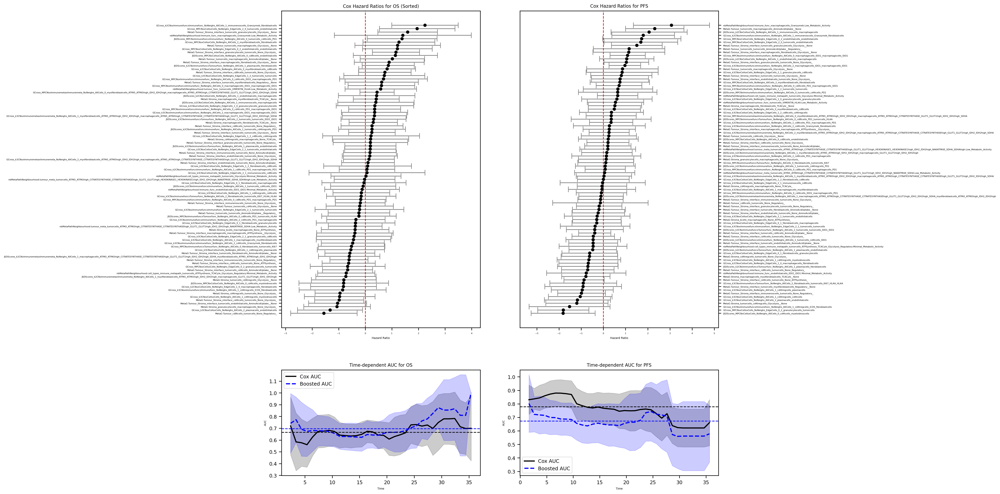

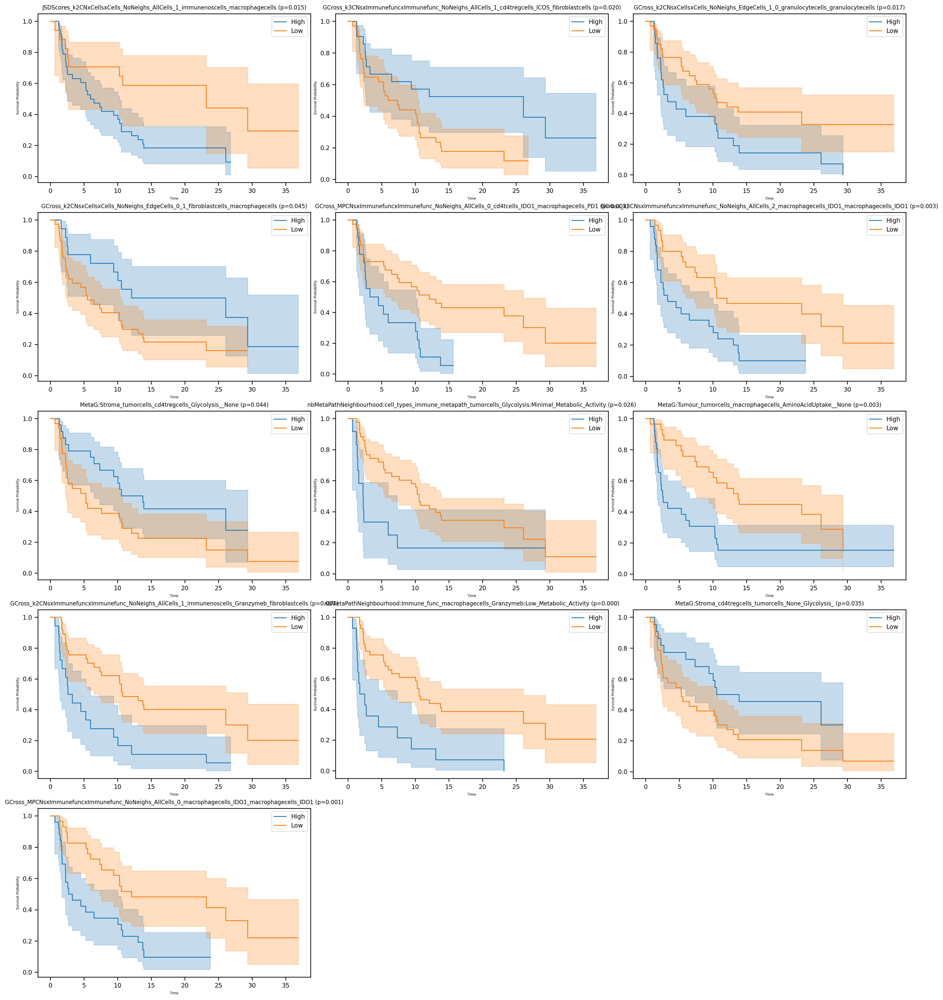

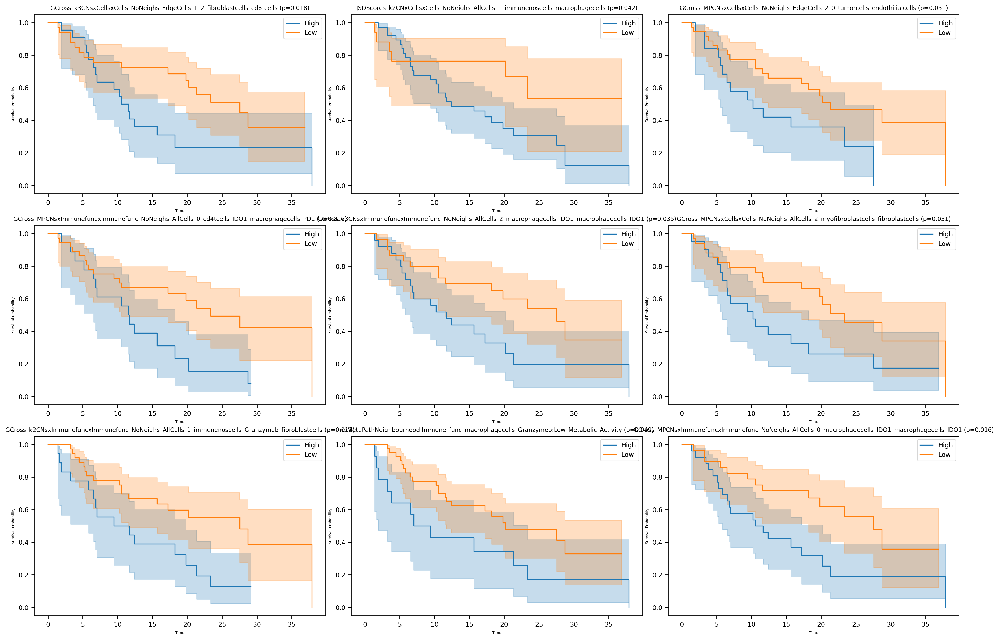

In [71]:
df_measures_pfs, df_measures_os = plot_survival_analysis_cv(pre_X_all.loc[:,allSelectedFeatures], survival_array_OS, survival_array)

In [72]:
featuresLooked, pvals = get_pvalues(pre_X_all.loc[:,allSelectedFeatures], allSelectedFeatures)

GCross_k3CNsxImmunemetaxImmunemeta_NoNeighs_AllCells_2_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_SDHA
MetaG:Stroma_macrophagecells_myofibroblastcells_TCACyle__None
GCross_k3CNsxCellsxCells_NoNeighs_AllCells_2_plasmacells_endothilialcells
GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_1_2_fibroblastcells_cd8tcells
GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_macrophagecells_myofibroblastcells
GCross_k3CNsxImmunemetaxImmunemeta_NoNeighs_AllCells_1_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_SDHA
JSDScores_k2CNxCellsxCells_NoNeighs_AllCells_1_immunenoscells_macrophagecells
GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_1_cd4tregcells_ICOS_fibroblastcells
MetaG:Tumour_Stroma_interface_cd4tcells_tumorcells_None_Glycolysis_
MetaG:Tumour_Stroma_interface_tumorcells_tumorcells_Glycolysi

In [74]:
# Get Ratios
df_feature_pvals = pd.DataFrame({'feature': featuresLooked, 'pvals': pvals})
val_arr =  []
for a, b in zip(featuresLooked, pvals):
    #print(float(round(b, 5)), "    \t", a)
    if "jsd" in a:
        fillval = 1.0
    else:
        fillval = 0.0
    vals = X_raw.loc[y_all == 1.0, a].fillna(fillval).mean()/X_raw.loc[y_all == 0.0, a].fillna(fillval).mean()
    if type(vals) != np.float64:
        print(vals.iloc[0], "    \t", a)
        val_arr.append([vals.iloc[0], a, b])
    else:
        print(vals, "    \t", a)
        val_arr.append([vals, a, b])

2.1094737551557055     	 GCross_k3CNsxImmunemetaxImmunemeta_NoNeighs_AllCells_2_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_SDHA
0.8486961566067834     	 MetaG:Stroma_macrophagecells_myofibroblastcells_TCACyle__None
1.2366616113228175     	 GCross_k3CNsxCellsxCells_NoNeighs_AllCells_2_plasmacells_endothilialcells
0.5985987129595928     	 GCross_k3CNsxCellsxCells_NoNeighs_EdgeCells_1_2_fibroblastcells_cd8tcells
0.6335419965386411     	 GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_macrophagecells_myofibroblastcells
2.4229370185137764     	 GCross_k3CNsxImmunemetaxImmunemeta_NoNeighs_AllCells_1_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_SDHA
0.8097445005593521     	 JSDScores_k2CNxCellsxCells_NoNeighs_AllCells_1_immunenoscells_macrophagecells
1.8677876747485014     	 GCross_k3CNsxImmun

In [54]:
ordered_list = []
for substring in ['GCross_k2', 'GCross_k3', 'GCross_M', 'JSD', 'MetaG', 'nbMeta']:
    ordered_list.extend([val for val in val_arr if substring in val[1]])
ordered_list = [[float(a), b, float(c)] for a, b, c in ordered_list]

In [55]:
for o in ordered_list:
    print(round(o[0], 4), "\t\t", round(o[2], 4), "\t\t", o[1])

2.2305 		 0.7647 		 GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_0_1_fibroblastcells_granulocytecells
0.59 		 0.0169 		 GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_1_0_granulocytecells_granulocytecells
2.2556 		 0.045 		 GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_0_1_fibroblastcells_macrophagecells
1.948 		 0.3509 		 GCross_k2CNsxCellsxCells_NoNeighs_EdgeCells_1_0_macrophagecells_fibroblastcells
0.4058 		 0.2746 		 GCross_k2CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_1_cd8tcells_PD1_macrophagecells_PD1
0.4243 		 0.2566 		 GCross_k2CNsxCellsxCells_NoNeighs_AllCells_0_myofibroblastcells_cd8tcells
0.3655 		 0.0009 		 GCross_k2CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_1_immunenoscells_Granzymeb_fibroblastcells
2.1095 		 0.3956 		 GCross_k3CNsxImmunemetaxImmunemeta_NoNeighs_AllCells_2_myofibroblastcells_ATPA5_ATPA5high_IDH2_IDH2high_macrophagecells_ATPA5_ATPA5high_CITRATESYNTHASE_CITRATESYNTHASEhigh_GLUT1_GLUT1high_IDH2_IDH2high_SDHA
1.2367 		 0.6728 		 GCross_k3CNsxCellsxCells_NoNeighs_A

Error computing AUC for OS: censoring survival function is zero at one or more time points
Error computing AUC for OS: censoring survival function is zero at one or more time points
Error computing AUC for OS: censoring survival function is zero at one or more time points
Error computing AUC for OS: censoring survival function is zero at one or more time points
Error computing AUC for OS: censoring survival function is zero at one or more time points
Error computing AUC for OS: censoring survival function is zero at one or more time points
Error computing AUC for OS: censoring survival function is zero at one or more time points
Error computing AUC for OS: censoring survival function is zero at one or more time points
Error computing AUC for OS: censoring survival function is zero at one or more time points
Error computing AUC for OS: censoring survival function is zero at one or more time points
Error computing AUC for PFS: censoring survival function is zero at one or more time point

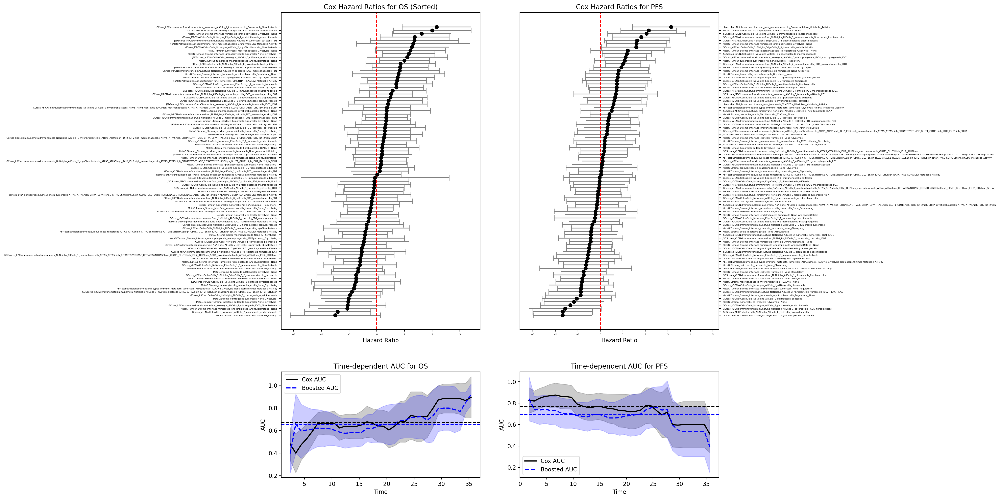

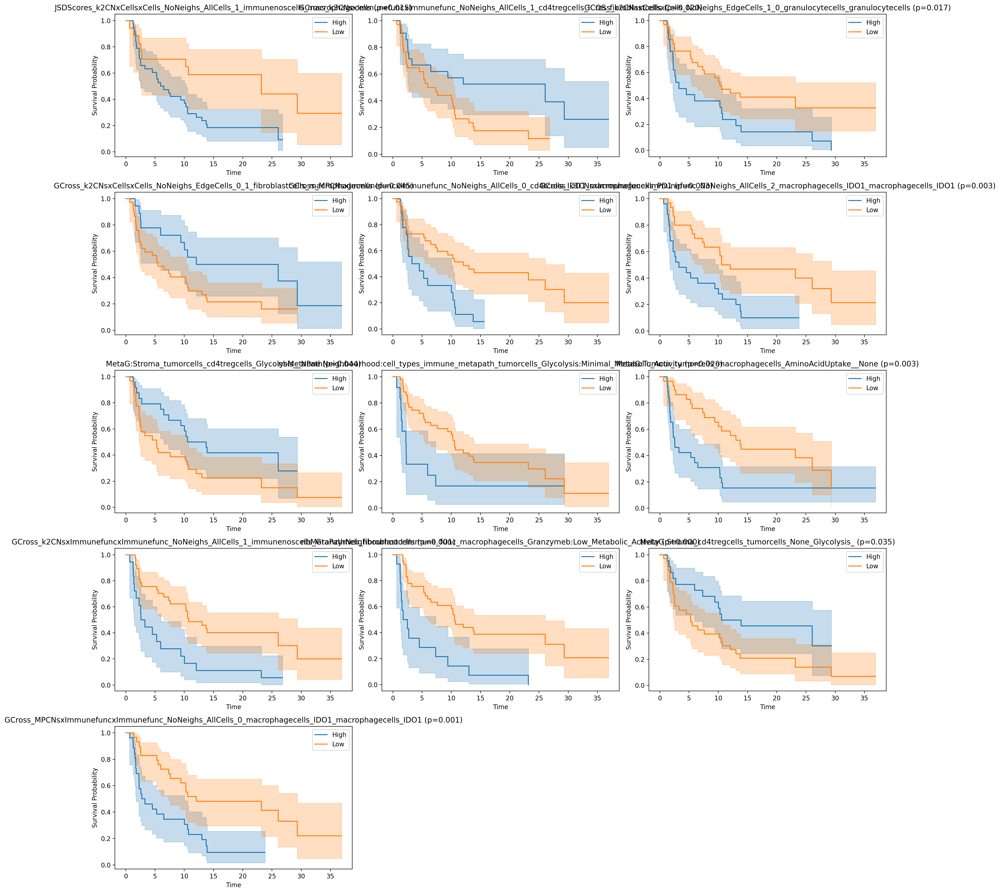

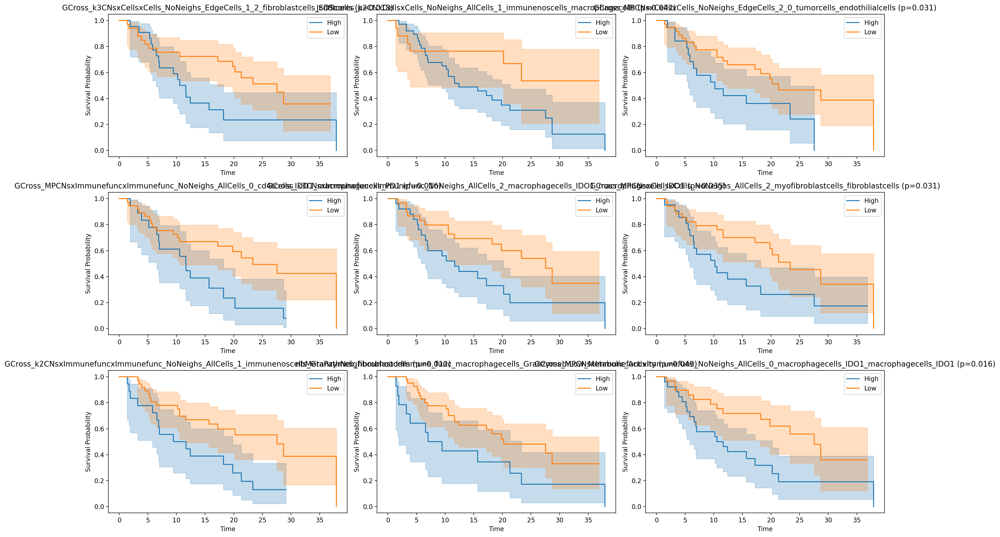

In [47]:
df_measures_pfs, df_measures_os = plot_survival_analysis_cv(pre_X_all.loc[:,allSelectedFeatures].copy(), survival_array_OS, survival_array)

# Compute Prognosis Score

In [48]:
df_measures_pfs

,feature,HR,HR_low,HR_high
0,GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_0_...,-1.680762,-2.986476,-0.375048
1,JSDScores_MPCNxCellsxCells_NoNeighs_AllCells_0...,-1.680103,-3.005209,-0.354997
2,GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_Al...,-1.568857,-3.173591,0.035876
3,GCross_k3CNsxCellsxCells_NoNeighs_AllCells_2_p...,-1.339109,-2.661760,-0.016457
4,MetaG:Stroma_tumorcells_cd4tregcells_Glycolysi...,-1.171411,-2.499365,0.156542
...,...,...,...,...
82,GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_0_...,1.632883,0.189163,3.076603
83,GCross_k2CNsxImmunefuncxImmunefunc_NoNeighs_Al...,1.814650,0.542474,3.086826
84,JSDScores_k2CNxCellsxCells_NoNeighs_AllCells_1...,2.045816,0.318211,3.773422
85,MetaG:Tumour_tumorcells_macrophagecells_AminoA...,2.144033,0.900338,3.387728


In [49]:
y_PFS

,pfs.T,pfs.E
22193,2.333333,1.0
22333,1.766667,1.0
24490,13.033334,1.0
28757,7.600000,1.0
29937,2.733333,1.0
31267,1.300000,1.0
31565,7.333334,1.0
31584,1.600000,1.0
31590,0.666667,1.0
32054,1.400000,1.0


Scores.shape:  (55,)
Scores.shape:  [ 14.07607932  19.35802821  -6.86032325  -1.00102772  10.16513326
  19.45025577  -1.86510472  16.74394547  28.3541097   19.34212962
  21.78535374  12.46469287   7.31270031  20.7763138    8.51638953
  11.92080949 -14.2339116  -13.53124332 -14.83716042   9.10031904
  14.90021695  -5.18877621   9.22569414  -4.38522181   4.2405006
 -10.51525287  -8.57122742 -11.64787757  -7.86100976  -0.85809841
 -17.81514444  15.81283642   3.37026339 -10.09571496  -8.93669654
   1.49636308 -12.14586504   2.87242559 -11.31015995 -21.16679296
  -9.95109444  -6.88447519 -26.56324206  -7.5699755    4.08862011
  -9.10627563  -9.97147655   9.36912107  11.32195611  -4.17659302
 -13.35643    -18.49848538   8.06876688  -8.88500595  -6.34336179]
(np.float64(64.64558511128675), np.float64(8.965695799108877e-16))


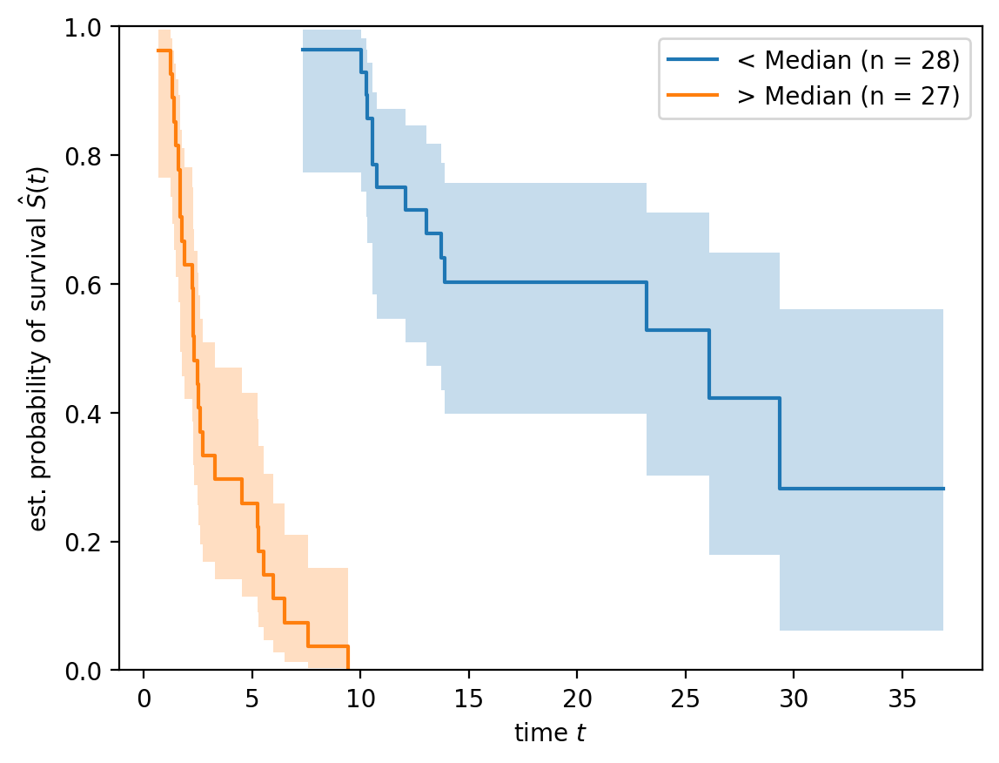

(np.float64(28.24407993488911), np.float64(1.069412069819089e-07))


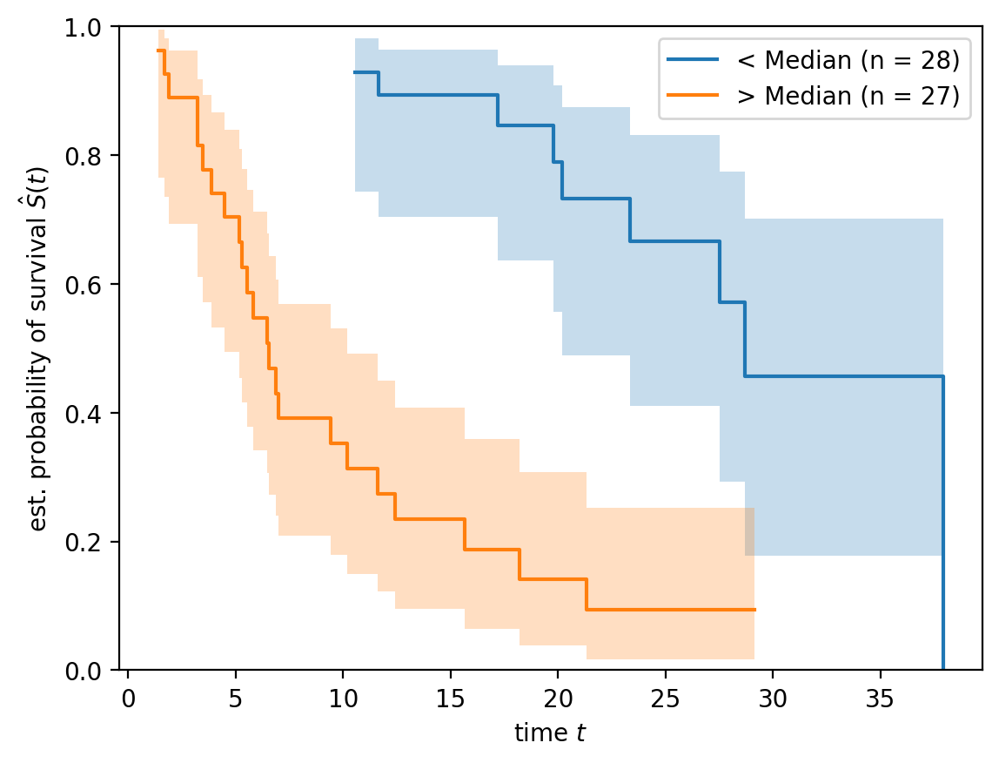

In [60]:
import sksurv
def prognosis(df_, y_pfs_, y_os_, df_HRs):
    scores = []
    for patient, values in df_.iterrows():
        score = 0
        for feature in df_HRs['feature']:
            if np.isnan(values[feature]*df_HRs[df_HRs['feature'] == feature]['HR'].values):
                print("feature: ", feature, "\tvalues: ", values[feature], "\tHR: ", df_HRs[df_HRs['feature'] == feature]['HR'])
            score += values[feature]*df_HRs[df_HRs['feature'] == feature]['HR'].values
        scores.append(score)
    scores = np.array(scores).flatten()
    print("Scores.shape: ", scores.shape)
    print("Scores.shape: ", scores)

    mask = (scores <= np.median(scores))
    time_cell, survival_prob_cell, conf_int = kaplan_meier_estimator(
        y_pfs_["pfs.E"][mask].astype(bool), y_pfs_["pfs.T"][mask], conf_type="log-log"
    )
    print(sksurv.compare.compare_survival(survival_array, mask))
                                    
    plt.step(time_cell, survival_prob_cell, where="post", label=f"< Median (n = {mask.sum()})")
    plt.fill_between(time_cell, conf_int[0], conf_int[1], alpha=0.25, step="post")

    
    time_cell, survival_prob_cell, conf_int = kaplan_meier_estimator(
        y_pfs_["pfs.E"][~mask].astype(bool), y_pfs_["pfs.T"][~mask], conf_type="log-log"
    )
    plt.step(time_cell, survival_prob_cell, where="post", label=f"> Median (n = {(~mask).sum()})")
    plt.fill_between(time_cell, conf_int[0], conf_int[1], alpha=0.25, step="post")

    
    plt.ylim(0, 1)
    plt.ylabel(r"est. probability of survival $\hat{S}(t)$")
    plt.xlabel("time $t$")
    plt.legend(loc="best")
    plt.savefig("prog_PFS.svg")
    plt.show()

    time_cell, survival_prob_cell, conf_int = kaplan_meier_estimator(
        y_os_["os.E"][mask].astype(bool), y_os_["os.T"][mask], conf_type="log-log"
    )
    print(sksurv.compare.compare_survival(survival_array_OS, mask))
    plt.step(time_cell, survival_prob_cell, where="post", label=f"< Median (n = {mask.sum()})")
    plt.fill_between(time_cell, conf_int[0], conf_int[1], alpha=0.25, step="post")

    
    time_cell, survival_prob_cell, conf_int = kaplan_meier_estimator(
        y_os_["os.E"][~mask].astype(bool), y_os_["os.T"][~mask], conf_type="log-log"
    )
    plt.step(time_cell, survival_prob_cell, where="post", label=f"> Median (n = {(~mask).sum()})")
    plt.fill_between(time_cell, conf_int[0], conf_int[1], alpha=0.25, step="post")

    
    plt.ylim(0, 1)
    plt.ylabel(r"est. probability of survival $\hat{S}(t)$")
    plt.xlabel("time $t$")
    plt.legend(loc="best")
    plt.savefig("prog_OS.svg")
    plt.show()

prognosis(pre_X_all.loc[:,allSelectedFeatures], y_PFS, y_OS, df_measures_pfs)

Scores.shape:  (55,)
Scores.shape:  [  3.90177471  17.11792247  -1.77976665 -13.62948844  14.4285554
  24.78783338  -8.77037987  20.27135637  19.30467319  14.71641938
   7.26323018  14.00204758   2.61001282  20.06524634   0.34617266
  19.30438108 -21.90387559  -7.48286449  -2.67673037   6.08675687
  -3.75632008   0.7921303    1.68517529   0.40350131  -1.66544748
  -2.48568609  -7.69659603  -1.78506201  -8.4544257   -0.1915887
   2.13663971  10.65279645   0.80727468  -8.82119469   2.79406689
   4.88644768  -9.44037137  13.57228023  -1.07444736 -22.55226428
 -10.63261986  -6.91209476 -23.24672316 -27.06484757   0.23059816
  -5.56289737 -24.13982693  10.9395595   -0.55656393  -3.9117427
  -2.54995063  -0.83912549  10.80871377 -11.10528912  -3.22737567]
(np.float64(34.67884767446942), np.float64(3.88833615505597e-09))
pfs log-rank:  (np.float64(34.67884767446942), np.float64(3.88833615505597e-09))


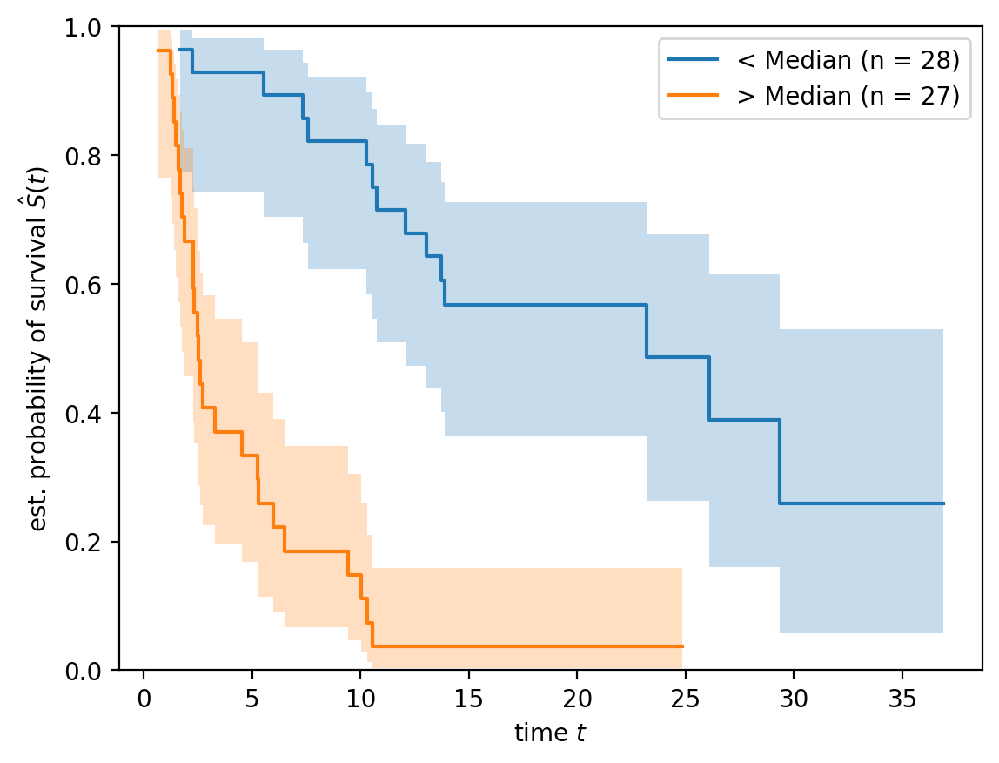

(np.float64(20.06407059904694), np.float64(7.489048742467056e-06))
os log-rank:  (np.float64(20.06407059904694), np.float64(7.489048742467056e-06))


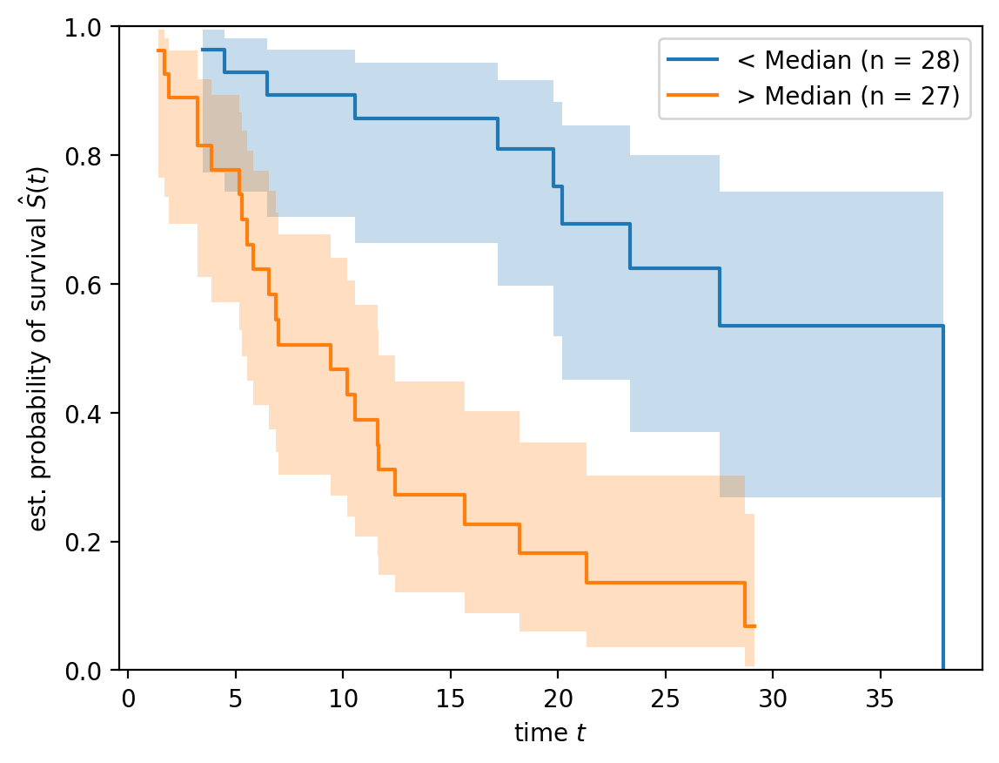

Scores.shape:  (55,)
Scores.shape:  [ 10.17430461   2.24010574  -5.0805566   12.62846072  -4.26342214
  -5.33757761   6.90527515  -3.52741091   9.04943651   4.62571024
  14.52212356  -1.53735471   4.70268749   0.71106746   8.17021687
  -7.3835716    7.66996399  -6.04837882 -12.16043005   3.01356217
  18.65653703  -5.98090652   7.54051886  -4.78872311   5.90594808
  -8.02956678  -0.8746314   -9.86281556   0.59341595  -0.66650972
 -19.95178415   5.16003997   2.56298871  -1.27452026 -11.73076342
  -3.3900846   -2.70549367 -10.69985464 -10.23571258   1.38547131
   0.68152542   0.02761957  -3.3165189   19.49487207   3.85802196
  -3.54337826  14.16835038  -1.57043843  11.87852004  -0.26485032
 -10.80647937 -17.6593599   -2.73994688   2.22028317  -3.11598611]
(np.float64(5.785133642510864), np.float64(0.016162269069427342))
pfs log-rank:  (np.float64(5.785133642510864), np.float64(0.016162269069427342))


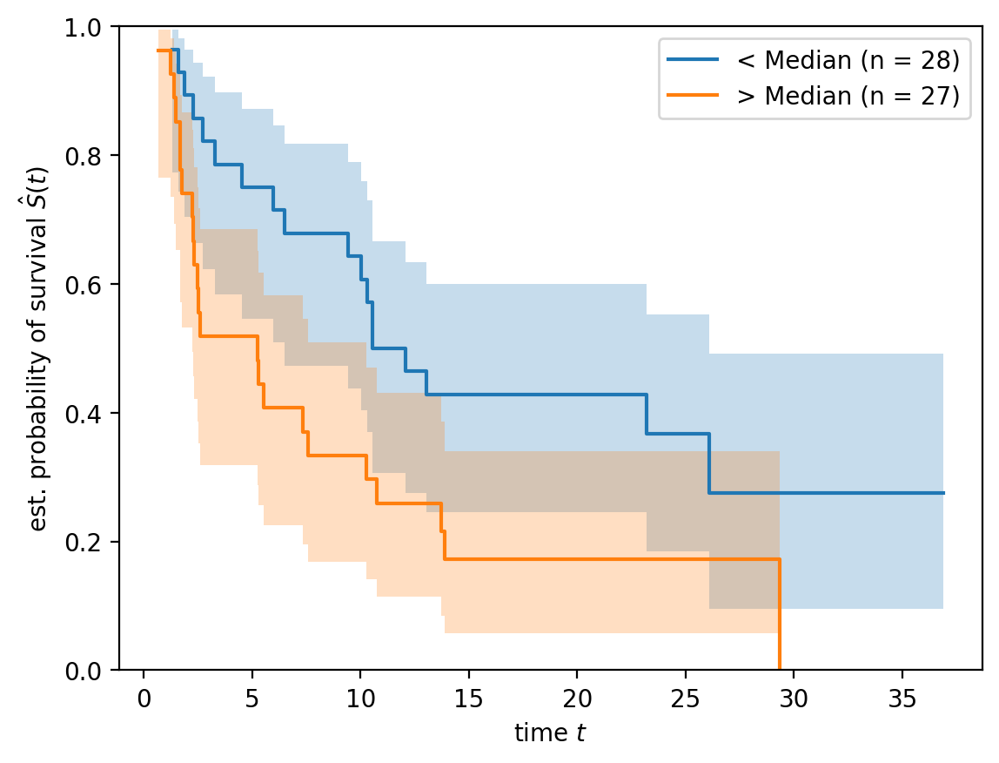

(np.float64(0.6975663858628761), np.float64(0.40360263406083985))
os log-rank:  (np.float64(0.6975663858628761), np.float64(0.40360263406083985))


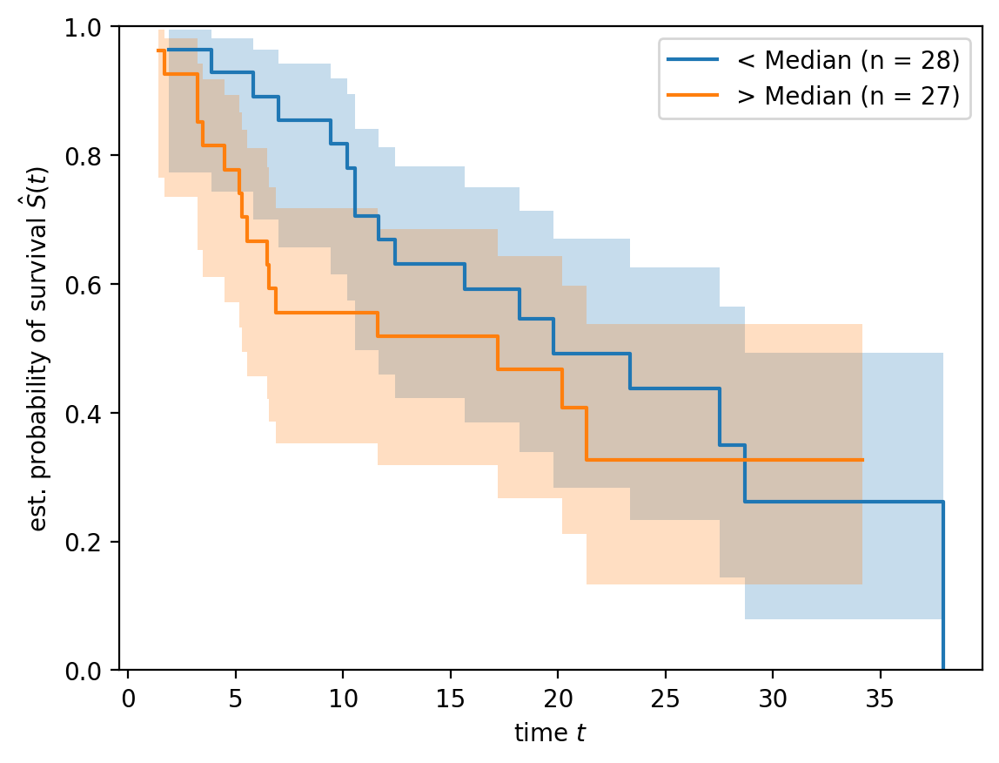

In [62]:
import sksurv
def prognosis_pos_neg(df_, y_pfs_, y_os_, df_HRs, pos=True):
    scores = []
    for patient, values in df_.iterrows():
        score = 0
        for feature in df_HRs['feature']:
            if np.isnan(values[feature]*df_HRs[df_HRs['feature'] == feature]['HR'].values):
                print("feature: ", feature, "\tvalues: ", values[feature], "\tHR: ", df_HRs[df_HRs['feature'] == feature]['HR'])
            if pos == True:
                if df_HRs[df_HRs['feature'] == feature]['HR'].values > 0:
                    score += values[feature]*df_HRs[df_HRs['feature'] == feature]['HR'].values
            else:
                if df_HRs[df_HRs['feature'] == feature]['HR'].values <= 0:
                    score += values[feature]*df_HRs[df_HRs['feature'] == feature]['HR'].values
                    
        scores.append(score)
    scores = np.array(scores).flatten()
    print("Scores.shape: ", scores.shape)
    print("Scores.shape: ", scores)

    mask = (scores <= np.median(scores))
    time_cell, survival_prob_cell, conf_int = kaplan_meier_estimator(
        y_pfs_["pfs.E"][mask].astype(bool), y_pfs_["pfs.T"][mask], conf_type="log-log"
    )
    print(sksurv.compare.compare_survival(survival_array, mask))
    plt.step(time_cell, survival_prob_cell, where="post", label=f"< Median (n = {mask.sum()})")
    plt.fill_between(time_cell, conf_int[0], conf_int[1], alpha=0.25, step="post")

    
    time_cell, survival_prob_cell, conf_int = kaplan_meier_estimator(
        y_pfs_["pfs.E"][~mask].astype(bool), y_pfs_["pfs.T"][~mask], conf_type="log-log"
    )
    plt.step(time_cell, survival_prob_cell, where="post", label=f"> Median (n = {(~mask).sum()})")
    plt.fill_between(time_cell, conf_int[0], conf_int[1], alpha=0.25, step="post")

    print("pfs log-rank: ", compare_survival(sksurv.util.Surv().from_dataframe('pfs.E', 'pfs.T', y_pfs_), mask, return_stats=False))

    
    plt.ylim(0, 1)
    plt.ylabel(r"est. probability of survival $\hat{S}(t)$")
    plt.xlabel("time $t$")
    plt.legend(loc="best")
    if pos == True:
        plt.savefig("prog_PFS_pos.svg")
    else:
        plt.savefig("prog_PFS_neg.svg")
    plt.show()

    time_cell, survival_prob_cell, conf_int = kaplan_meier_estimator(
        y_os_["os.E"][mask].astype(bool), y_os_["os.T"][mask], conf_type="log-log"
    )
    print(sksurv.compare.compare_survival(survival_array_OS, mask))
    plt.step(time_cell, survival_prob_cell, where="post", label=f"< Median (n = {mask.sum()})")
    plt.fill_between(time_cell, conf_int[0], conf_int[1], alpha=0.25, step="post")

    
    time_cell, survival_prob_cell, conf_int = kaplan_meier_estimator(
        y_os_["os.E"][~mask].astype(bool), y_os_["os.T"][~mask], conf_type="log-log"
    )
    plt.step(time_cell, survival_prob_cell, where="post", label=f"> Median (n = {(~mask).sum()})")
    plt.fill_between(time_cell, conf_int[0], conf_int[1], alpha=0.25, step="post")

    print("os log-rank: ", compare_survival(sksurv.util.Surv().from_dataframe('os.E', 'os.T', y_os_), mask, return_stats=False))

    plt.ylim(0, 1)
    plt.ylabel(r"est. probability of survival $\hat{S}(t)$")
    plt.xlabel("time $t$")
    plt.legend(loc="best")
    if pos == True:
        plt.savefig("prog_OS_pos.svg")
    else:
        plt.savefig("prog_OS_neg.svg")
    plt.show()

prognosis_pos_neg(pre_X_all.loc[:,allSelectedFeatures], y_PFS, y_OS, df_measures_pfs)
prognosis_pos_neg(pre_X_all.loc[:,allSelectedFeatures], y_PFS, y_OS, df_measures_pfs, pos=False)

# Forest Plot

In [1035]:
#Xt = pre_X_all.loc[:,allSelectedFeatures].copy().loc[:,~pre_X_all.loc[:,allSelectedFeatures].columns.duplicated()].reset_index(drop=True).drop([ind[1] for ind, a in zip(get_top_abs_correlations(X_train, 10).index,  get_top_abs_correlations(X_train, 10)) if 'os.' not in ind[0] and 'pfs.' not in ind[0] and 'os.' not in ind[1] and 'pfs.' not in ind[1] and abs(a) > 0.99], axis=1)

In [1036]:
import forestplot as fp

In [1037]:
def maplabels(x):
    if 'nbMeta' in x and 'mmune_func' in x:
        return 'Metapathneighourhood:immune_func'
    elif 'nbMeta' in x and 'mmune_meta' in x:
        return 'Metapathneighourhood:immune_meta'
    elif 'nbMeta' in x and 'immune_metapath' in x:
        return 'Metapathneighourhood:cell_types_immune_metapath'
    if 'nbMeta' in x and 'umour_func' in x:
        return 'Metapathneighourhood:tumour_func'
    elif 'nbMeta' in x and 'umour_meta' in x:
        return 'Metapathneighourhood:tumour_meta'
    elif 'JSD' in x:
        return 'JSD'
    elif 'GCross' in x:
        return 'GCross'
    elif 'MetaG' in x:
        return 'Metabolic GCross'
    elif 'nbnb' in x:
        return 'Cell Proprtions in CNs'
    else:
        return 'other'

In [1038]:
df_measures_pfs_withPVals = pd.merge(df_measures_pfs, df_feature_pvals, left_on='feature', right_on='feature')
df_measures_pfs_withPVals

,feature,HR,HR_low,HR_high,pvals
0,GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_0_...,-1.849264,-2.936367,-0.762161,0.445730
1,JSDScores_MPCNxCellsxCells_NoNeighs_AllCells_0...,-1.761761,-3.318247,-0.205276,0.713922
2,GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_Al...,-1.557263,-3.210372,0.095845,0.020013
3,GCross_k3CNsxCellsxCells_NoNeighs_AllCells_2_p...,-1.244917,-2.567297,0.077463,0.672771
4,GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_c...,-1.135113,-2.709236,0.439010,0.075024
...,...,...,...,...,...
82,GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_2_...,1.667491,-0.230371,3.565353,0.377598
83,GCross_k2CNsxImmunefuncxImmunefunc_NoNeighs_Al...,1.889693,0.492196,3.287190,0.000899
84,JSDScores_k2CNxCellsxCells_NoNeighs_AllCells_1...,2.114056,0.682360,3.545751,0.015207
85,MetaG:Tumour_tumorcells_macrophagecells_AminoA...,2.224657,0.672005,3.777308,0.002815


In [1039]:
df_measures_pfs_withPVals['group'] = [maplabels(a) for a in df_measures_pfs_withPVals['feature']]

In [1043]:
df_measures_pfs_withPVals

,feature,HR,HR_low,HR_high,pvals,group
0,GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_0_...,-1.849264,-2.936367,-0.762161,0.445730,GCross
1,JSDScores_MPCNxCellsxCells_NoNeighs_AllCells_0...,-1.761761,-3.318247,-0.205276,0.713922,JSD
2,GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_Al...,-1.557263,-3.210372,0.095845,0.020013,GCross
3,GCross_k3CNsxCellsxCells_NoNeighs_AllCells_2_p...,-1.244917,-2.567297,0.077463,0.672771,GCross
4,GCross_k3CNsxCellsxCells_NoNeighs_AllCells_1_c...,-1.135113,-2.709236,0.439010,0.075024,GCross
...,...,...,...,...,...,...
82,GCross_MPCNsxCellsxCells_NoNeighs_EdgeCells_2_...,1.667491,-0.230371,3.565353,0.377598,GCross
83,GCross_k2CNsxImmunefuncxImmunefunc_NoNeighs_Al...,1.889693,0.492196,3.287190,0.000899,GCross
84,JSDScores_k2CNxCellsxCells_NoNeighs_AllCells_1...,2.114056,0.682360,3.545751,0.015207,JSD
85,MetaG:Tumour_tumorcells_macrophagecells_AminoA...,2.224657,0.672005,3.777308,0.002815,Metabolic GCross


In [1047]:
df_measures_pfs_withPVals[~df_measures_pfs_withPVals['group'].isin(['JSD', 'GCross', 'Metabolic GCross'])]

,feature,HR,HR_low,HR_high,pvals,group
12,nbMetaPathNeighbourhood:Immune_func_endothilia...,-0.726722,-1.995338,0.541894,0.200225,Metapathneighourhood:immune_func
20,nbMetaPathNeighbourhood:cell_types_immune_meta...,-0.510860,-2.119202,1.097483,0.986252,Metapathneighourhood:immune_meta
40,nbMetaPathNeighbourhood:tumour_meta_tumorcells...,-0.037865,-1.522030,1.446300,0.642980,Metapathneighourhood:tumour_meta
52,nbMetaPathNeighbourhood:tumour_meta_tumorcells...,0.215986,-0.928912,1.360885,0.888817,Metapathneighourhood:tumour_meta
62,nbMetaPathNeighbourhood:tumour_func_tumorcells...,0.567865,-0.702466,1.838197,0.159568,Metapathneighourhood:tumour_func
65,nbMetaPathNeighbourhood:cell_types_immune_meta...,0.676347,-0.349485,1.702178,0.025941,Metapathneighourhood:immune_meta
86,nbMetaPathNeighbourhood:Immune_func_macrophage...,3.180057,1.536778,4.823336,0.000051,Metapathneighourhood:immune_func


<Figure size 640x480 with 0 Axes>

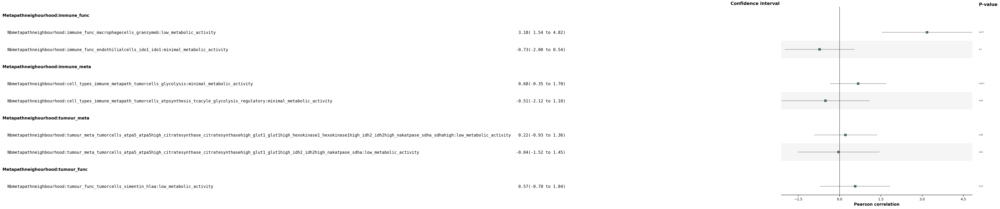

In [1055]:
#df_measures_pfs = pd.merge(df_measures_pfs, df_feature_pvals, left_on='feature', right_on='feature')

plt.figure()
fp.forestplot(df_measures_pfs_withPVals[~df_measures_pfs_withPVals['group'].isin(['JSD', 'GCross', 'Metabolic GCross'])],  # the dataframe with results data
              estimate="HR",  # col containing estimated effect size 
              ll="HR_low", hl="HR_high",  # columns containing conf. int. lower and higher limits
              varlabel="feature",  # column containing variable label
              ylabel="Confidence interval",  # y-label title
              xlabel="Pearson correlation",  # x-label title
              pval='pvals',
              sort=True,
              capitalize="capitalize",  # Capitalize labels
              groupvar="group",  # Add variable groupings 
              figsize=(10,10),
              group_order=['Metapathneighourhood:immune_func', 'Metapathneighourhood:immune_meta', 'Metapathneighourhood:tumour_meta',
                           'Metapathneighourhood:tumour_func'],
              color_alt_rows="True"
              )
plt.savefig('forestplot.svg')

<Figure size 3000x2000 with 0 Axes>

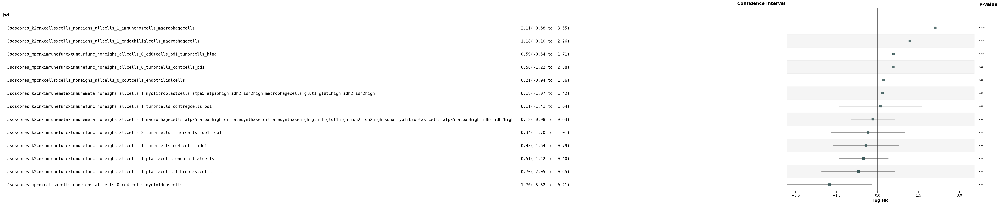

In [1082]:
plt.figure(figsize=(30, 20))
fp.forestplot(df_measures_pfs_withPVals[df_measures_pfs_withPVals['group'].isin(['JSD'])],  # the dataframe with results data
              estimate="HR",  # col containing estimated effect size 
              ll="HR_low", hl="HR_high",  # columns containing conf. int. lower and higher limits
              varlabel="feature",  # column containing variable label
              ylabel="Confidence interval",  # y-label title
              xlabel="log HR",  # x-label title
              capitalize="capitalize",  # Capitalize labels
              groupvar="group",  # Add variable groupings 
              figsize=(10,10),
              pval='pvals',
              sort=True,
              group_order=['JSD'],
              color_alt_rows="True"
              )
plt.savefig('forestplot2.svg')

<Figure size 3000x2000 with 0 Axes>

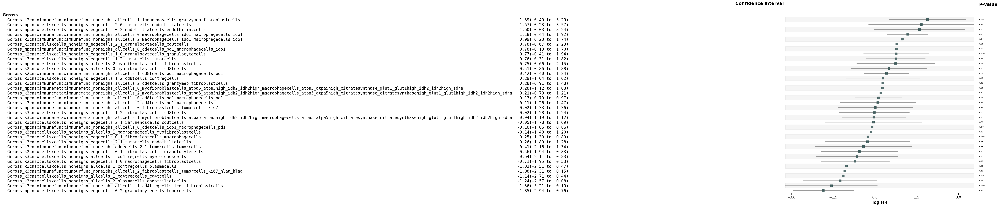

In [1081]:
plt.figure(figsize=(30, 20))
fp.forestplot(df_measures_pfs_withPVals[df_measures_pfs_withPVals['group'].isin(['GCross'])],  # the dataframe with results data
              estimate="HR",  # col containing estimated effect size 
              ll="HR_low", hl="HR_high",  # columns containing conf. int. lower and higher limits
              varlabel="feature",  # column containing variable label
              ylabel="Confidence interval",  # y-label title
              xlabel="log HR",  # x-label title
              capitalize="capitalize",  # Capitalize labels
              groupvar="group",  # Add variable groupings 
              figsize=(10,10),
              pval='pvals',
              sort=True,
              group_order=['GCross'],
              color_alt_rows="True"
              )
plt.savefig('forestplot4.svg')

<Figure size 640x480 with 0 Axes>

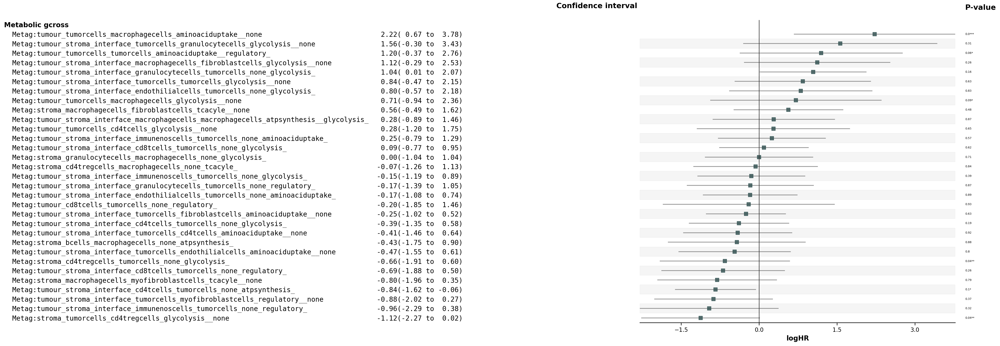

In [1078]:
plt.figure()
fp.forestplot(df_measures_pfs_withPVals[df_measures_pfs_withPVals['group'].isin(['Metabolic GCross'])],  # the dataframe with results data
              estimate="HR",  # col containing estimated effect size 
              ll="HR_low", hl="HR_high",  # columns containing conf. int. lower and higher limits
              varlabel="feature",  # column containing variable label
              ylabel="Confidence interval",  # y-label title
              xlabel="logHR",  # x-label title
              capitalize="capitalize",  # Capitalize labels
              groupvar="group",  # Add variable groupings 
              figsize=(10,10),
              pval='pvals',
              sort=True,
              #group_order=['JSD', 'GCross'],
              color_alt_rows="True"
              )
plt.savefig('forestplot3.svg')

# Survival Plots

In [1073]:
fig = plot_survival_curves(pd.concat([X_all.loc[:,~X_all.columns.duplicated()], y_PFS], axis=1), allSelectedFeatures, time_column='pfs.T', event_column='pfs.E', n_cols=4)
plt.savefig("selected_features_survival_curve_PFS.svg")
plt.show()

In [1074]:
[a for a in allSelectedFeatures if 'Granz' in a]

['GCross_k3CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_2_cd4tcells_Granzymeb_fibroblastcells',
 'GCross_k2CNsxImmunefuncxImmunefunc_NoNeighs_AllCells_1_immunenoscells_Granzymeb_fibroblastcells',
 'nbMetaPathNeighbourhood:Immune_func_macrophagecells_Granzymeb:Low_Metabolic_Activity']

In [1076]:
fig = plot_survival_curves(pd.concat([X_all.loc[:,~X_all.columns.duplicated()], y_OS], axis=1), allSelectedFeatures, time_column='os.T', event_column='os.E', n_cols=4)
plt.savefig("selected_features_survival_curve_OS.svg")
plt.show()

# Feature logFC

In [16]:
import seaborn as sns

In [20]:
y_CB6  = X_raw['CB6'].copy()#.reset_index(drop=True).copy()
y_OR   = X_raw['OR'].copy() #.reset_index(drop=True).copy()

<Axes: >

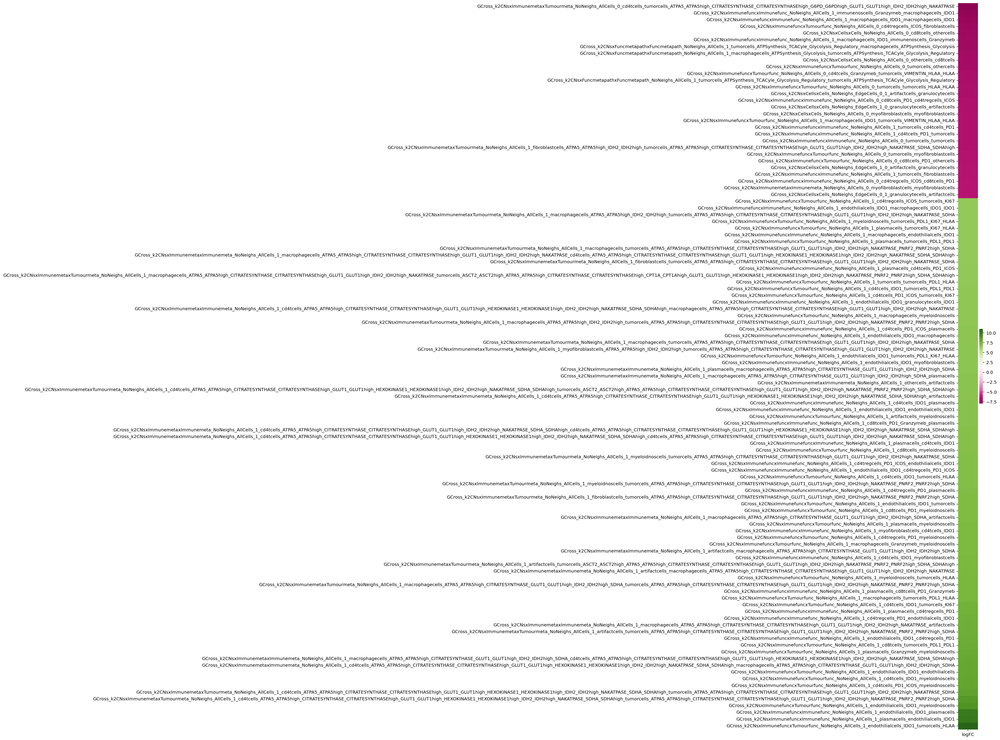

In [31]:
tempdf = X_raw.loc[:,X_raw.columns.str.contains('GCross_k2')]
tempdf = np.log2(tempdf + 1e-5)
plt.figure(figsize=(1,30))
plotdf = pd.DataFrame({"logFC": tempdf.loc[y_CB6[y_CB6 == 1.0].dropna().index,:].mean(0) - tempdf.loc[y_CB6[y_CB6 == 0.0].dropna().index,:].mean(0)})
plotdf = plotdf.sort_values(by='logFC')
sns.heatmap(plotdf[plotdf.logFC.abs() > 6.5], cmap='PiYG')

<Axes: >

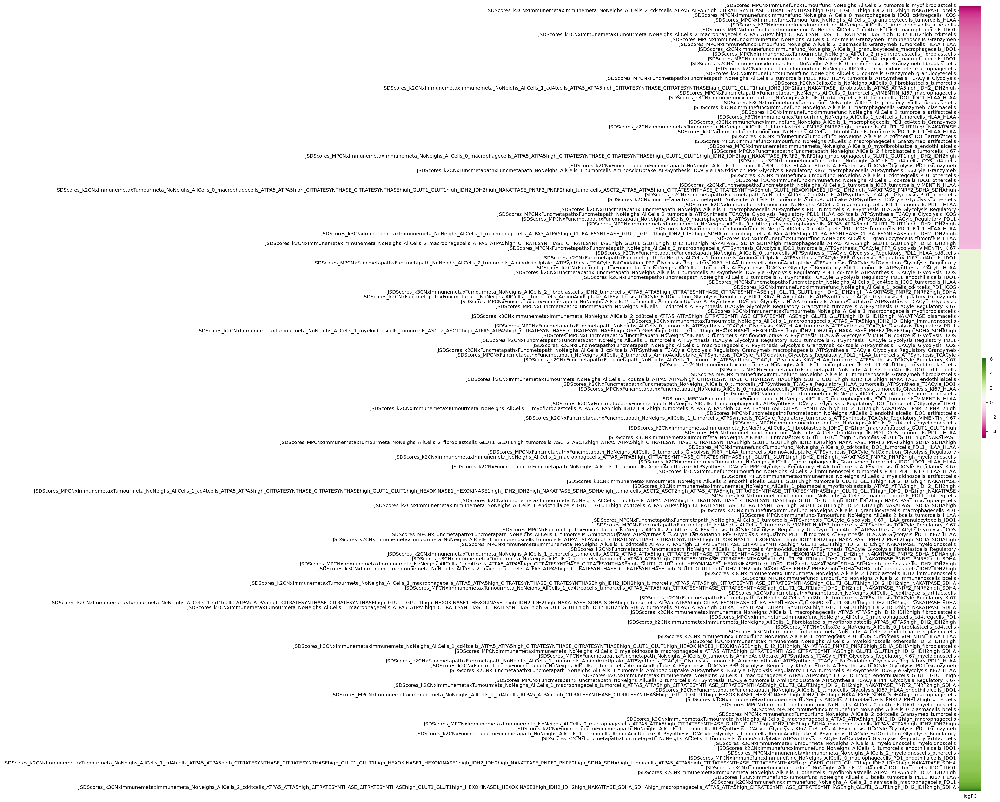

In [33]:
tempdf = X_raw.loc[:,X_raw.columns.str.contains('JSD')]
tempdf = np.log2(tempdf + 1e-5)
plt.figure(figsize=(1,30))
plotdf = pd.DataFrame({"logFC": tempdf.loc[y_CB6[y_CB6 == 1.0].dropna().index,:].mean(0) - tempdf.loc[y_CB6[y_CB6 == 0.0].dropna().index,:].mean(0)})
plotdf = plotdf.sort_values(by='logFC')
sns.heatmap(plotdf[plotdf.logFC.abs() > 1.5], cmap='PiYG')

In [ ]:
tempdf = X_raw.loc[:,X_raw.columns.str.contains('GCross_k3') & X_raw.columns.str.contains('CellsxCells')  & X_raw.columns.str.contains('_0_') & X_raw.columns.str.contains('AllCells')]
tempdf = np.log2(tempdf + 1e-5)
plt.figure(figsize=(1,30))
plotdf = pd.DataFrame({"logFC": tempdf.loc[y_CB6[y_CB6 == 1.0].dropna().index,:].mean(0) - tempdf.loc[y_CB6[y_CB6 == 0.0].dropna().index,:].mean(0)})
plotdf = plotdf.sort_values(by='logFC')
sns.heatmap(plotdf[plotdf.logFC.abs() > -1.0], cmap='PiYG')
plt.savefig('logFC_topFeatures_univariate.svg')

In [78]:
# Extract the last two parts from the index by splitting the string on '_'
plotdf['cell_type_1'] = plotdf.index.str.split('cells_').str[-2]
plotdf['cell_type_2'] = plotdf.index.str.split('cells_').str[-1]
plotdf = plotdf[~plotdf['cell_type_1'].isin(['othercells', 'artifactcells']) & ~plotdf['cell_type_2'].isin(['othercells', 'artifactcells'])]

In [79]:
plotdf

,logFC,cell_type_1,cell_type_2
JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_AllCells_0_tumorcells_myofibroblastcells,-4.215226,JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_...,myofibroblastcells
JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_AllCells_0_tumorcells_tumorcells_KI67,-3.379525,tumor,KI67
JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_AllCells_0_macrophagecells_tumorcells_VIMENTIN_HLAA,-2.797152,tumor,VIMENTIN_HLAA
JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_AllCells_0_plasmacells_Granzymeb_tumorcells_HLAA,-2.787079,Granzymeb_tumor,HLAA
JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_AllCells_0_fibroblastcells_tumorcells_HLAA,-2.416174,tumor,HLAA
...,...,...,...
JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_AllCells_0_myofibroblastcells_tumorcells,1.794888,JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_...,tumorcells
JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_AllCells_0_plasmacells_tumorcells,1.812855,JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_...,tumorcells
JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_AllCells_0_cd4tcells_IDO1_endothilialcells,1.818505,JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_...,IDO1_endothilialcells
JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_AllCells_0_myofibroblastcells_endothilialcells,2.005961,JSDScores_k3CNxImmunefuncxTumourfunc_NoNeighs_...,endothilialcells


In [71]:
# Reset index if necessary (optional)
plotdf = plotdf.reset_index(drop=True)

# Pivot the dataframe
pivot_df = plotdf.pivot(index='cell_type_1', columns='cell_type_2', values='logFC')


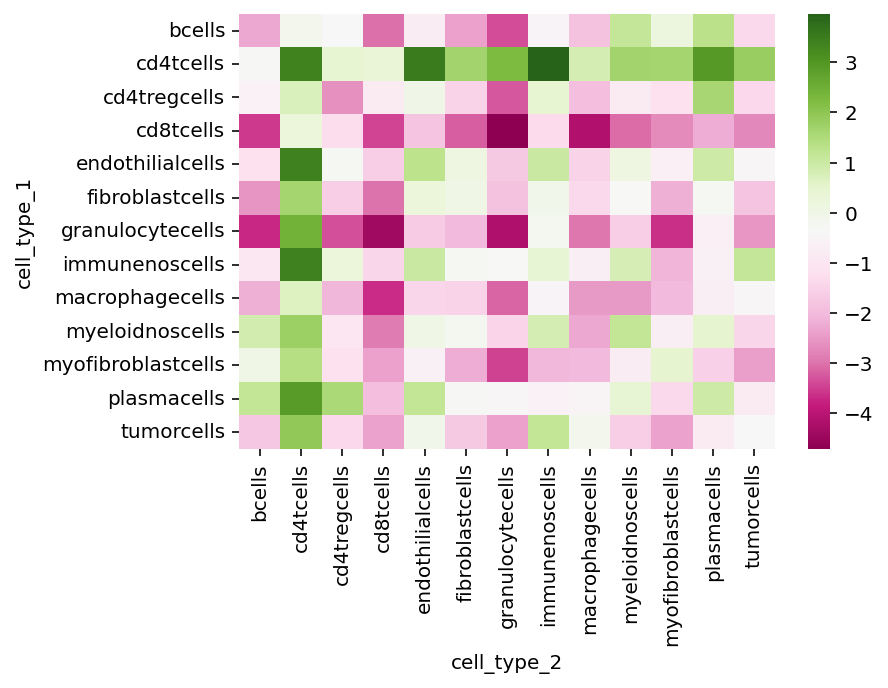

In [72]:
sns.heatmap(pivot_df, cmap='PiYG')
plt.savefig('GCross_logFC_tumour.svg')

### SJD

In [121]:
X_raw.loc[:,X_raw.columns.str.contains('MetaG')]

,MetaG:Tumour_Stroma_interface_othercells_tumorcells_None_AminoAcidUptake_,MetaG:Tumour_Stroma_interface_othercells_tumorcells_None_ATPSynthesis_,MetaG:Tumour_Stroma_interface_othercells_tumorcells_None_TCACyle_,MetaG:Tumour_Stroma_interface_othercells_tumorcells_None_Glycolysis_,MetaG:Tumour_Stroma_interface_othercells_tumorcells_None_Regulatory_,MetaG:Tumour_Stroma_interface_othercells_macrophagecells_None_ATPSynthesis_,MetaG:Tumour_Stroma_interface_othercells_macrophagecells_None_TCACyle_,MetaG:Tumour_Stroma_interface_othercells_macrophagecells_None_Glycolysis_,MetaG:Tumour_Stroma_interface_othercells_macrophagecells_None_Regulatory_,MetaG:Tumour_Stroma_interface_othercells_fibroblastcells_None_ATPSynthesis_,...,MetaG:Tumour_Stroma_interface_artifactcells_tumorcells_None_Regulatory_,MetaG:Tumour_Stroma_interface_artifactcells_macrophagecells_None_ATPSynthesis_,MetaG:Tumour_Stroma_interface_artifactcells_macrophagecells_None_TCACyle_,MetaG:Tumour_Stroma_interface_artifactcells_macrophagecells_None_Glycolysis_,MetaG:Tumour_Stroma_interface_artifactcells_cd8tcells_None_ATPSynthesis_,MetaG:Tumour_Stroma_interface_artifactcells_cd8tcells_None_TCACyle_,MetaG:Tumour_Stroma_interface_artifactcells_cd8tcells_None_Glycolysis_,MetaG:Tumour_Stroma_interface_artifactcells_cd4tcells_None_ATPSynthesis_,MetaG:Tumour_Stroma_interface_artifactcells_cd4tcells_None_TCACyle_,MetaG:Tumour_Stroma_interface_artifactcells_cd4tcells_None_Glycolysis_
22193,0.000000,122.521008,122.521008,192.542017,0.000000,127.710084,124.222689,138.319328,108.214286,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
22333,81.666667,219.166667,219.166667,219.166667,219.500000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
24490,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,206.071429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28757,0.000000,195.000000,195.000000,210.394737,148.000000,61.000000,0.000000,142.500000,0.000000,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
29937,0.000000,245.833333,245.833333,250.277778,237.500000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31267,235.441176,243.409091,243.409091,243.409091,0.000000,73.863636,67.708333,89.772727,0.000000,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31565,0.000000,167.307692,167.307692,201.555944,0.000000,123.391608,69.248252,164.947552,0.000000,97.569930,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31584,86.532258,225.241935,225.241935,227.177419,178.870968,146.129032,115.806452,152.338710,0.000000,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31590,0.000000,238.050000,238.050000,240.850000,192.350000,159.800000,127.750000,164.700000,0.000000,55.100000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
32054,144.852941,155.441176,155.441176,207.794118,127.794118,11.323529,11.323529,227.794118,0.000000,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


<Axes: >

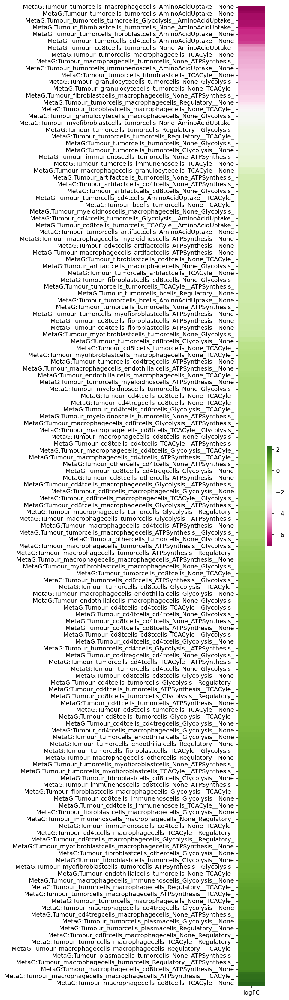

In [170]:
tempdf = X_raw.loc[:,X_raw.columns.str.contains('MetaG') & X_raw.columns.str.contains('_')  & X_raw.columns.str.contains('Tumour') & ~X_raw.columns.str.contains('face') & X_raw.columns.str.contains('_')]
tempdf = np.log2(tempdf + 1e-5)
plt.figure(figsize=(1,30))
plotdf = pd.DataFrame({"logFC": tempdf.loc[y_CB6[y_CB6 == 1.0].dropna().index,:].mean(0) - tempdf.loc[y_CB6[y_CB6 == 0.0].dropna().index,:].mean(0)})
plotdf = plotdf.sort_values(by='logFC')
sns.heatmap(plotdf[plotdf.logFC.abs() > -1.0], cmap='PiYG')

In [171]:
plotdf

,logFC
MetaG:Tumour_tumorcells_macrophagecells_AminoAcidUptake__None,-7.113788
MetaG:Tumour_tumorcells_tumorcells_AminoAcidUptake__Regulatory_,-7.077851
MetaG:Tumour_tumorcells_tumorcells_Regulatory__AminoAcidUptake_,-7.032428
MetaG:Tumour_macrophagecells_tumorcells_None_AminoAcidUptake_,-6.904547
MetaG:Tumour_tumorcells_tumorcells_AminoAcidUptake__None,-6.686828
...,...
MetaG:Tumour_macrophagecells_macrophagecells_Glycolysis__TCACyle_,2.089602
MetaG:Tumour_macrophagecells_macrophagecells_TCACyle__Glycolysis_,2.097390
MetaG:Tumour_macrophagecells_macrophagecells_TCACyle__ATPSynthesis_,2.102681
MetaG:Tumour_macrophagecells_cd8tcells_TCACyle__None,2.298131


In [172]:
# Extract the last two parts from the index by splitting the string on '_'
plotdf.index = [a.replace('MetaG:Tumour_Stroma_interface', 'interface') for a in plotdf.index.astype(str)]
plotdf['cell_type_1'] = plotdf.index.str.split('_').str[1] + plotdf.index.str.split('_').str[3]
plotdf['cell_type_2'] = plotdf.index.str.split('_').str[2] + plotdf.index.str.split('_').str[4]
plotdf = plotdf[~plotdf['cell_type_1'].isin(['othercells', 'artifactcells']) & ~plotdf['cell_type_2'].isin(['othercells', 'artifactcells'])]

In [173]:
heatmap_data = plotdf.pivot_table(index='cell_type_1', 
                              columns='cell_type_2', 
                              values='logFC', 
                              aggfunc='mean')


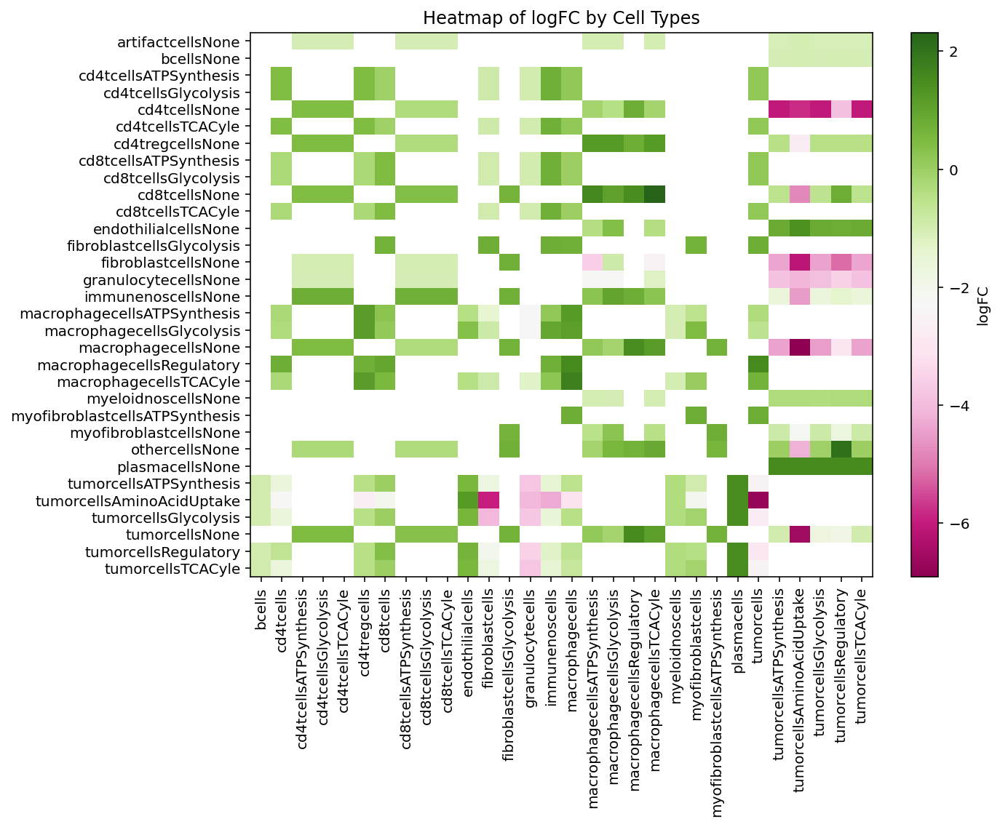

In [174]:
# Create the heatmap using matplotlib's imshow
plt.figure(figsize=(10, 8))
plt.imshow(heatmap_data, aspect='auto', cmap='PiYG')
plt.colorbar(label='logFC')

# Set the ticks and labels for both axes
plt.xticks(ticks=range(len(heatmap_data.columns)), 
           labels=heatmap_data.columns, 
           rotation=90)
plt.yticks(ticks=range(len(heatmap_data.index)), 
           labels=heatmap_data.index)

plt.title('Heatmap of logFC by Cell Types')
plt.tight_layout()
plt.savefig('MetaG_logFC_tumour.svg')